# Pululagua Inversion Examples



In [7]:
%matplotlib inline
from utils import *
import io_utils as io
import vis_utils as vis
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import pandas as pd
from scipy.stats import beta, expon, truncnorm, norm, uniform
from scipy.sparse.linalg import lsqr
from scipy.optimize import minimize
from time import process_time
from functools import reduce
from utils import *
from pandas import ExcelWriter
from pandas import ExcelFile
import xlrd
import re
pd.options.display.float_format = '{:,g}'.format
plt.style.use(['ggplot'])

In [8]:
filename = "./data/pululagua/pulu_real_data.csv"

raw_df, grid = io.import_pululagua(filename)

grid.to_csv("data/pululagua/pulu_grid.csv", sep=" ", header=False, index=False)

display(raw_df)

,Sample,Easting,Northing,Altitude,Thickness,MassArea,"[-8,-7)","[-7,-6)","[-6,-5)","[-5,-4)",...,"[6,7)","[7,8)","[8,9)","[9,10)","[10,11)",total,Md(phi),Sorting,SkG,radius
5,PL12,4105,1558,2358,16.5,165,0,0,8.883,12.031,...,0.1992,0.0791,0.0167,0.0032,0.0003,100,-1.67,2.68,-0.02,"4,390.72"
24,PL40,1032,-4703,2599,28,280,8.3376,14.9262,17.4488,11.5976,...,0.1037,0.0352,0.0085,0.0018,0.0001,100,-4.2,2.96,0.23,"4,814.9"
25,PL41,1018,-4731,2615,35,350,14.8198,5.6495,21.5207,11.558,...,0.1218,0.0388,0.0078,0.0015,0.0001,100,-4.31,2.73,0.09,"4,839.29"
4,PL11,5068,-1933,2738,17,170,0,0,5.2455,11.5143,...,0.0918,0.0386,0.0083,0.0016,0.0002,99.9999,-1.63,2.45,0.01,"5,424.12"
6,PL13,5463,3958,1934,14,140,0,0,2.8661,8.5053,...,0.3046,0.1448,0.0334,0.0066,0.0004,100,-0.5,2.42,-0.2,"6,746.12"
26,PL43,3116,-6859,2456,18,180,0,11.3857,11.0999,11.1971,...,0.0896,0.0328,0.0073,0.0011,0.0001,100,-2.71,2.95,0.03,"7,533.61"
3,PL10,5562,-5274,2361,17.5,175,0,0,3.4276,14.4473,...,0.0657,0.0238,0.0056,0.0012,0.0001,100,-1.96,2.4,0.09,"7,664.91"
2,PL07,-5132,-5822,2760,23.5,235,0,7.0853,10.7979,10.5995,...,0.1328,0.0509,0.0127,0.0025,0.0001,100,-2.37,2.87,0.02,"7,761"
38,PL57,-6347,-4763,2625,30,300,0,0,2.9079,7.9271,...,0.0831,0.0286,0.0063,0.0012,0.0001,100,-1.33,2.26,-0.01,"7,935.4"
32,PL51,-7324,-4067,2695,26,260,0,0,3.7711,6.212,...,0.1446,0.0536,0.0128,0.0028,0.0002,100,-1.7,2.23,0.12,"8,377.44"


## Preprossessing Steps

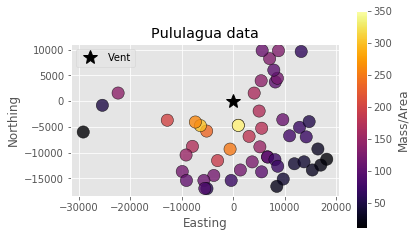

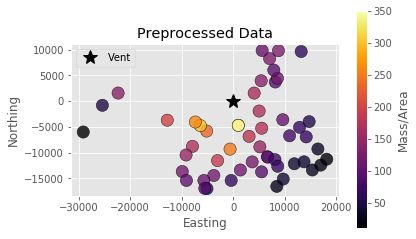

In [9]:
vis.plot_sample(raw_df, vent=(0,0), log=False, title="Pululagua data", cbar_label="Mass/Area")
plt.show()
# plt.savefig("pululagua/all_points.png", dpi=200, format='png')

obs_df = raw_df.copy()

# obs_df = obs_df.drop([36, 35, 34])
#This is going to be 100 across. Just needs to be the same as the other dfs. 
obs_df["Residual"] = obs_df["MassArea"]/obs_df["MassArea"]

vis.plot_sample(obs_df, vent=(0,0), log=False, title="Preprocessed Data", cbar_label="Mass/Area")
# plt.savefig("pululagua/All_trans.png", dpi=200, format='png')
plt.show()

In [10]:
# t2_df, _, _, _ = io.read_tephra2("data/pululagua/pulu_out.txt")

# t2_df["Residual"] = t2_df["MassArea"].values/obs_df["MassArea"].values

# display(t2_df.head())

In [11]:
# vis.plot_sample(t2_df, vent=(0,0), log=False, title="Pululagua data", cbar_label="Mass/Area")
# plt.show()

In [12]:
config = io.read_tephra2_config("data/pululagua/pulu_config.txt")

globs = {
    "LITHIC_DIAMETER_THRESHOLD": 7.,
    "PUMICE_DIAMETER_THRESHOLD": -1.,
    "AIR_VISCOSITY": 0.000018325,
    "AIR_DENSITY":  1.293,
    "GRAVITY": 9.81,
}

# Update parameters
config["COL_STEPS"] = 20
config["PART_STEPS"] = 19

config["MAX_GRAINSIZE"] = -8
config["MIN_GRAINSIZE"] = 11

config["MEDIAN_GRAINSIZE"] = -0.8

# Additional parameter: Constant wind speed
config["WIND_SPEED"] = 0.1

print("INPUT PARAMETERS:")
display(config)
display(globs)

INPUT PARAMETERS:


{'VENT_EASTING': 0.0,
 'VENT_NORTHING': 0.0,
 'VENT_ELEVATION': 2500.0,
 'PLUME_HEIGHT': 27000.0,
 'ALPHA': 1.1,
 'BETA': 1.1,
 'ERUPTION_MASS': 250000000000.0,
 'MAX_GRAINSIZE': -8,
 'MIN_GRAINSIZE': 11,
 'MEDIAN_GRAINSIZE': -0.8,
 'STD_GRAINSIZE': 2.0,
 'EDDY_CONST': 0.04,
 'DIFFUSION_COEFFICIENT': 92066.0,
 'FALL_TIME_THRESHOLD': 3600.0,
 'LITHIC_DENSITY': 2700.0,
 'PUMICE_DENSITY': 1024.0,
 'COL_STEPS': 20,
 'PART_STEPS': 19,
 'PLUME_MODEL': 2.0,
 'WIND_SPEED': 0.1}

{'LITHIC_DIAMETER_THRESHOLD': 7.0,
 'PUMICE_DIAMETER_THRESHOLD': -1.0,
 'AIR_VISCOSITY': 1.8325e-05,
 'AIR_DENSITY': 1.293,
 'GRAVITY': 9.81}

,centroid,density,interval,lower,probability,upper
0,-7.5,"1,024","[-8,-7)",-8,0.000305951,-7
1,-6.5,"1,024","[-7,-6)",-7,0.00163341,-6
2,-5.5,"1,024","[-6,-5)",-6,0.00679149,-5
3,-4.5,"1,024","[-5,-4)",-5,0.0219918,-4
4,-3.5,"1,024","[-4,-3)",-4,0.0554604,-3
5,-2.5,"1,024","[-3,-2)",-3,0.108926,-2
6,-1.5,"1,024","[-2,-1)",-2,0.166612,-1
7,-0.5,"1,024","[-1,0)",-1,0.198476,0
8,0.5,"1,233.5","[0,1)",0,0.184135,1
9,1.5,"1,443","[1,2)",1,0.133043,2


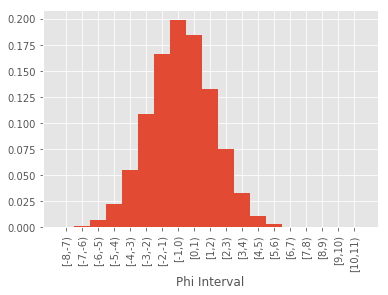

In [13]:
phi_steps = get_phi_steps(config["MIN_GRAINSIZE"], config["MAX_GRAINSIZE"], 
                          config["PART_STEPS"], 
                          config["MEDIAN_GRAINSIZE"], config["STD_GRAINSIZE"],
                          globs["LITHIC_DIAMETER_THRESHOLD"], 
                          globs["PUMICE_DIAMETER_THRESHOLD"], 
                          config["LITHIC_DENSITY"], config["PUMICE_DENSITY"])
step_width = (config["MAX_GRAINSIZE"] - config["MIN_GRAINSIZE"])/config["PART_STEPS"]

display(pd.DataFrame(phi_steps))



probs = [phi["probability"] for phi in phi_steps]
x = [phi["centroid"] for phi in phi_steps]
labels = [phi["interval"] for phi in phi_steps]
fig, ax = plt.subplots(facecolor='w', edgecolor='k')
ax.bar(x, probs, width=1, align="center")
ax.set_xticks(x)
ax.set_xticklabels(labels, rotation=90)
plt.xlabel("Phi Interval")
plt.show()

[1.19010416e-02 1.83566454e-02 6.12824444e-02 7.92135796e-02
 1.01401386e-01 1.24049846e-01 1.31519598e-01 1.40312068e-01
 1.58396497e-01 1.15608996e-01 3.96865742e-02 5.99603819e-03
 4.35966076e-03 5.00130951e-03 1.95510529e-03 7.56356040e-04
 1.68481019e-04 3.20799062e-05 2.29272160e-06]
[-7.5, -6.5, -5.5, -4.5, -3.5, -2.5, -1.5, -0.5, 0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, 9.5, 10.5]


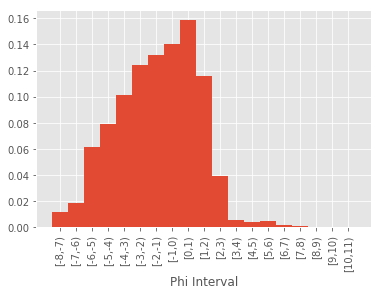

In [14]:
tgsd = get_tgsd(obs_df, phi_steps)
print(tgsd)
print(x)
fig, ax = plt.subplots(facecolor='w', edgecolor='k')
ax.bar(x, tgsd, width=1, align="center")
ax.set_xticks(x)
ax.set_xticklabels(labels, rotation=90)
plt.xlabel("Phi Interval")
plt.show()



In [15]:
drops = [0,1,2,3, 12,13,14,15,16,17,18]
drop_labs = []
for i in drops:
    drop_labs += [phi_steps[i]["interval"]]
    
display(drop_labs)

obs_df = obs_df.drop(drop_labs, 1)
display(obs_df)

config["MAX_GRAINSIZE"] = -4
config["MIN_GRAINSIZE"] = 4
config["PART_STEPS"] = 8

['[-8,-7)',
 '[-7,-6)',
 '[-6,-5)',
 '[-5,-4)',
 '[4,5)',
 '[5,6)',
 '[6,7)',
 '[7,8)',
 '[8,9)',
 '[9,10)',
 '[10,11)']

,Sample,Easting,Northing,Altitude,Thickness,MassArea,"[-4,-3)","[-3,-2)","[-2,-1)","[-1,0)","[0,1)","[1,2)","[2,3)","[3,4)",total,Md(phi),Sorting,SkG,radius,Residual
5,PL12,4105,1558,2358,16.5,165,12.3039,12.404,13.284,12.4133,13.3175,9.7525,3.6356,0.5776,100,-1.67,2.68,-0.02,"4,390.72",1
24,PL40,1032,-4703,2599,28,280,10.2719,11.3209,7.4489,6.1315,6.3778,3.5975,1.3041,0.4437,100,-4.2,2.96,0.23,"4,814.9",1
25,PL41,1018,-4731,2615,35,350,9.4431,15.7112,7.9875,5.6333,3.8866,1.9451,0.6555,0.3356,100,-4.31,2.73,0.09,"4,839.29",1
4,PL11,5068,-1933,2738,17,170,13.7305,14.5213,13.6366,12.9039,15.0825,9.6498,2.8943,0.2635,99.9999,-1.63,2.45,0.01,"5,424.12",1
6,PL13,5463,3958,1934,14,140,7.6263,10.7401,12.9359,14.7791,19.7586,15.5161,4.8884,0.6508,100,-0.5,2.42,-0.2,"6,746.12",1
26,PL43,3116,-6859,2456,18,180,12.9011,11.9098,12.58,9.8488,9.7163,6.4795,1.8938,0.3433,100,-2.71,2.95,0.03,"7,533.61",1
3,PL10,5562,-5274,2361,17.5,175,14.9461,16.5799,13.8799,12.0905,12.8785,8.3009,2.724,0.3546,100,-1.96,2.4,0.09,"7,664.91",1
2,PL07,-5132,-5822,2760,23.5,235,13.3821,12.9371,11.8958,10.9171,11.4488,7.3134,2.3407,0.5583,100,-2.37,2.87,0.02,"7,761",1
38,PL57,-6347,-4763,2625,30,300,13.5307,15.134,15.7329,14.8258,15.5904,10.2367,3.0046,0.4683,100,-1.33,2.26,-0.01,"7,935.4",1
32,PL51,-7324,-4067,2695,26,260,17.6402,17.3274,16.5737,13.557,11.0358,9.1769,3.2603,0.544,100,-1.7,2.23,0.12,"8,377.44",1


In [16]:
obs_df

,Sample,Easting,Northing,Altitude,Thickness,MassArea,"[-4,-3)","[-3,-2)","[-2,-1)","[-1,0)","[0,1)","[1,2)","[2,3)","[3,4)",total,Md(phi),Sorting,SkG,radius,Residual
5,PL12,4105,1558,2358,16.5,165,12.3039,12.404,13.284,12.4133,13.3175,9.7525,3.6356,0.5776,100,-1.67,2.68,-0.02,"4,390.72",1
24,PL40,1032,-4703,2599,28,280,10.2719,11.3209,7.4489,6.1315,6.3778,3.5975,1.3041,0.4437,100,-4.2,2.96,0.23,"4,814.9",1
25,PL41,1018,-4731,2615,35,350,9.4431,15.7112,7.9875,5.6333,3.8866,1.9451,0.6555,0.3356,100,-4.31,2.73,0.09,"4,839.29",1
4,PL11,5068,-1933,2738,17,170,13.7305,14.5213,13.6366,12.9039,15.0825,9.6498,2.8943,0.2635,99.9999,-1.63,2.45,0.01,"5,424.12",1
6,PL13,5463,3958,1934,14,140,7.6263,10.7401,12.9359,14.7791,19.7586,15.5161,4.8884,0.6508,100,-0.5,2.42,-0.2,"6,746.12",1
26,PL43,3116,-6859,2456,18,180,12.9011,11.9098,12.58,9.8488,9.7163,6.4795,1.8938,0.3433,100,-2.71,2.95,0.03,"7,533.61",1
3,PL10,5562,-5274,2361,17.5,175,14.9461,16.5799,13.8799,12.0905,12.8785,8.3009,2.724,0.3546,100,-1.96,2.4,0.09,"7,664.91",1
2,PL07,-5132,-5822,2760,23.5,235,13.3821,12.9371,11.8958,10.9171,11.4488,7.3134,2.3407,0.5583,100,-2.37,2.87,0.02,"7,761",1
38,PL57,-6347,-4763,2625,30,300,13.5307,15.134,15.7329,14.8258,15.5904,10.2367,3.0046,0.4683,100,-1.33,2.26,-0.01,"7,935.4",1
32,PL51,-7324,-4067,2695,26,260,17.6402,17.3274,16.5737,13.557,11.0358,9.1769,3.2603,0.544,100,-1.7,2.23,0.12,"8,377.44",1


,centroid,density,interval,lower,probability,upper
0,-3.5,"1,024","[-4,-3)",-4,0.0554604,-3
1,-2.5,"1,024","[-3,-2)",-3,0.108926,-2
2,-1.5,"1,024","[-2,-1)",-2,0.166612,-1
3,-0.5,"1,024","[-1,0)",-1,0.198476,0
4,0.5,"1,233.5","[0,1)",0,0.184135,1
5,1.5,"1,443","[1,2)",1,0.133043,2
6,2.5,"1,652.5","[2,3)",2,0.0748637,3
7,3.5,"1,862","[3,4)",3,0.0328079,4


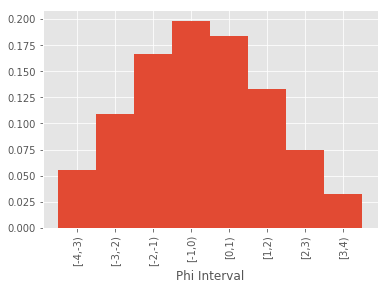

In [17]:
phi_steps = get_phi_steps(config["MIN_GRAINSIZE"], config["MAX_GRAINSIZE"], 
                          config["PART_STEPS"], 
                          config["MEDIAN_GRAINSIZE"], config["STD_GRAINSIZE"],
                          globs["LITHIC_DIAMETER_THRESHOLD"], 
                          globs["PUMICE_DIAMETER_THRESHOLD"], 
                          config["LITHIC_DENSITY"], config["PUMICE_DENSITY"])
step_width = (config["MAX_GRAINSIZE"] - config["MIN_GRAINSIZE"])/config["PART_STEPS"]

display(pd.DataFrame(phi_steps))



probs = [phi["probability"] for phi in phi_steps]
x = [phi["centroid"] for phi in phi_steps]
labels = [phi["interval"] for phi in phi_steps]
fig, ax = plt.subplots(facecolor='w', edgecolor='k')
ax.bar(x, probs, width=1, align="center")
ax.set_xticks(x)
ax.set_xticklabels(labels, rotation=90)
plt.xlabel("Phi Interval")
plt.show()

[0.12411871 0.15184119 0.16098441 0.17174669 0.19388264 0.1415093
 0.0485777  0.00733935]
[-3.5, -2.5, -1.5, -0.5, 0.5, 1.5, 2.5, 3.5]


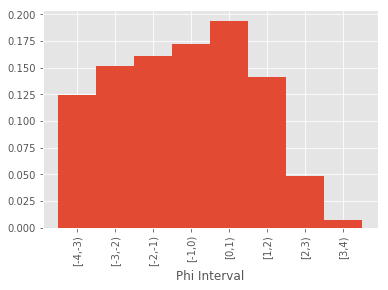

[{'lower': -4, 'upper': -3.0, 'interval': '[-4,-3)', 'centroid': -3.5, 'density': 1024.0, 'probability': 0.12411870832930293}, {'lower': -3.0, 'upper': -2.0, 'interval': '[-3,-2)', 'centroid': -2.5, 'density': 1024.0, 'probability': 0.1518411860595205}, {'lower': -2.0, 'upper': -1.0, 'interval': '[-2,-1)', 'centroid': -1.5, 'density': 1024.0, 'probability': 0.16098441368174046}, {'lower': -1.0, 'upper': 0.0, 'interval': '[-1,0)', 'centroid': -0.5, 'density': 1024.0, 'probability': 0.17174669313740235}, {'lower': 0.0, 'upper': 1.0, 'interval': '[0,1)', 'centroid': 0.5, 'density': 1233.5, 'probability': 0.19388264235314318}, {'lower': 1.0, 'upper': 2.0, 'interval': '[1,2)', 'centroid': 1.5, 'density': 1443.0, 'probability': 0.14150930164121073}, {'lower': 2.0, 'upper': 3.0, 'interval': '[2,3)', 'centroid': 2.5, 'density': 1652.5, 'probability': 0.04857770228640352}, {'lower': 3.0, 'upper': 4.0, 'interval': '[3,4)', 'centroid': 3.5, 'density': 1862.0, 'probability': 0.007339352511276332}]

In [18]:
tgsd = get_tgsd(obs_df, phi_steps)
print(tgsd)
print(x)
fig, ax = plt.subplots(facecolor='w', edgecolor='k')
ax.bar(x, tgsd, width=1, align="center")
ax.set_xticks(x)
ax.set_xticklabels(labels, rotation=90)
plt.xlabel("Phi Interval")
plt.show()

for i, phi in enumerate(phi_steps):
    phi["probability"] = tgsd[i]
print(phi_steps)

In [19]:
phi_totals = obs_df[labels].sum(axis=1)

display(phi_totals)

for phi in labels:
    obs_df[phi] = (obs_df[phi]/phi_totals)*100
                   
display(obs_df[labels].sum(axis=1))

5    77.6884
24   46.8963
25   45.5979
4    82.6824
6    86.8953
26   65.6726
3    81.7544
2    70.7933
38   88.5234
32   89.1153
8    97.2891
39   70.2684
9    91.8951
7     98.236
1    87.4604
10   80.3758
49   94.0968
51   94.0785
44   77.7225
48   79.3714
23   84.5587
22   88.9729
21   88.7546
11   95.0558
50   95.6785
33   70.7272
37   79.2753
31   92.6036
43   89.2063
20    84.926
18   87.0552
47   85.5317
30    93.173
19   81.7877
0    86.7776
17   97.6809
52     98.03
46   88.6813
45   89.2871
13   96.2784
40   92.8338
41   93.6746
42   92.3621
28   92.9235
29   92.0342
27   94.8199
16   96.1783
14    95.485
12   91.7821
15   95.1856
34   99.0895
35   98.0909
36   87.4319
dtype: float64

5    100
24   100
25   100
4    100
6    100
26   100
3    100
2    100
38   100
32   100
8    100
39   100
9    100
7    100
1    100
10   100
49   100
51   100
44   100
48   100
23   100
22   100
21   100
11   100
50   100
33   100
37   100
31   100
43   100
20   100
18   100
47   100
30   100
19   100
0    100
17   100
52   100
46   100
45   100
13   100
40   100
41   100
42   100
28   100
29   100
27   100
16   100
14   100
12   100
15   100
34   100
35   100
36   100
dtype: float64

In [20]:
t = process_time()
t_tot = process_time()
df_list = []

q_dist = beta(config["ALPHA"],config["BETA"])

grid = obs_df[["Easting", "Northing"]]
wind_angle = np.radians(200)

u = config["WIND_SPEED"]*np.cos(wind_angle)
v = config["WIND_SPEED"]*np.sin(wind_angle)
for phi_step in phi_steps:
    mass_in_phi = config["ERUPTION_MASS"] * phi_step["probability"]
    input_table, gsm_df, sig, vv, tft= gaussian_stack_single_phi(
        grid, 20, config["VENT_ELEVATION"], 
        config["PLUME_HEIGHT"], 
        (config["ALPHA"], config["BETA"]),
        mass_in_phi, (u,v), 
        phi_step["lower"], phi_step["density"], 0,
        config["DIFFUSION_COEFFICIENT"],
        config["EDDY_CONST"],
        config["FALL_TIME_THRESHOLD"])
    df_list.append(gsm_df.rename(columns={"MassArea":phi_step["interval"]}))


elapsed_time = process_time() - t
print("Forward Sim time: %.5f seconds"%elapsed_time)

t = process_time()
df_merge = reduce(lambda x, y: pd.merge(x, y, on =['Northing', 'Easting']), df_list)
elapsed_time = process_time() - t
print("Dataframe Merge time: %.5f seconds"%elapsed_time)

t = process_time()
df_merge["MassArea"] = np.sum(df_merge[labels], 1)
elapsed_time = process_time() - t
print("Tot M/A calc time: %.5f seconds"%elapsed_time)

t = process_time()
for label in labels:
    df_merge[label] = df_merge.apply(lambda row: (row[label]/row["MassArea"])*100, axis=1) # This operation is much faster

elapsed_time = process_time() - t
print("Phi Wt perc calc time: %.5f seconds"%elapsed_time)

total_time = process_time() - t_tot
print("Total time: %.5f seconds"%total_time)

forward_df = df_merge

# forward_df["MassArea"] = forward_df["MassArea"]*(6991/9469)

forward_df["radius"] = np.sqrt(forward_df["Easting"]**2 + forward_df["Northing"]**2)
forward_df = forward_df.sort_values(by=['radius'])
forward_df["Residual"] = forward_df["MassArea"].values/obs_df["MassArea"].values
display(forward_df.head())

Forward Sim time: 0.03125 seconds
Dataframe Merge time: 0.01562 seconds
Tot M/A calc time: 0.00000 seconds
Phi Wt perc calc time: 0.01562 seconds
Total time: 0.06250 seconds


,Northing,Easting,"[-4,-3)","[-3,-2)","[-2,-1)","[-1,0)","[0,1)","[1,2)","[2,3)","[3,4)",MassArea,radius,Residual
0,1558,4105,22.7197,20.656,16.0458,12.2499,8.76918,14.6975,4.56688,0.295004,262.898,"4,390.72",1.59332
1,-4703,1032,22.3914,20.5461,16.0671,12.3253,8.86067,14.8997,4.61288,0.296836,258.69,"4,814.9",0.923893
2,-4731,1018,22.3764,20.5437,16.0716,12.3324,8.86799,14.8994,4.61169,0.296817,258.361,"4,839.29",0.738174
3,-1933,5068,22.0838,20.5599,16.2482,12.5596,9.08966,14.6557,4.50917,0.293948,248.727,"5,424.12",1.4631
4,3958,5463,21.1653,20.4298,16.5787,13.0652,9.61861,14.4566,4.39432,0.291525,227.695,"6,746.12",1.62639


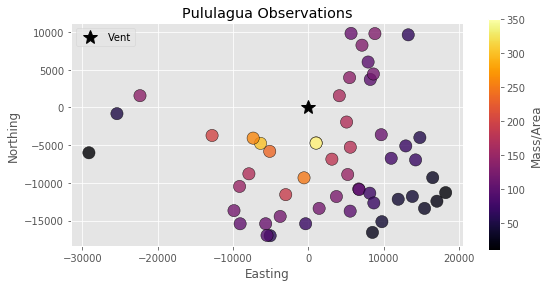

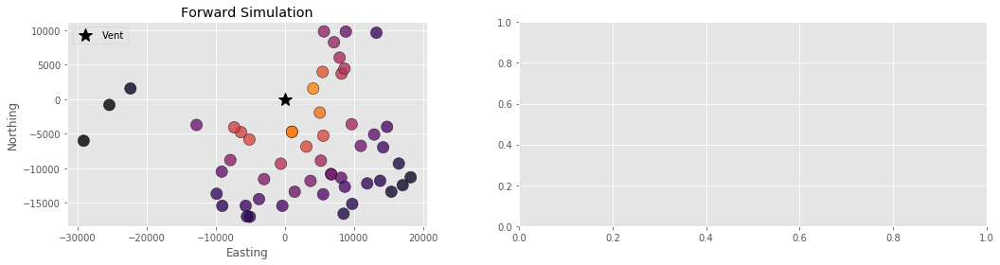

In [21]:
# fig, axs = plt.subplots(3,1, figsize=(
#         8,9), facecolor='w', edgecolor='k')
# axs = axs.ravel()

# vis.plot_sample(obs_df, vent=(0,0), log=False, 
#             title="Colima Observations", cbar_label="Mass/Area", ax=axs[0])
# vis.plot_sample(forward_df, vent=(0,0), log=False, 
#             title="Forward Simulation", cbar_label="Mass/Area", ax=axs[1])
# # vis.plot_sample(t2_const_df, vent=(0,0), log=False, 
# #             title="Tephra2 Simulation (Const. Wind)", cbar_label="Mass/Area", ax=axs[2])
# vis.plot_sample(t2_df, vent=(0,0), log=False, 
#             title="Tephra2 Simulation", cbar_label="Mass/Area", ax=axs[2])

# plt.tight_layout()
# plt.show()

# fig, axs = plt.subplots(1,2, figsize=(
#         12,3), facecolor='w', edgecolor='k')
# axs = axs.ravel()


# vis.plot_sample(forward_df, vent=(0,0), log=True, values="Residual",
#             title="Forward Simulation", 
#             cbar_label="log(Residual) (% of Obs. Mass)", ax=axs[0])
# # vis.plot_sample(t2_const_df, vent=(0,0), log=True, values="Residual",
# #             title="Tephra2 Simulation (Const. Wind)", 
# #             cbar_label="log(Residual) (% of Obs. Mass)", ax=axs[1])
# vis.plot_sample(t2_df, vent=(0,0), log=True, values="Residual",
#             title="Tephra2 Simulation", 
#             cbar_label="log(Residual) (% of Obs. Mass)", ax=axs[1])




# plt.tight_layout()
# plt.show()


bounds = (25, 350)

fig, ax = plt.subplots(1, 1, figsize=(8,4))

vis.plot_sample(obs_df, vent=(0,0), log=False, bounds=None,
            title="Pululagua Observations", cbar_label="Mass/Area", ax = ax)
plt.tight_layout()
plt.show()


fig, axs = plt.subplots(1, 2, figsize=(
        15.5,4), facecolor='w', edgecolor='k')
axs = axs.ravel()

vis.plot_sample(forward_df, vent=(0,0), log=False, bounds=bounds, show_cbar=False,
            title="Forward Simulation", cbar_label="Mass/Area", ax=axs[0])
# vis.plot_sample(t2_df, vent=(0,0), log=False, bounds=bounds, show_cbar=True,
#             title="Tephra2 Simulation", cbar_label="Mass/Area", ax=axs[1])

plt.tight_layout()
plt.show()




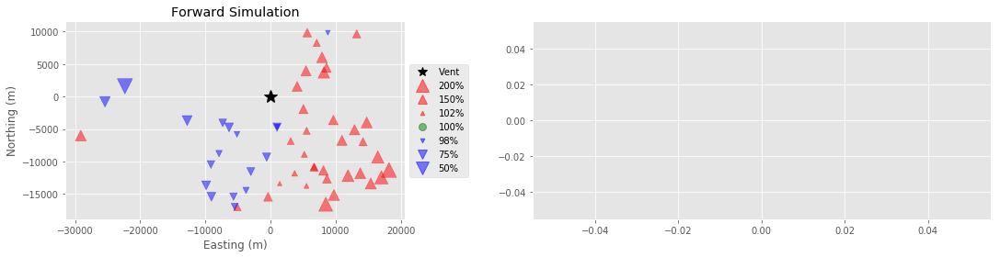

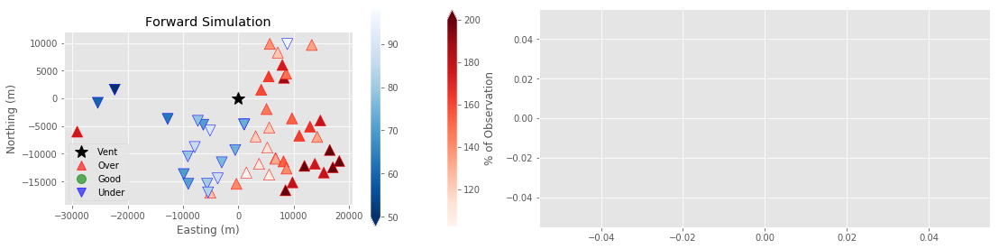

In [22]:
fig, axs = plt.subplots(1, 2, figsize=(
        15.5,4), facecolor='w', edgecolor='k')
axs = axs.ravel()


vis.plot_residuals(forward_df, vent=(0,0), values="Residual",
            title="Forward Simulation", show_legend=True,
            plot_type = "size", ax=axs[0])
# vis.plot_residuals(t2_df, vent=(0,0), values="Residual",
#             title="Tephra2 Simulation", show_legend=False,
#              plot_type = "size", ax=axs[1])


plt.tight_layout()
plt.show()

fig, axs = plt.subplots(1, 2, figsize=(
        15.5,4), facecolor='w', edgecolor='k')
axs = axs.ravel()


vis.plot_residuals(forward_df, vent=(0,0), values="Residual",
            title="Forward Simulation", 
            plot_type = "cmap", ax=axs[0], show_cbar = True)
# vis.plot_residuals(t2_df, vent=(0,0), values="Residual",
#             title="Tephra2 Simulation", 
#              plot_type = "cmap", ax=axs[1], show_cbar = False)


plt.tight_layout()
plt.show()

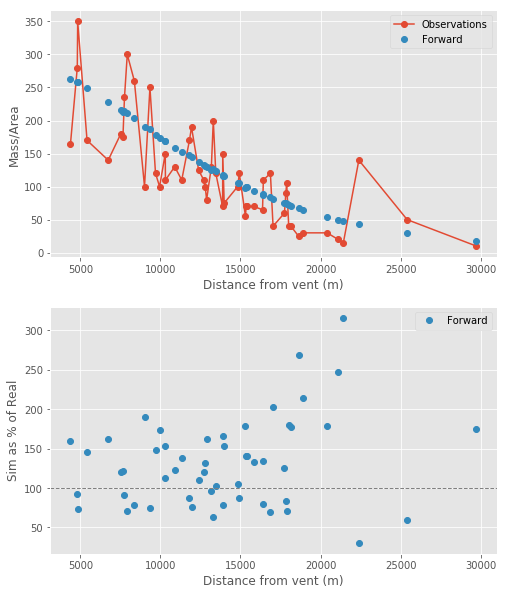

In [23]:
fig, axs = plt.subplots(2,1, figsize=(
        8,10), facecolor='w', edgecolor='k')
axs = axs.ravel()

axs[0].plot(obs_df["radius"].values, obs_df["MassArea"].values, 'C0o-', label="Observations")
# plt.plot(rotdf["radius"].values, rotdf["MassArea"].values, 'C1o-')
axs[0].plot(forward_df["radius"].values, forward_df["MassArea"].values, 'C1o', label="Forward")
# axs[0].plot(t2_df["radius"].values, t2_df["MassArea"].values, 'C2o', label="Tephra2")
axs[0].legend()
axs[0].set_xlabel("Distance from vent (m)")
axs[0].set_ylabel("Mass/Area")

axs[1].plot(forward_df["radius"].values, forward_df["Residual"].values*100, 'C1o', label="Forward")
# axs[1].plot(t2_df["radius"].values, t2_df["Residual"].values*100, 'C2o', label="Tephra2")
axs[1].axhline(100, linestyle="--", lw=1, c="gray")
axs[1].legend()
axs[1].set_xlabel("Distance from vent (m)")
axs[1].set_ylabel("Sim as % of Real")
plt.show()

In [18]:
priors_vals = {
    "a": 1.1,
    "b": 1.1,
    "h1": config["PLUME_HEIGHT"],
    "u": u,
    "v": v,
    "D": config["DIFFUSION_COEFFICIENT"],
    "ftt": config["FALL_TIME_THRESHOLD"],
    "M": config["ERUPTION_MASS"]
}

invert_params = {
    "a" : True,
    "b" : True,
    "h1" : True,
    "u": True,
    "v": True,
    "D": False,
    "ftt": False,
    "M": False
}

H = 30000

t_tot = process_time()
single_run_time = 0
wind_angle = np.radians(55.5)

names = ["Const. Wind Simulation", 
#          "T2 NOAA Wind Simulation", 
         "Observation Data"]
data_sets = [forward_df, obs_df]

inverted_masses_list = []
params_list = []
sim_params = {
    "a": config["ALPHA"],
    "b": config["BETA"],
    "h1": config["PLUME_HEIGHT"],
    "u": u,
    "v": v,
    "D": config["DIFFUSION_COEFFICIENT"],
    "ftt": config["FALL_TIME_THRESHOLD"],
    "M": config["ERUPTION_MASS"]
}
params_list += [sim_params]
for name, df in zip(names, data_sets):
    t = process_time()
    
    print("========%s========"%name)
    out = gaussian_stack_inversion(
        df, len(df), 20, config["VENT_ELEVATION"], 
        H, 2500, phi_steps,
        invert_params=invert_params,
        priors=priors_vals,
        column_cap=H)
    inversion_table, params, sol, sse, plume_trace, param_trace, sse_trace, tgsd_trace = out
    inv_mass = inversion_table["Suspended Mass"].values
    inverted_masses_list += [inv_mass]
    params_list += [params]
    display(inversion_table)
    plume_trace = np.array(plume_trace)
    param_trace = np.array(param_trace)
    print(param_trace)
    fig, axs = plt.subplots(3,3, figsize=(
            11, 9), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    axs[0].plot(plume_trace[:,0], linewidth=.8)
    axs[0].set_title("a")

    axs[1].plot(plume_trace[:,1], linewidth=.8)
    axs[1].set_title("b")

    axs[2].plot(plume_trace[:,2], linewidth=.8)
    axs[2].set_title("h1")
    
    axs[3].plot(param_trace[:,0], linewidth=.8)
    axs[3].set_title("u")

    axs[4].plot(param_trace[:,1], linewidth=.8)
    axs[4].set_title("v")
    
    axs[5].plot(param_trace[:,2], linewidth=.8)
    axs[5].set_title("Diffusion Coefficient")
    
    axs[6].plot(param_trace[:,3], linewidth=.8)
    axs[6].set_title("Fall Time Threshold")
    
    axs[7].plot(param_trace[:,4], linewidth=.8)
    axs[7].set_title("Total Mass")

    axs[8].plot(sse_trace, linewidth=.8)
    axs[8].set_title("SSE")
    
#     print(sse_trace)

    plt.tight_layout()
    # plt.savefig("colima/real_trace.png", dpi=200, format='png')
    plt.show()
    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.bar(x, tgsd_trace[0], width=1, align="center")
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    plt.xlabel("Phi Interval")
    plt.title("Before")
    plt.show()
    
    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.bar(x, tgsd_trace[-1], width=1, align="center")
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    plt.xlabel("Phi Interval")
    plt.title("After")
    plt.show()
    
    run_time = process_time() - t
    print("%s Run Time: %.5f minutes\n\n"%(name, run_time/60))


total_run_time = process_time() - t_tot

print("Total Run Time: %.5f minutes"%(total_run_time/60))

========Const. Wind Simulation========


KeyboardInterrupt: 

In [ ]:
# priors_vals = {
#     "a": 1.1,
#     "b": 1.1,
#     "h1": 25000,
#     "u": 1e-9,
#     "v": 1e-9,
#     "D": config["DIFFUSION_COEFFICIENT"],
#     "ftt": config["FALL_TIME_THRESHOLD"],
#     "M": config["ERUPTION_MASS"]
# }

# # obs_df["Easting"] = -obs_df["Easting"]
# # forward_df["Easting"] = -forward_df["Easting"]

# invert_params = {
#     "a" : True,
#     "b" : True,
#     "h1" : True,
#     "u": True,
#     "v": True,
#     "D": True,
#     "ftt": False,
#     "M": False
# }



# H = 40000

# wind_angle = np.radians(200)

# u = -config["WIND_SPEED"]*np.cos(wind_angle)
# v = config["WIND_SPEED"]*np.sin(wind_angle)
# # names = ["Forward Simulation", "T2 Simulation", "Observation Data"]
# names = ["Observation Data", "Forward Simulation"]

# # data_sets = [forward_df, t2_df, obs_df]

# data_sets = [obs_df, forward_df]
# inverted_masses_list = []
# params_list = []
# for name, df in zip(names, data_sets):
#     print("========%s========"%name)
#     out = gaussian_stack_plume_inversion(
#         df, len(df), 20, 
#         config["VENT_ELEVATION"], H, 0,
#         phi_steps, config["EDDY_CONST"],
#         invert_params=invert_params,
#         priors = priors_vals, 
#         column_cap=H)
#     inversion_table, params, sol, sse, trace, coef_matrices, sse_trace = out
    
#     inv_mass = inversion_table["Suspended Mass"].values
#     inverted_masses_list += [inv_mass]
#     params_list += [params]
#     display(inversion_table)
#     trace = np.array(trace)
#     fig, axs = plt.subplots(2,2, figsize=(
#             11, 8), facecolor='w', edgecolor='k')
#     axs = axs.ravel()
#     axs[0].plot(trace[:,0], linewidth=.8)
#     axs[0].set_title("a")

#     axs[1].plot(trace[:,1], linewidth=.8)
#     axs[1].set_title("b")

#     axs[2].plot(trace[:,2], linewidth=.8)
#     axs[2].set_title("h1")

#     axs[3].plot(np.log(sse_trace), linewidth=.8)
#     axs[3].set_title("log(sse)")

#     plt.tight_layout()
#     plt.show()



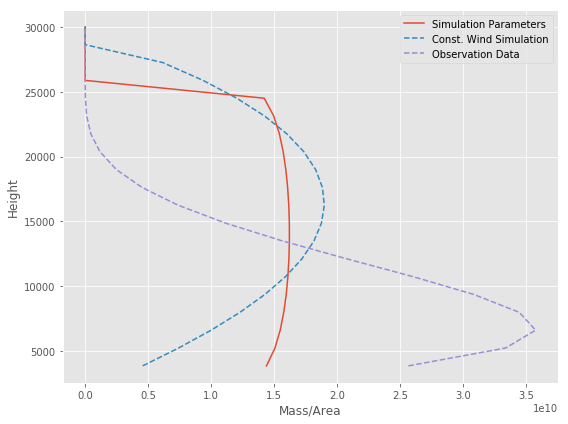

,Dataset,a,b,h1,u,v,D,ftt,M
0,Simulation Parameters,1.1,1.1,"27,000",-0.0939693,-0.034202,"92,066","3,600",2.5e+11
1,Const. Wind Simulation,2.05099,1.93119,"30,000",-0.197816,0.0676694,"92,066","3,600",2.5e+11
2,Observation Data,2,5,"27,000",-0.0939693,-0.034202,"92,066","3,600",2.5e+11


In [20]:
fig, ax1 = plt.subplots(1,1, figsize=(
    8, 6), facecolor='w', edgecolor='k')

q_dist = beta(config["ALPHA"],config["BETA"])

q_mass = beta_plume(config["ALPHA"],config["BETA"],config["PLUME_HEIGHT"],
                    config["ERUPTION_MASS"],
                    inversion_table["Height"],
                    config["VENT_ELEVATION"], 
                    H)

# q_mass = mass_dist_in_plume(config["ALPHA"],config["BETA"], config["VENT_ELEVATION"], 
#             config["PLUME_HEIGHT"],
#             inversion_table["Height"],
#             config["ERUPTION_MASS"])

ax1.plot(q_mass, inversion_table["Height"], label="Simulation Parameters")
for name, mass in zip(names, inverted_masses_list):
    ax1.plot(mass, 
         inversion_table["Height"], 
         '--', label=name)
ax1.legend()
# ax1.set_title("Mass in Column as inverted from various datasets")
ax1.set_ylabel("Height")
ax1.set_xlabel("Mass/Area")

plt.tight_layout()
plt.show()
params_df = pd.DataFrame(params_list)
params_df["Dataset"] = ["Simulation Parameters"] + names
params_df = params_df[["Dataset", "a", "b", "h1", "u", "v", "D", "ftt", "M"]]
display(params_df)

========Observation Data========


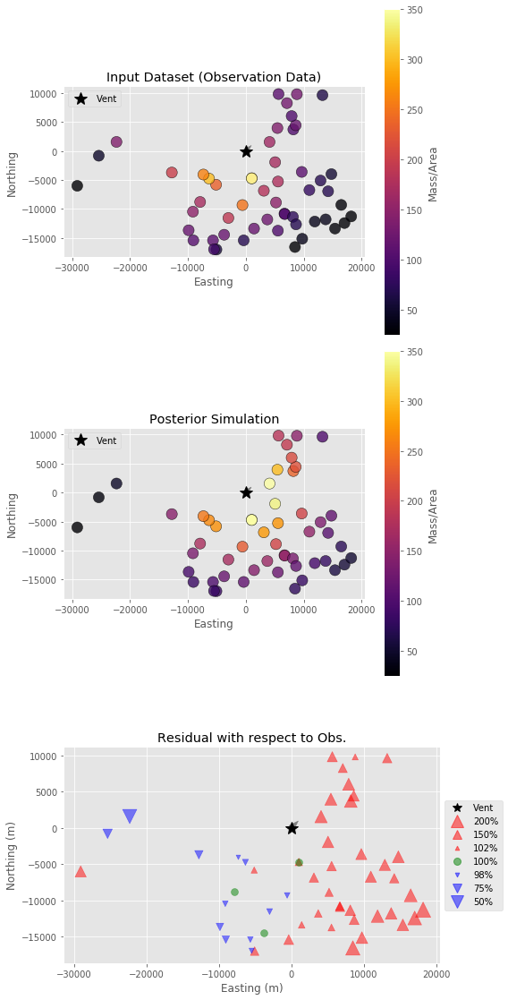

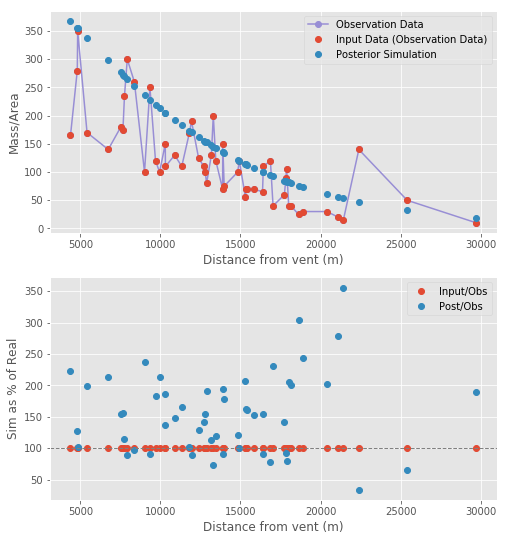

========Forward Simulation========


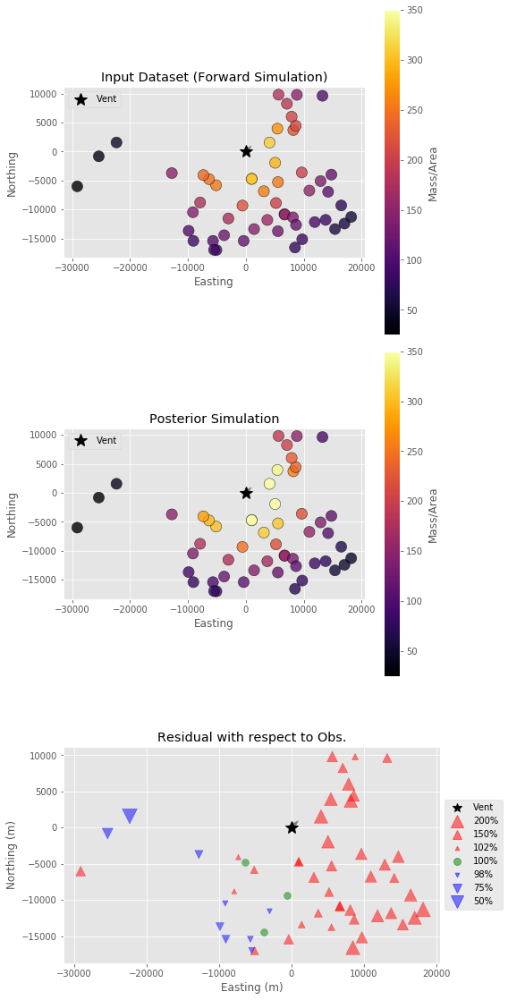

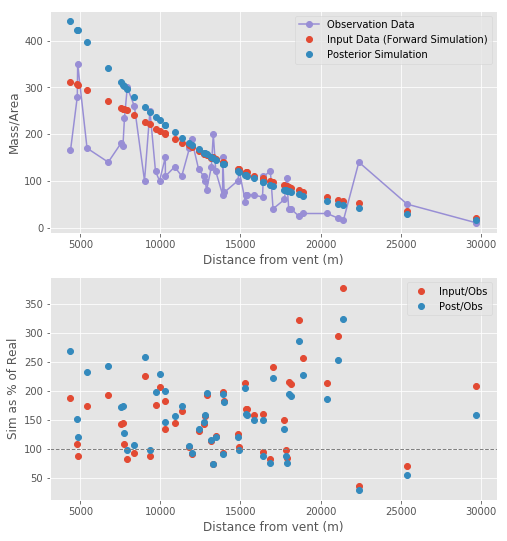

In [31]:
for name, params, mass, in_data in zip(names, params_list, inverted_masses_list, data_sets):
    print("========%s========"%name)
    q_dist = beta(params["a"],params["b"])

    grid = obs_df[["Easting", "Northing"]]

    post_df = gaussian_stack_forward(
        grid, int(config["COL_STEPS"]), config["VENT_ELEVATION"], 
        params["h1"], 2500, phi_steps, (params["a"],params["b"]), config["ERUPTION_MASS"], 
        (params["u"],params["v"]), config["DIFFUSION_COEFFICIENT"], config["EDDY_CONST"],
        config["FALL_TIME_THRESHOLD"]
    )
    
    post_df["radius"] = np.sqrt(post_df["Easting"]**2 + post_df["Northing"]**2)
    post_df = post_df.sort_values(by=['radius'])
    post_df["Residual"] = post_df["MassArea"].values/obs_df["MassArea"].values
    post_df["Change"] = post_df["MassArea"].values/in_data["MassArea"].values
    
    fig, axs = plt.subplots(3,1, figsize=(
            8, 16), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    bounds = (25, 350)
    vis.plot_sample(in_data, vent=(0,0), log=False,bounds=bounds, 
                title="Input Dataset (%s)"%name, cbar_label="Mass/Area", ax=axs[0],
                wind=(params["u"]*20,params["v"]*20))
    vis.plot_sample(post_df, vent=(0,0), log=False, bounds=bounds,
                title="Posterior Simulation", cbar_label="Mass/Area", ax=axs[1],
                wind=(params["u"]*20,params["v"]*20))
#     vis.plot_residuals(post_df, vent=(0,0), values="Change", plot_type="size",
#                 title="Change from Input Dataset", ax=axs[2])
    vis.plot_residuals(post_df, vent=(0,0), values="Residual", plot_type="size",
                title="Residual with respect to Obs.", ax=axs[2],
                wind=(params["u"]*20,params["v"]*20))

    plt.tight_layout()
    plt.show()

    
    fig, axs = plt.subplots(2,1, figsize=(
            8, 9), facecolor='w', edgecolor='k')
    axs = axs.ravel()

    axs[0].plot(obs_df["radius"].values, obs_df["MassArea"].values, 'C2o-', label="Observation Data")
    axs[0].plot(in_data["radius"].values, in_data["MassArea"].values, 'C0o', label="Input Data (%s)"%name)
    axs[0].plot(post_df["radius"].values, post_df["MassArea"].values, 'C1o', label="Posterior Simulation")
    axs[0].legend()
    axs[0].set_xlabel("Distance from vent (m)")
    axs[0].set_ylabel("Mass/Area")


    axs[1].plot(in_data["radius"].values, in_data["Residual"].values*100, 'C0o', label="Input/Obs")
    axs[1].plot(post_df["radius"].values, post_df["Residual"].values*100, 'C1o', label="Post/Obs")
    axs[1].axhline(100, linestyle="--", lw=1, c="gray")
    axs[1].legend()
    axs[1].set_xlabel("Distance from vent (m)")
    axs[1].set_ylabel("Sim as % of Real")
    plt.show()
    
   

In [15]:
# fig, axs = plt.subplots(2,1, figsize=(
#         8, 9), facecolor='w', edgecolor='k')
# axs = axs.ravel()

# axs[0].plot(obs_df["radius"].values, rotdf["MassArea"].values, 'C0-', label="Obs")
# axs[0].plot(df_merge["radius"].values, df_merge["MassArea"].values, 'C1-', label="Prior")
# axs[0].plot(post_df["radius"].values, post_df["MassArea"].values, 'C2-', label="Post")
# axs[0].plot(t2_df["radius"].values, t2_df["MassArea"].values, 'C3-', label="T2")
# axs[0].legend()
# axs[0].set_xlabel("Distance from vent (m)")
# axs[0].set_ylabel("Mass/Area")


# axs[1].plot(prior_res_obs["radius"].values, prior_res_obs["MassArea"].values, 'C1-', label="Prior/Obs")
# axs[1].plot(post_res_obs["radius"].values, post_res_obs["MassArea"].values, 'C2-', label="Post/Obs")
# axs[1].plot(t2_res_df["radius"].values, t2_res_df["MassArea"].values, 'C3-', label="T2/Obs")
# axs[1].legend()
# axs[1].set_xlabel("Distance from vent (m)")
# axs[1].set_ylabel("Residual (%)")
# plt.show()

========Forward Simulation========
a* = -2.30259	b* = -2.30259	            h1* = 0.74859	u* = 0.00307	v* = -0.11368	            D* = 11.73279	ftt* = 8.18869	TM* = 26.24473
a = 1.10000	b = 1.10000	            h1 = 28039.88627	u = 0.00307	v = -0.11368	            D = 124591.28001	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 242
SSE: 3.1778628344205395


,Height,Suspended Mass
0,"4,625",1.98579e+10
1,"6,750",2.10816e+10
2,"8,875",2.17243e+10
3,"11,000",2.20971e+10
4,"13,125",2.22968e+10
5,"15,250",2.23607e+10
6,"17,375",2.22992e+10
7,"19,500",2.21023e+10
8,"21,625",2.17333e+10
9,"23,750",2.10973e+10


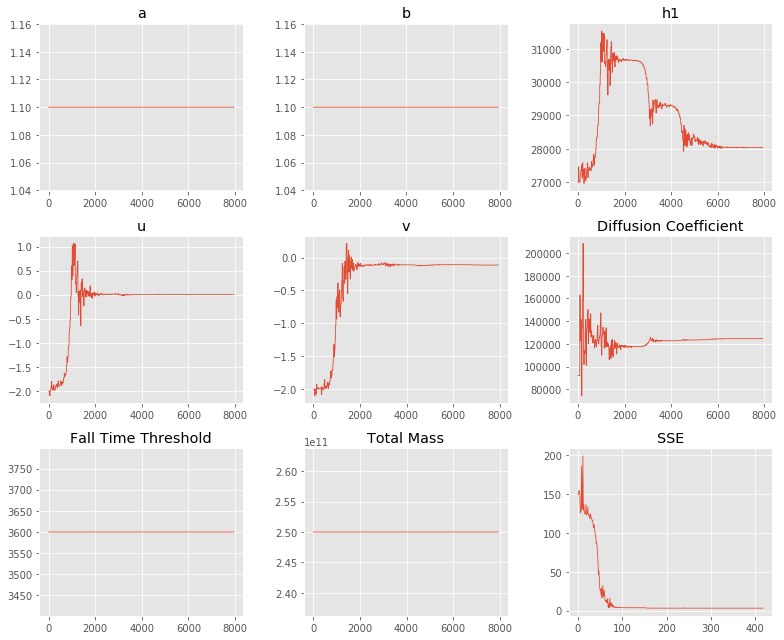

Forward Simulation Run Time: 1.91719 minutes


========T2 Simulation========
a* = -2.30259	b* = -2.30259	            h1* = 0.74558	u* = -2.29962	v* = -0.96010	            D* = 11.77867	ftt* = 8.18869	TM* = 26.24473
a = 1.10000	b = 1.10000	            h1 = 28000.00027	u = -2.29962	v = -0.96010	            D = 130440.42042	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 247
SSE: 4.438086208005491


,Height,Suspended Mass
0,"4,625",2.06375e+10
1,"6,750",2.19089e+10
2,"8,875",2.25764e+10
3,"11,000",2.29633e+10
4,"13,125",2.317e+10
5,"15,250",2.32353e+10
6,"17,375",2.317e+10
7,"19,500",2.29633e+10
8,"21,625",2.25764e+10
9,"23,750",2.19089e+10


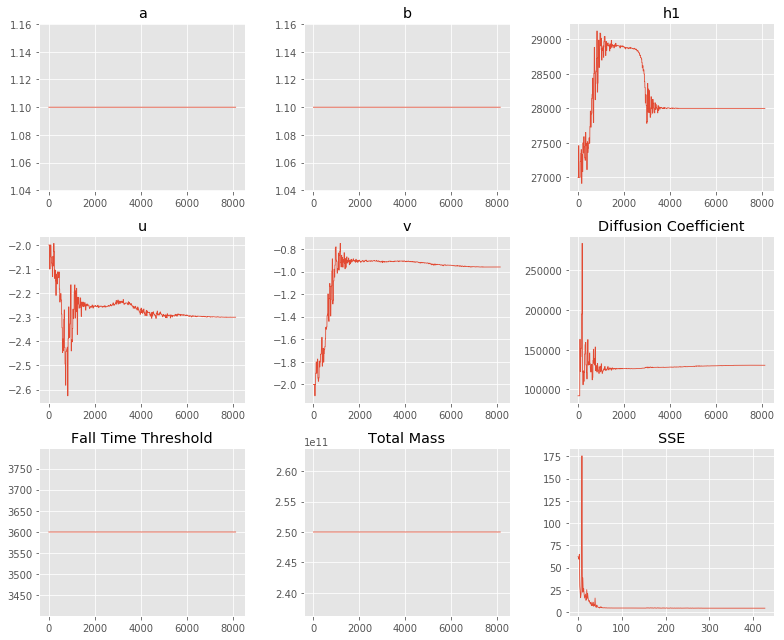

T2 Simulation Run Time: 2.22812 minutes


========Observation Data========


C:\Users\nmostert\Documents\repos\inversion_project\utils.py:431: RuntimeWarning: invalid value encountered in true_divide
  ret = (plume/sum(plume))*tot_mass


a* = -2.30259	b* = -2.30259	            h1* = -0.82206	u* = 0.00144	v* = -0.00178	            D* = 12.62022	ftt* = 8.18869	TM* = 26.24473
a = 1.10000	b = 1.10000	            h1 = 4625.00016	u = 0.00144	v = -0.00178	            D = 302616.04355	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 387
SSE: 9217928.840424143


,Height,Suspended Mass
0,"4,625",2.5e+11
1,"6,750",0
2,"8,875",0
3,"11,000",0
4,"13,125",0
5,"15,250",0
6,"17,375",0
7,"19,500",0
8,"21,625",0
9,"23,750",0


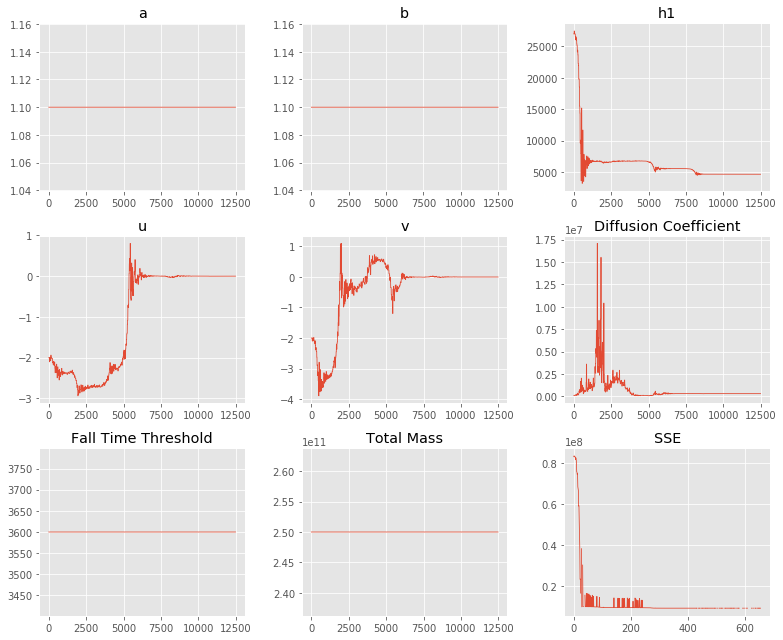

Observation Data Run Time: 3.32474 minutes


Total Run Time: 7.47031 minutes


In [17]:
priors_vals = {
    "a": 1.1,
    "b": 1.1,
    "h1": config["PLUME_HEIGHT"],
    "u": -2,
    "v": -2,
    "D": config["DIFFUSION_COEFFICIENT"],
    "ftt": config["FALL_TIME_THRESHOLD"],
    "M": config["ERUPTION_MASS"]
}

invert_params = {
    "a" : False,
    "b" : False,
    "h1" : True,
    "u": True,
    "v": True,
    "D": True,
    "ftt": False,
    "M": False
}

H = 45000

t_tot = process_time()
single_run_time = 0
wind_angle = np.radians(55.5)

names = ["Forward Simulation", 
         "T2 Simulation",
         "Observation Data"]
data_sets = [forward_df, t2_df, obs_df]

inverted_masses_list = []
params_list = []
for name, df in zip(names, data_sets):
    t = process_time()
    
    print("========%s========"%name)
    out = gaussian_stack_inversion(
        df, len(df), 20, config["VENT_ELEVATION"], 
        H, 2500, phi_steps,
        invert_params=invert_params,
        priors=priors_vals,
        column_cap=H)
    inversion_table, params, sol, sse, plume_trace, param_trace, sse_trace = out
    params_no_wind = list(params.values())
    params_no_wind = params_no_wind[:-5]
    
    inv_mass, _, _, _ = beta_transform(*plume_inv_transform(*params_no_wind, H), 
                          config["ERUPTION_MASS"], 
                          inversion_table["Height"], config["VENT_ELEVATION"], H)
    inverted_masses_list += [inv_mass]
    params_list += [params]
    display(inversion_table)
    plume_trace = np.array(plume_trace)
    param_trace = np.array(param_trace)
    fig, axs = plt.subplots(3,3, figsize=(
            11, 9), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    axs[0].plot(plume_trace[:,0], linewidth=.8)
    axs[0].set_title("a")

    axs[1].plot(plume_trace[:,1], linewidth=.8)
    axs[1].set_title("b")

    axs[2].plot(plume_trace[:,2], linewidth=.8)
    axs[2].set_title("h1")
    
    axs[3].plot(param_trace[:,0], linewidth=.8)
    axs[3].set_title("u")

    axs[4].plot(param_trace[:,1], linewidth=.8)
    axs[4].set_title("v")
    
    axs[5].plot(param_trace[:,2], linewidth=.8)
    axs[5].set_title("Diffusion Coefficient")
    
    axs[6].plot(param_trace[:,3], linewidth=.8)
    axs[6].set_title("Fall Time Threshold")
    
    axs[7].plot(param_trace[:,4], linewidth=.8)
    axs[7].set_title("Total Mass")

    axs[8].plot(sse_trace, linewidth=.8)
    axs[8].set_title("SSE")

    plt.tight_layout()
    # plt.savefig("colima/real_trace.png", dpi=200, format='png')
    plt.show()
    
    run_time = process_time() - t
    print("%s Run Time: %.5f minutes\n\n"%(name, run_time/60))


total_run_time = process_time() - t_tot

print("Total Run Time: %.5f minutes"%(total_run_time/60))

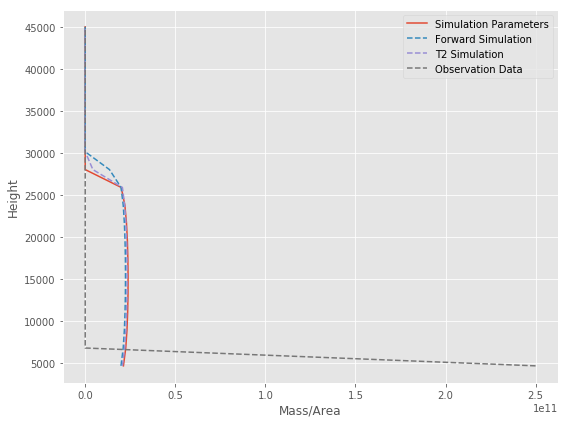

,Dataset,a,b,h1,u,v,D,ftt,M
0,Forward Simulation,1.1,1.1,"28,039.9",0.00307181,-0.113681,"124,591","3,600",2.5e+11
1,T2 Simulation,1.1,1.1,"28,000",-2.29962,-0.960097,"130,440","3,600",2.5e+11
2,Observation Data,1.1,1.1,"4,625",0.00144477,-0.00178249,"302,616","3,600",2.5e+11


In [18]:
fig, ax1 = plt.subplots(1,1, figsize=(
    8, 6), facecolor='w', edgecolor='k')

q_dist = beta(config["ALPHA"],config["BETA"])

q_mass = mass_dist_in_plume(config["ALPHA"],config["BETA"], config["VENT_ELEVATION"], 
            config["PLUME_HEIGHT"],
            inversion_table["Height"],
            config["ERUPTION_MASS"])

ax1.plot(q_mass, inversion_table["Height"], label="Simulation Parameters")
for name, mass in zip(names, inverted_masses_list):
    ax1.plot(mass, 
         inversion_table["Height"], 
         '--', label=name)
ax1.legend()
# ax1.set_title("Mass in Column as inverted from various datasets")
ax1.set_ylabel("Height")
ax1.set_xlabel("Mass/Area")

plt.tight_layout()
plt.show()

params_df = pd.DataFrame(params_list)
params_df["Dataset"] = names
params_df = params_df[["Dataset", "a", "b", "h1", "u", "v", "D", "ftt", "M"]]
display(params_df)

========Forward Simulation========


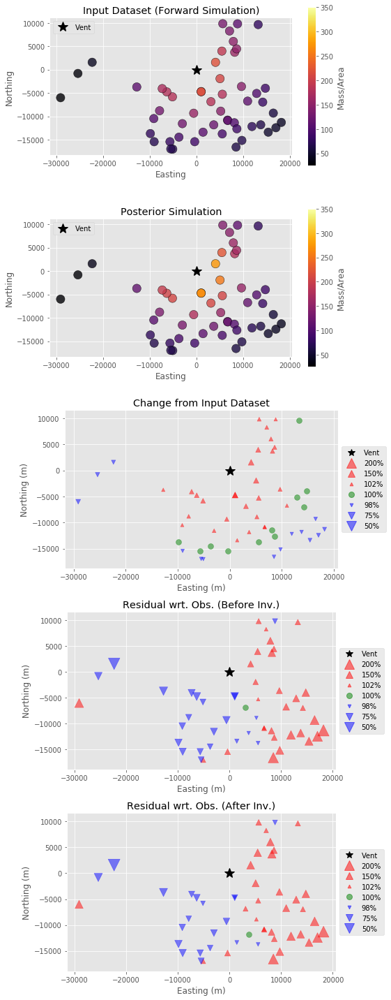

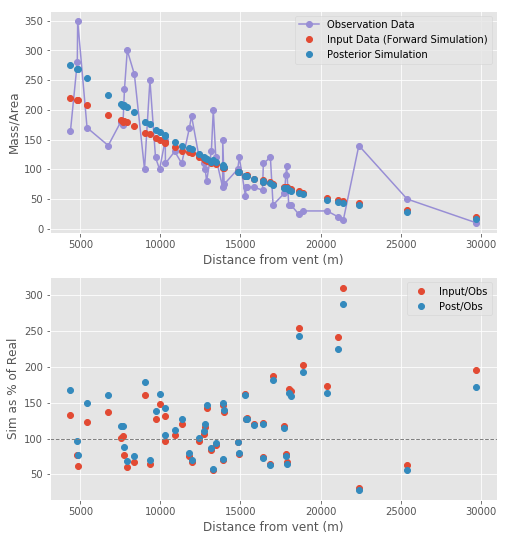

========T2 Simulation========


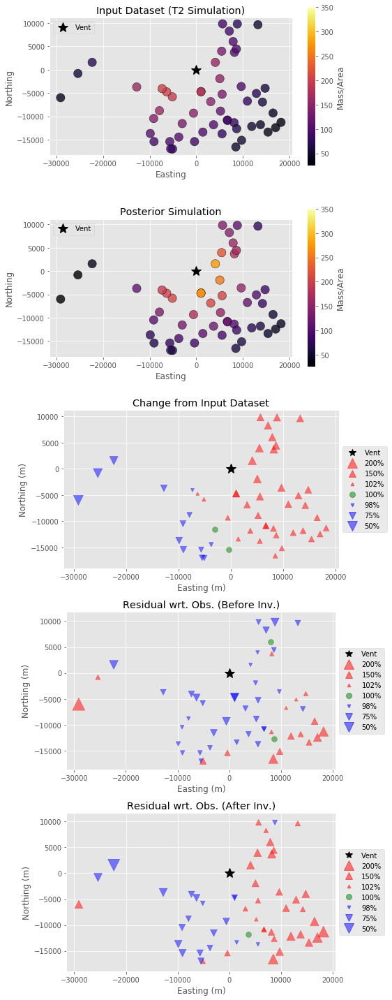

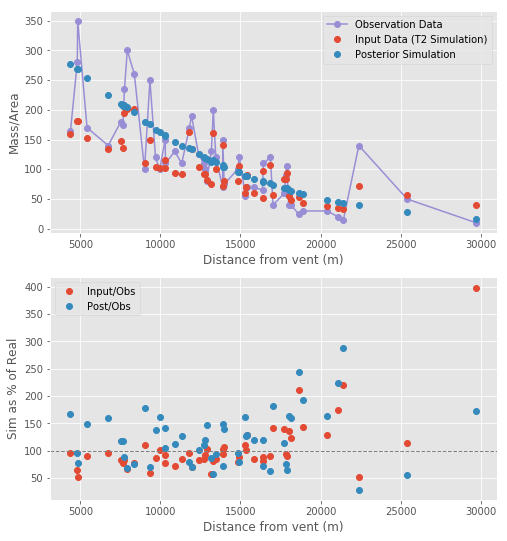

========Observation Data========


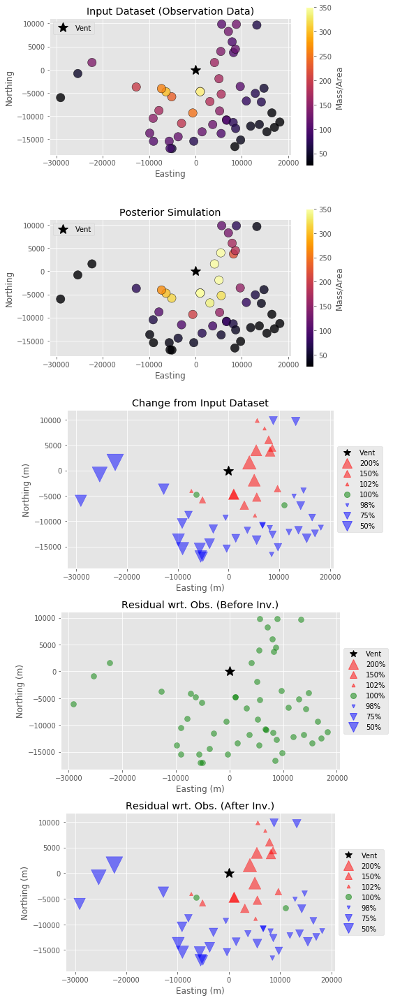

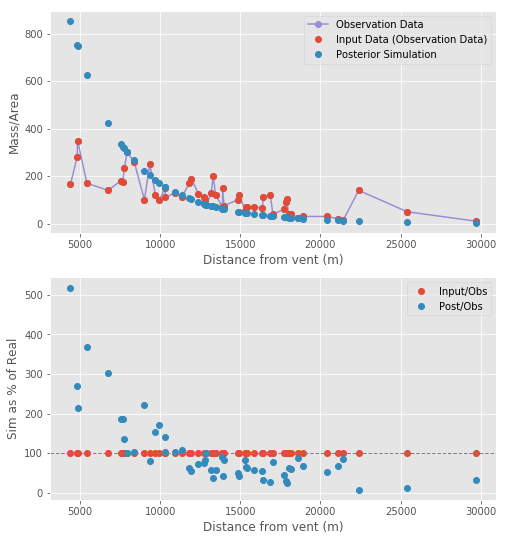

In [19]:
for name, params, mass, in_data in zip(names, params_list, inverted_masses_list, data_sets):
    print("========%s========"%name)
    q_dist = beta(params["a"],params["b"])

    grid = obs_df[["Easting", "Northing"]]

    post_df = gaussian_stack_forward(
        grid, int(config["COL_STEPS"]), config["VENT_ELEVATION"], 
        params["h1"], 2500, phi_steps, (params["a"],params["b"]), config["ERUPTION_MASS"], 
        (u,v), config["DIFFUSION_COEFFICIENT"], config["EDDY_CONST"],
        config["FALL_TIME_THRESHOLD"]
    )
    
    post_df["radius"] = np.sqrt(post_df["Easting"]**2 + post_df["Northing"]**2)
    post_df = post_df.sort_values(by=['radius'])
    post_df["Residual"] = post_df["MassArea"].values/obs_df["MassArea"].values
    post_df["Change"] = post_df["MassArea"].values/in_data["MassArea"].values
    
    fig, axs = plt.subplots(5,1, figsize=(
            8, 20), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    bounds = (25, 350)
    vis.plot_sample(in_data, vent=(0,0), log=False,bounds=bounds, 
                title="Input Dataset (%s)"%name, cbar_label="Mass/Area", ax=axs[0])
    vis.plot_sample(post_df, vent=(0,0), log=False, bounds=bounds,
                title="Posterior Simulation", cbar_label="Mass/Area", ax=axs[1])
    vis.plot_residuals(post_df, vent=(0,0), values="Change", plot_type="size",
                title="Change from Input Dataset", ax=axs[2])
    vis.plot_residuals(in_data, vent=(0,0), values="Residual", plot_type="size",
                title="Residual wrt. Obs. (Before Inv.)", ax=axs[3])
    vis.plot_residuals(post_df, vent=(0,0), values="Residual", plot_type="size",
                title="Residual wrt. Obs. (After Inv.)", ax=axs[4])

    plt.tight_layout()
    plt.show()

    
    fig, axs = plt.subplots(2,1, figsize=(
            8, 9), facecolor='w', edgecolor='k')
    axs = axs.ravel()

    axs[0].plot(obs_df["radius"].values, obs_df["MassArea"].values, 'C2o-', label="Observation Data")
    axs[0].plot(in_data["radius"].values, in_data["MassArea"].values, 'C0o', label="Input Data (%s)"%name)
    axs[0].plot(post_df["radius"].values, post_df["MassArea"].values, 'C1o', label="Posterior Simulation")
    axs[0].legend()
    axs[0].set_xlabel("Distance from vent (m)")
    axs[0].set_ylabel("Mass/Area")


    axs[1].plot(in_data["radius"].values, in_data["Residual"].values*100, 'C0o', label="Input/Obs")
    axs[1].plot(post_df["radius"].values, post_df["Residual"].values*100, 'C1o', label="Post/Obs")
    axs[1].axhline(100, linestyle="--", lw=1, c="gray")
    axs[1].legend()
    axs[1].set_xlabel("Distance from vent (m)")
    axs[1].set_ylabel("Sim as % of Real")
    plt.show()
    
   

In [24]:
H = 30000

def col_truncnorm(mean, top=45000):
    bottom = 5000
    std = (top - bottom)/4
    standard_a, standard_b = (bottom - mean) / std, (top - mean) / std
    return truncnorm.rvs(standard_a, standard_b, loc=mean, scale=std)

def lognorm(prior, bottom=0):
    std_norm = norm.rvs()
    std_lognorm = np.exp(std_norm)
    lognorm = bottom + (prior-bottom)*std_lognorm
    return lognorm

def normal(prior):
    std_norm = norm.rvs()
    normal = prior*std_norm
    return normal

def uninformed(bottom, top):
    unif = uniform.rvs(loc = bottom, scale = (top-bottom))
    return unif


,invert,sample_function,value
a,True,<function lognorm at 0x0000019950C98950>,"[2, 1]"
b,True,<function lognorm at 0x0000019950C98950>,"[2, 1]"
h1,True,<function col_truncnorm at 0x0000019950C98D08>,"[20000, 30000]"
u,True,<function normal at 0x0000019950C98D90>,[5]
v,True,<function normal at 0x0000019950C98D90>,[6]
D,False,<function lognorm at 0x0000019950C98950>,[4000]
ftt,False,<function lognorm at 0x0000019950C98950>,[3600]
M,True,<function lognorm at 0x0000019950C98950>,[250000000000.0]


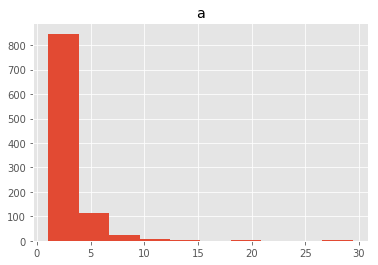

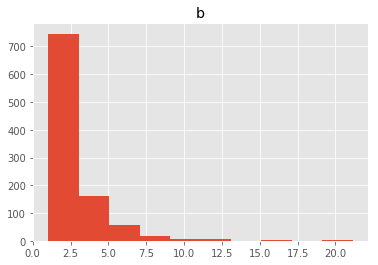

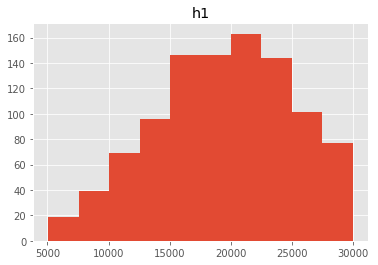

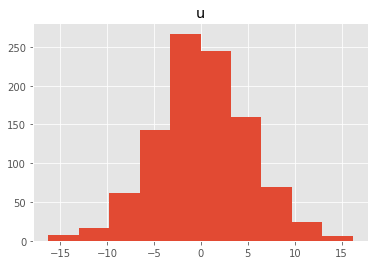

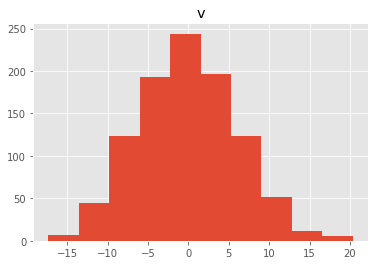

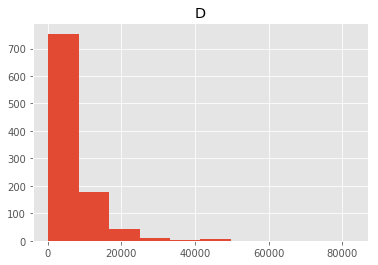

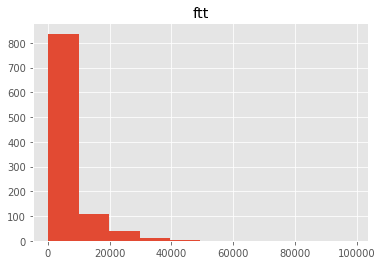

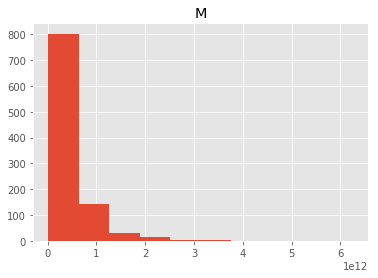

In [25]:
param_config = {
    "a": {
        "value":[2, 1],
        "invert":True,
        "sample_function": lognorm
    },
    "b": {
        "value":[2, 1],
        "invert":True,
        "sample_function": lognorm
    },
    "h1": {
        "value":[20000, H],
        "invert":True,
        "sample_function": col_truncnorm
    },
    "u": {
        "value":[5],
        "invert":True,
        "sample_function": normal
    },
    "v": {
        "value":[6],
        "invert":True,
        "sample_function": normal
    },
    "D": {
        "value":[4000],
        "invert":False,
        "sample_function": lognorm
    },
    "ftt": {
        "value":[3600],
        "invert":False,
        "sample_function": lognorm
    },
    "M": {
        "value":[config["ERUPTION_MASS"]],
        "invert":True,
        "sample_function": lognorm
    }
}
param_config_df = pd.DataFrame(param_config)
display(param_config_df.T)

for key, val in param_config.items():
    x = [val["sample_function"](*val["value"]) for i in range(1000)]
    plt.hist(x)
    plt.title(key)
    plt.show()



In [26]:
log="verb"
data = obs_df
iterations = 10

out = gaussian_stack_multi_run(
    data, len(data), 20, 
    config["VENT_ELEVATION"], 
    H, 2500, phi_steps, param_config, runs=iterations, column_cap = H, pre_samples=20
)

inverted_masses_list, sse_list, params_list, priors_list, heights, tgsd_list = out

Run 0===========================================================================
a* = 6.37936	b* = -9.93759	            h1* = 8.61347	u* = -5.57673	v* = -1.50259	            D* = 8.29405	ftt* = 8.18869	TM* = 34.16626
a = 590.54952	b = 1.00005	            h1 = 29994.55120	u = -5.57673	v = -1.50259	            D = 4000.00000	ftt = 3600.00000	TM = 689001418875484.75000
Success: True, Optimization terminated successfully.
Iterations: 607
SSE: 27464772.559743702
Prior SSE: 1.2628e+15,	 Post SSE: 2.74648e+07


,Priors,Posteriors
D,"4,000","4,000"
M,6.56665e+11,6.89001e+14
a,1.86005,590.55
b,12.8923,1.00005
ftt,"3,600","3,600"
h1,"20,393.8","29,994.6"
u,-2.67589,-5.57673
v,1.22963,-1.50259


Run 1 Time: 1.988 minutes


Estimated remaining run time: 7.953 minutes


Run 1===========================================================================


C:\Users\nmostert\Documents\repos\inversion_project\utils.py:487: RuntimeWarning: divide by zero encountered in double_scalars
  factor_a = (1/((a-1)*(b-1)*(H-h1)))


a* = 6.40316	b* = -93.80550	            h1* = 58.09327	u* = -5.64510	v* = -1.42886	            D* = 8.29405	ftt* = 8.18869	TM* = 34.15839
a = 604.75018	b = 1.00000	            h1 = 30000.00000	u = -5.64510	v = -1.42886	            D = 4000.00000	ftt = 3600.00000	TM = 683597668166889.62500
Success: True, Optimization terminated successfully.
Iterations: 698
SSE: 28632689.161148913
Prior SSE: 4.01685e+17,	 Post SSE: 2.86327e+07


,Priors,Posteriors
D,"4,000","4,000"
M,4.06154e+11,6.83598e+14
a,2.59463,604.75
b,5.23066,1
ftt,"3,600","3,600"
h1,"18,715.3","30,000"
u,-0.940277,-5.6451
v,3.51047,-1.42886


Run 2 Time: 2.454 minutes


Estimated remaining run time: 10.364 minutes


Run 2===========================================================================
a* = 3.35587	b* = 1.57120	            h1* = 3.05939	u* = -4.77646	v* = 3.38691	            D* = 8.29405	ftt* = 8.18869	TM* = 38.00622
a = 29.67066	b = 5.81240	            h1 = 28625.02400	u = -4.77646	v = 3.38691	            D = 4000.00000	ftt = 3600.00000	TM = 32054780727212268.00000
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 755
SSE: 170562944.24153548
DID NOT CONVERGE


,Priors,Posteriors
D,"4,000","4,000"
M,9.98723e+10,3.20548e+16
a,1.56524,29.6707
b,1.16667,5.8124
ftt,"3,600","3,600"
h1,"18,366.2","28,625"
u,0.674156,-4.77646
v,-6.76122,3.38691


Prior SSE: 5.16207e+16,	 Post SSE: 1.70563e+08
Run 2 Time: 2.529 minutes


Estimated remaining run time: 16.266 minutes


Run 2===========================================================================
a* = 6.34544	b* = -8.98900	            h1* = 73.23159	u* = -5.58839	v* = -1.27299	            D* = 8.29405	ftt* = 8.18869	TM* = 34.20380
a = 570.88640	b = 1.00012	            h1 = 30000.00000	u = -5.58839	v = -1.27299	            D = 4000.00000	ftt = 3600.00000	TM = 715352305676209.87500
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 764
SSE: 29382945.98949106
DID NOT CONVERGE


,Priors,Posteriors
D,"4,000","4,000"
M,2.14314e+11,7.15352e+14
a,1.64948,570.886
b,6.11822,1.00012
ftt,"3,600","3,600"
h1,"11,067.1","30,000"
u,-1.54692,-5.58839
v,-0.117207,-1.27299


Prior SSE: 7.76956e+18,	 Post SSE: 2.93829e+07
Run 2 Time: 2.445 minutes


Estimated remaining run time: 21.972 minutes


Run 2===========================================================================
a* = 6.22954	b* = -258.02255	            h1* = 104.89496	u* = -5.66274	v* = -1.31028	            D* = 8.29405	ftt* = 8.18869	TM* = 34.30912
a = 508.52116	b = 1.00000	            h1 = 30000.00000	u = -5.66274	v = -1.31028	            D = 4000.00000	ftt = 3600.00000	TM = 794804250896382.62500
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 763
SSE: 30499361.483910836
DID NOT CONVERGE


,Priors,Posteriors
D,"4,000","4,000"
M,2.90746e+11,7.94804e+14
a,3.0465,508.521
b,1.15305,1
ftt,"3,600","3,600"
h1,"26,645.3","30,000"
u,1.50118,-5.66274
v,10.182,-1.31028


Prior SSE: 4.3796e+15,	 Post SSE: 3.04994e+07
Run 2 Time: 2.507 minutes


Estimated remaining run time: 27.821 minutes


Run 2===========================================================================


C:\Users\nmostert\Documents\repos\inversion_project\utils.py:491: RuntimeWarning: overflow encountered in double_scalars
  frac = (fit[i] - m[i])**2/fit[i]
C:\Users\nmostert\Documents\repos\inversion_project\utils.py:491: RuntimeWarning: invalid value encountered in double_scalars
  frac = (fit[i] - m[i])**2/fit[i]


a* = 6.40089	b* = -31.83258	            h1* = 11.42373	u* = -5.56129	v* = -1.35116	            D* = 8.29405	ftt* = 8.18869	TM* = 34.22628
a = 603.37850	b = 1.00000	            h1 = 29999.67201	u = -5.56129	v = -1.35116	            D = 4000.00000	ftt = 3600.00000	TM = 731621500783363.62500
Success: True, Optimization terminated successfully.
Iterations: 530
SSE: 28666345.413420316
Prior SSE: 3.30772e+19,	 Post SSE: 2.86663e+07


,Priors,Posteriors
D,"4,000","4,000"
M,2.14051e+11,7.31622e+14
a,4.52569,603.379
b,2.64028,1
ftt,"3,600","3,600"
h1,"25,835.9","29,999.7"
u,4.89099,-5.56129
v,8.07665,-1.35116


Run 3 Time: 1.760 minutes


Estimated remaining run time: 20.525 minutes


Run 3===========================================================================


C:\Users\nmostert\Documents\repos\inversion_project\utils.py:440: RuntimeWarning: invalid value encountered in true_divide
  q = (plume/sum(plume))*tot_mass


a* = 16.60420	b* = -72.16130	            h1* = 3.05947	u* = -5.77551	v* = -1.24326	            D* = 8.29405	ftt* = 8.18869	TM* = 34.28758
a = 16259733.66642	b = 1.00000	            h1 = 28625.12589	u = -5.77551	v = -1.24326	            D = 4000.00000	ftt = 3600.00000	TM = 777866049691049.50000
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 754
SSE: 31836578.106934626
DID NOT CONVERGE


,Priors,Posteriors
D,"4,000","4,000"
M,4.51426e+10,7.77866e+14
a,1.34899,1.62597e+07
b,2.11455,1
ftt,"3,600","3,600"
h1,"15,692.7","28,625.1"
u,-3.25765,-5.77551
v,0.332512,-1.24326


Prior SSE: 7.80937e+14,	 Post SSE: 3.18366e+07
Run 3 Time: 2.475 minutes


Estimated remaining run time: 24.238 minutes


Run 3===========================================================================
a* = 6.37556	b* = -4.47005	            h1* = 7.69353	u* = -5.69983	v* = -1.39102	            D* = 8.29405	ftt* = 8.18869	TM* = 34.44963
a = 588.31571	b = 1.01145	            h1 = 29986.33015	u = -5.69983	v = -1.39102	            D = 4000.00000	ftt = 3600.00000	TM = 914715006719958.25000
Success: True, Optimization terminated successfully.
Iterations: 693
SSE: 30607241.413087983
Prior SSE: 1.17839e+15,	 Post SSE: 3.06072e+07


,Priors,Posteriors
D,"4,000","4,000"
M,2.73141e+11,9.14715e+14
a,1.2027,588.316
b,5.14637,1.01145
ftt,"3,600","3,600"
h1,"20,405.7","29,986.3"
u,-0.315923,-5.69983
v,-2.23072,-1.39102


Run 4 Time: 2.266 minutes


Estimated remaining run time: 18.424 minutes


Run 4===========================================================================
a* = 4.77326	b* = -3924.06680	            h1* = 5.25946	u* = -5.51032	v* = -1.32046	            D* = 8.29405	ftt* = 8.18869	TM* = 34.16168
a = 119.30402	b = 1.00000	            h1 = 29844.46169	u = -5.51032	v = -1.32046	            D = 4000.00000	ftt = 3600.00000	TM = 685849450739034.87500
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 788
SSE: 27790418.29995306
DID NOT CONVERGE


,Priors,Posteriors
D,"4,000","4,000"
M,7.23574e+11,6.85849e+14
a,2.44902,119.304
b,1.31292,1
ftt,"3,600","3,600"
h1,"28,858.6","29,844.5"
u,1.3779,-5.51032
v,-2.83984,-1.32046


Prior SSE: 2.54515e+15,	 Post SSE: 2.77904e+07
Run 4 Time: 2.453 minutes


Estimated remaining run time: 20.877 minutes


Run 4===========================================================================
a* = 7.40791	b* = -1.10564	            h1* = 3.08202	u* = -5.62824	v* = -1.80146	            D* = 8.29405	ftt* = 8.18869	TM* = 34.80025
a = 1649.97597	b = 1.33100	            h1 = 28655.07884	u = -5.62824	v = -1.80146	            D = 4000.00000	ftt = 3600.00000	TM = 1298843096697928.75000
Success: True, Optimization terminated successfully.
Iterations: 379
SSE: 27197351.720616363
Prior SSE: 3.01457e+16,	 Post SSE: 2.71974e+07


,Priors,Posteriors
D,"4,000","4,000"
M,1.95685e+11,1.29884e+15
a,1.48583,"1,649.98"
b,1.19113,1.331
ftt,"3,600","3,600"
h1,"22,355.9","28,655.1"
u,4.30426,-5.62824
v,14.4006,-1.80146


Run 5 Time: 1.301 minutes


Estimated remaining run time: 14.785 minutes


Run 5===========================================================================
a* = 6.38301	b* = -11.90901	            h1* = 291.75092	u* = -5.63200	v* = -1.41190	            D* = 8.29405	ftt* = 8.18869	TM* = 34.18320
a = 592.70778	b = 1.00001	            h1 = 30000.00000	u = -5.63200	v = -1.41190	            D = 4000.00000	ftt = 3600.00000	TM = 700767390488542.37500
Success: True, Optimization terminated successfully.
Iterations: 661
SSE: 28674932.71237776
Prior SSE: 3.33863e+12,	 Post SSE: 2.86749e+07


,Priors,Posteriors
D,"4,000","4,000"
M,1.1131e+12,7.00767e+14
a,1.56405,592.708
b,1.43115,1.00001
ftt,"3,600","3,600"
h1,"20,767","30,000"
u,-7.82123,-5.632
v,-0.471664,-1.4119


Run 6 Time: 2.304 minutes


Estimated remaining run time: 10.492 minutes


Run 6===========================================================================
a* = 0.92305	b* = -5.69614	            h1* = 114.46896	u* = -5.92723	v* = -2.24905	            D* = 8.29405	ftt* = 8.18869	TM* = 34.84629
a = 3.51697	b = 1.00336	            h1 = 30000.00000	u = -5.92723	v = -2.24905	            D = 4000.00000	ftt = 3600.00000	TM = 1360036169437903.25000
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 763
SSE: 61483175.73843501
DID NOT CONVERGE


,Priors,Posteriors
D,"4,000","4,000"
M,6.28435e+11,1.36004e+15
a,1.14387,3.51697
b,1.32147,1.00336
ftt,"3,600","3,600"
h1,"21,419.8","30,000"
u,2.84096,-5.92723
v,-5.416,-2.24905


Prior SSE: 2.75532e+16,	 Post SSE: 6.14832e+07
Run 6 Time: 2.510 minutes


Estimated remaining run time: 11.568 minutes


Run 6===========================================================================
a* = 6.41200	b* = 0.16322	            h1* = 11.07542	u* = -5.49386	v* = -1.42107	            D* = 8.29405	ftt* = 8.18869	TM* = 34.17643
a = 610.10921	b = 2.17730	            h1 = 29999.53535	u = -5.49386	v = -1.42107	            D = 4000.00000	ftt = 3600.00000	TM = 696038059655815.75000
Success: True, Optimization terminated successfully.
Iterations: 572
SSE: 27433515.769293375
Prior SSE: 2.47022e+15,	 Post SSE: 2.74335e+07


,Priors,Posteriors
D,"4,000","4,000"
M,6.32021e+11,6.96038e+14
a,1.21036,610.109
b,6.8603,2.1773
ftt,"3,600","3,600"
h1,"19,005.4","29,999.5"
u,4.83859,-5.49386
v,-4.82041,-1.42107


Run 7 Time: 1.869 minutes


Estimated remaining run time: 7.215 minutes


Run 7===========================================================================
a* = 5.80593	b* = -78.64763	            h1* = 3.73729	u* = -5.67659	v* = -1.31219	            D* = 8.29405	ftt* = 8.18869	TM* = 34.21515
a = 333.26536	b = 1.00000	            h1 = 29293.88296	u = -5.67659	v = -1.31219	            D = 4000.00000	ftt = 3600.00000	TM = 723519977365078.50000
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 781
SSE: 30337231.597297028
DID NOT CONVERGE


,Priors,Posteriors
D,"4,000","4,000"
M,1.01018e+11,7.2352e+14
a,3.27733,333.265
b,3.97277,1
ftt,"3,600","3,600"
h1,"22,478.2","29,293.9"
u,2.61414,-5.67659
v,-5.0988,-1.31219


Prior SSE: 6.6189e+14,	 Post SSE: 3.03372e+07
Run 7 Time: 2.526 minutes


Estimated remaining run time: 7.847 minutes


Run 7===========================================================================
a* = 5.37975	b* = -10.15638	            h1* = 3.80304	u* = -5.74756	v* = -1.50109	            D* = 8.29405	ftt* = 8.18869	TM* = 34.67845
a = 217.96849	b = 1.00004	            h1 = 29338.32317	u = -5.74756	v = -1.50109	            D = 4000.00000	ftt = 3600.00000	TM = 1149895606157949.75000
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 765
SSE: 31220148.281704474
DID NOT CONVERGE


,Priors,Posteriors
D,"4,000","4,000"
M,7.21574e+11,1.1499e+15
a,1.44905,217.968
b,3.57893,1.00004
ftt,"3,600","3,600"
h1,"23,766.8","29,338.3"
u,-2.78803,-5.74756
v,0.644349,-1.50109


Prior SSE: 1.23174e+15,	 Post SSE: 3.12201e+07
Run 7 Time: 2.479 minutes


Estimated remaining run time: 8.467 minutes


Run 7===========================================================================
a* = -3.60863	b* = -6.76940	            h1* = 3.12852	u* = -5.64161	v* = -1.32038	            D* = 8.29405	ftt* = 8.18869	TM* = 35.82991
a = 1.02709	b = 1.00115	            h1 = 28714.86652	u = -5.64161	v = -1.32038	            D = 4000.00000	ftt = 3600.00000	TM = 3636909600572058.00000
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 776
SSE: 72562244.73304544
DID NOT CONVERGE


,Priors,Posteriors
D,"4,000","4,000"
M,2.49507e+11,3.63691e+15
a,1.39035,1.02709
b,2.31174,1.00115
ftt,"3,600","3,600"
h1,"19,005.4","28,714.9"
u,-1.50236,-5.64161
v,6.25198,-1.32038


Prior SSE: 1.30222e+17,	 Post SSE: 7.25622e+07
Run 7 Time: 2.445 minutes


Estimated remaining run time: 9.078 minutes


Run 7===========================================================================
a* = 6.34204	b* = -61.24977	            h1* = 312.62207	u* = -5.42196	v* = -1.24573	            D* = 8.29405	ftt* = 8.18869	TM* = 34.20540
a = 568.95242	b = 1.00000	            h1 = 30000.00000	u = -5.42196	v = -1.24573	            D = 4000.00000	ftt = 3600.00000	TM = 716503249074559.00000
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 757
SSE: 28336148.44608108
DID NOT CONVERGE


,Priors,Posteriors
D,"4,000","4,000"
M,1.15555e+11,7.16503e+14
a,1.44408,568.952
b,1.07456,1
ftt,"3,600","3,600"
h1,"14,735.6","30,000"
u,7.51423,-5.42196
v,-2.70709,-1.24573


Prior SSE: 1.02959e+17,	 Post SSE: 2.83361e+07
Run 7 Time: 2.452 minutes


Estimated remaining run time: 9.691 minutes


Run 7===========================================================================
a* = 6.40662	b* = -98.23346	            h1* = 70.06250	u* = -5.53507	v* = -1.28951	            D* = 8.29405	ftt* = 8.18869	TM* = 34.24913
a = 606.84397	b = 1.00000	            h1 = 30000.00000	u = -5.53507	v = -1.28951	            D = 4000.00000	ftt = 3600.00000	TM = 748527781746541.25000
Success: True, Optimization terminated successfully.
Iterations: 688
SSE: 28946270.643025767
Prior SSE: 1.6543e+18,	 Post SSE: 2.89463e+07


,Priors,Posteriors
D,"4,000","4,000"
M,6.58224e+11,7.48528e+14
a,2.3113,606.844
b,1.79156,1
ftt,"3,600","3,600"
h1,"22,495.7","30,000"
u,3.37315,-5.53507
v,2.05584,-1.28951


Run 8 Time: 2.358 minutes


Estimated remaining run time: 4.569 minutes


Run 8===========================================================================


C:\Users\nmostert\Documents\repos\inversion_project\utils.py:491: RuntimeWarning: divide by zero encountered in double_scalars
  frac = (fit[i] - m[i])**2/fit[i]


a* = 7.05479	b* = -30.32629	            h1* = 10.41779	u* = -0.14952	v* = 5.80524	            D* = 8.29405	ftt* = 8.18869	TM* = 40.00447
a = 1159.39121	b = 1.00000	            h1 = 29999.10313	u = -0.14952	v = 5.80524	            D = 4000.00000	ftt = 3600.00000	TM = 236439011813803616.00000
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 764
SSE: 2128256878.164612
DID NOT CONVERGE


,Priors,Posteriors
D,"4,000","4,000"
M,2.76137e+11,2.36439e+17
a,1.38978,"1,159.39"
b,1.39369,1
ftt,"3,600","3,600"
h1,"14,500.7","29,999.1"
u,-3.76988,-0.149523
v,-11.7487,5.80524


Prior SSE: 3.42404e+19,	 Post SSE: 2.12826e+09
Run 8 Time: 2.546 minutes


Estimated remaining run time: 4.852 minutes


Run 8===========================================================================
a* = 5.96884	b* = -14.31408	            h1* = 36.38227	u* = -5.71704	v* = -1.38928	            D* = 8.29405	ftt* = 8.18869	TM* = 34.21358
a = 392.05227	b = 1.00000	            h1 = 30000.00000	u = -5.71704	v = -1.38928	            D = 4000.00000	ftt = 3600.00000	TM = 722387479478489.12500
Success: True, Optimization terminated successfully.
Iterations: 630
SSE: 30291343.270464163
Prior SSE: 2.67427e+18,	 Post SSE: 3.02913e+07


,Priors,Posteriors
D,"4,000","4,000"
M,1.05632e+12,7.22387e+14
a,1.67948,392.052
b,3.20839,1
ftt,"3,600","3,600"
h1,"20,171.1","30,000"
u,3.00078,-5.71704
v,-2.15711,-1.38928


Run 9 Time: 2.138 minutes


Estimated remaining run time: 0.000 minutes


Run 9===========================================================================
a* = 9.93576	b* = -0.50232	            h1* = 3.33558	u* = -5.93210	v* = -2.27086	            D* = 8.29405	ftt* = 8.18869	TM* = 36.03578
a = 20656.93710	b = 1.60513	            h1 = 28950.96509	u = -5.93210	v = -2.27086	            D = 4000.00000	ftt = 3600.00000	TM = 4468283416761368.50000
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 764
SSE: 33701707.498500064
DID NOT CONVERGE


,Priors,Posteriors
D,"4,000","4,000"
M,1.42393e+11,4.46828e+15
a,1.85234,"20,656.9"
b,1.60844,1.60513
ftt,"3,600","3,600"
h1,"17,417.3","28,951"
u,3.61997,-5.9321
v,13.4495,-2.27086


Prior SSE: 1.10874e+16,	 Post SSE: 3.37017e+07
Run 9 Time: 2.408 minutes


Estimated remaining run time: 0.000 minutes


Run 9===========================================================================
a* = 8.45790	b* = -0.51626	            h1* = 86.28478	u* = -5.57630	v* = -1.32002	            D* = 8.29405	ftt* = 8.18869	TM* = 34.19661
a = 4713.16173	b = 1.59675	            h1 = 30000.00000	u = -5.57630	v = -1.32002	            D = 4000.00000	ftt = 3600.00000	TM = 710229909234888.00000
Success: True, Optimization terminated successfully.
Iterations: 404
SSE: 28835790.458485216
Prior SSE: 2.15608e+15,	 Post SSE: 2.88358e+07


,Priors,Posteriors
D,"4,000","4,000"
M,7.26404e+11,7.1023e+14
a,4.06111,"4,713.16"
b,2.31775,1.59675
ftt,"3,600","3,600"
h1,"13,214","30,000"
u,2.83797,-5.5763
v,4.45037,-1.32002


Run 10 Time: 1.351 minutes


Estimated remaining run time: -4.506 minutes


Total Run Time: 49.56302 minutes


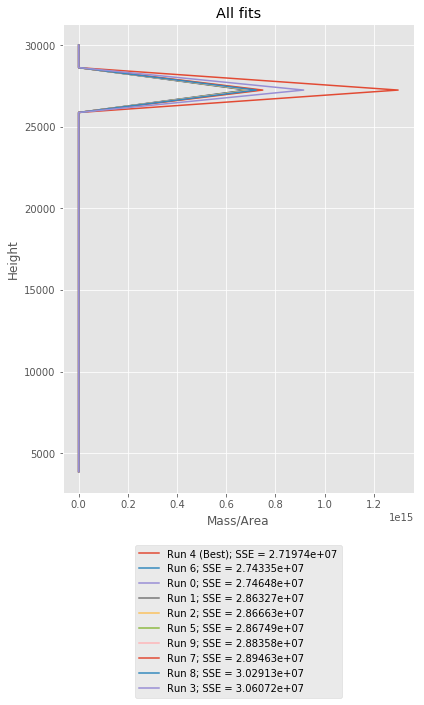

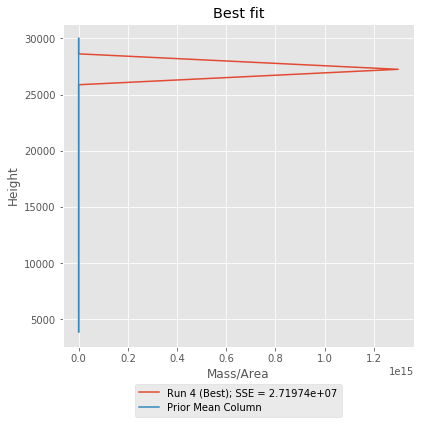

,a,b,h1,u,v,D,ftt,M,SSE
4,"1,649.98",1.331,"28,655.1",-5.62824,-1.80146,"4,000","3,600",1.29884e+15,2.71974e+07
6,610.109,2.1773,"29,999.5",-5.49386,-1.42107,"4,000","3,600",6.96038e+14,2.74335e+07
0,590.55,1.00005,"29,994.6",-5.57673,-1.50259,"4,000","3,600",6.89001e+14,2.74648e+07
1,604.75,1,"30,000",-5.6451,-1.42886,"4,000","3,600",6.83598e+14,2.86327e+07
2,603.379,1,"29,999.7",-5.56129,-1.35116,"4,000","3,600",7.31622e+14,2.86663e+07
5,592.708,1.00001,"30,000",-5.632,-1.4119,"4,000","3,600",7.00767e+14,2.86749e+07
9,"4,713.16",1.59675,"30,000",-5.5763,-1.32002,"4,000","3,600",7.1023e+14,2.88358e+07
7,606.844,1,"30,000",-5.53507,-1.28951,"4,000","3,600",7.48528e+14,2.89463e+07
8,392.052,1,"30,000",-5.71704,-1.38928,"4,000","3,600",7.22387e+14,3.02913e+07
3,588.316,1.01145,"29,986.3",-5.69983,-1.39102,"4,000","3,600",9.14715e+14,3.06072e+07


,D,M,a,b,ftt,h1,u,v
0,"4,000",1.29884e+15,"1,649.98",1.331,"3,600","28,655.1",-5.62824,-1.80146


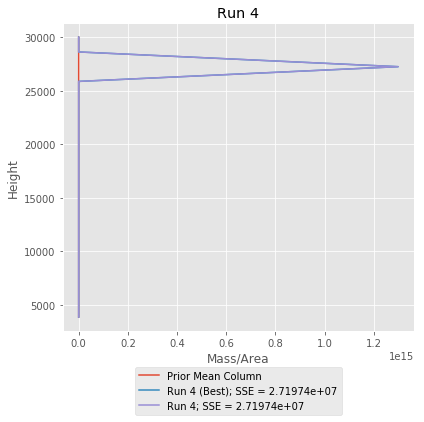

[0.23572631526981525, 0.08859500989197781, 0.04299450477807379, 0.03214678537556767, 0.04474048058108817, 0.07887675860876428, 0.12144933504381, 0.35547081045090306]
0.23572631526981525
0.08859500989197781
0.04299450477807379
0.03214678537556767
0.04474048058108817
0.07887675860876428
0.12144933504381
0.35547081045090306
[{'lower': -4, 'upper': -3.0, 'interval': '[-4,-3)', 'centroid': -3.5, 'density': 1024.0, 'probability': 0.23572631526981525}, {'lower': -3.0, 'upper': -2.0, 'interval': '[-3,-2)', 'centroid': -2.5, 'density': 1024.0, 'probability': 0.08859500989197781}, {'lower': -2.0, 'upper': -1.0, 'interval': '[-2,-1)', 'centroid': -1.5, 'density': 1024.0, 'probability': 0.04299450477807379}, {'lower': -1.0, 'upper': 0.0, 'interval': '[-1,0)', 'centroid': -0.5, 'density': 1024.0, 'probability': 0.03214678537556767}, {'lower': 0.0, 'upper': 1.0, 'interval': '[0,1)', 'centroid': 0.5, 'density': 1233.5, 'probability': 0.04474048058108817}, {'lower': 1.0, 'upper': 2.0, 'interval': '[1,

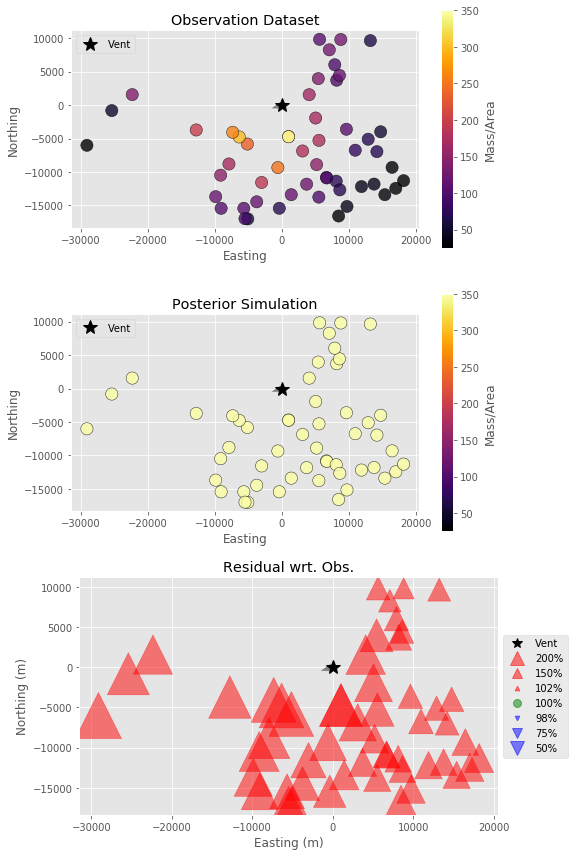

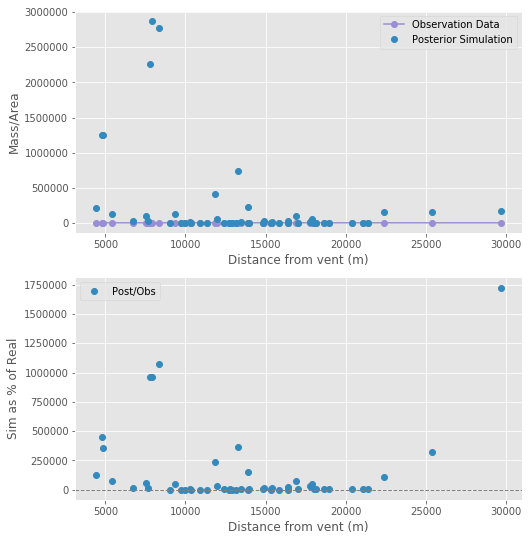

[0.13243669 0.16132092 0.1626316  0.16881614 0.18696809 0.1344063
 0.04610801 0.00731225]
[0.40692161 0.22228106 0.1406263  0.10493171 0.06616139 0.04513769
 0.01008292 0.00385731]
[-3.5, -2.5, -1.5, -0.5, 0.5, 1.5, 2.5, 3.5]


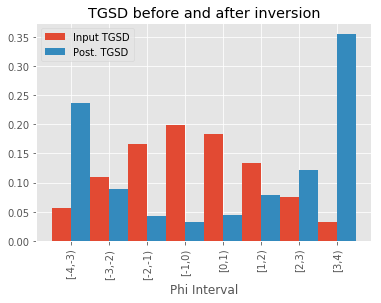

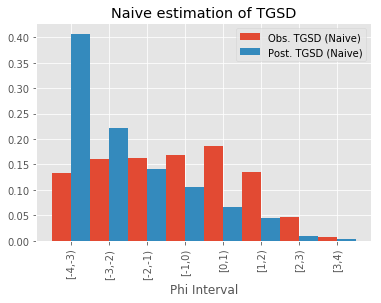

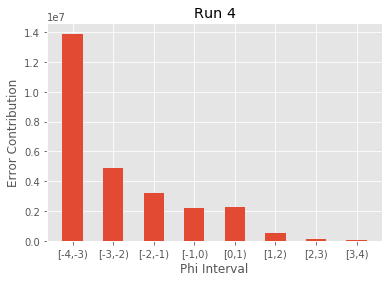

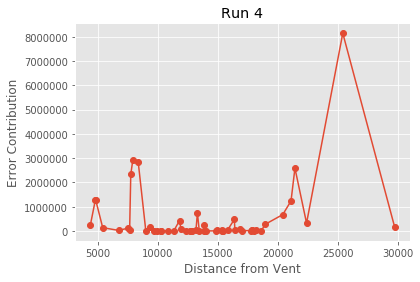

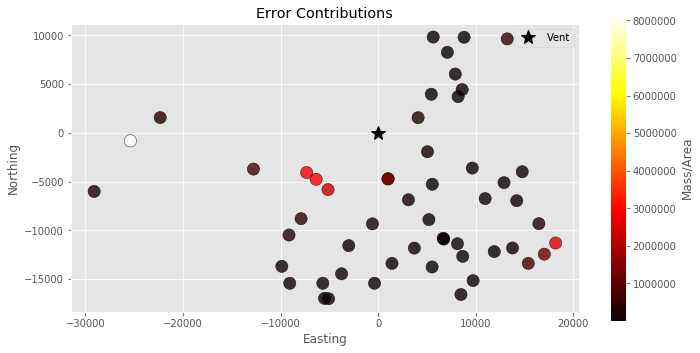

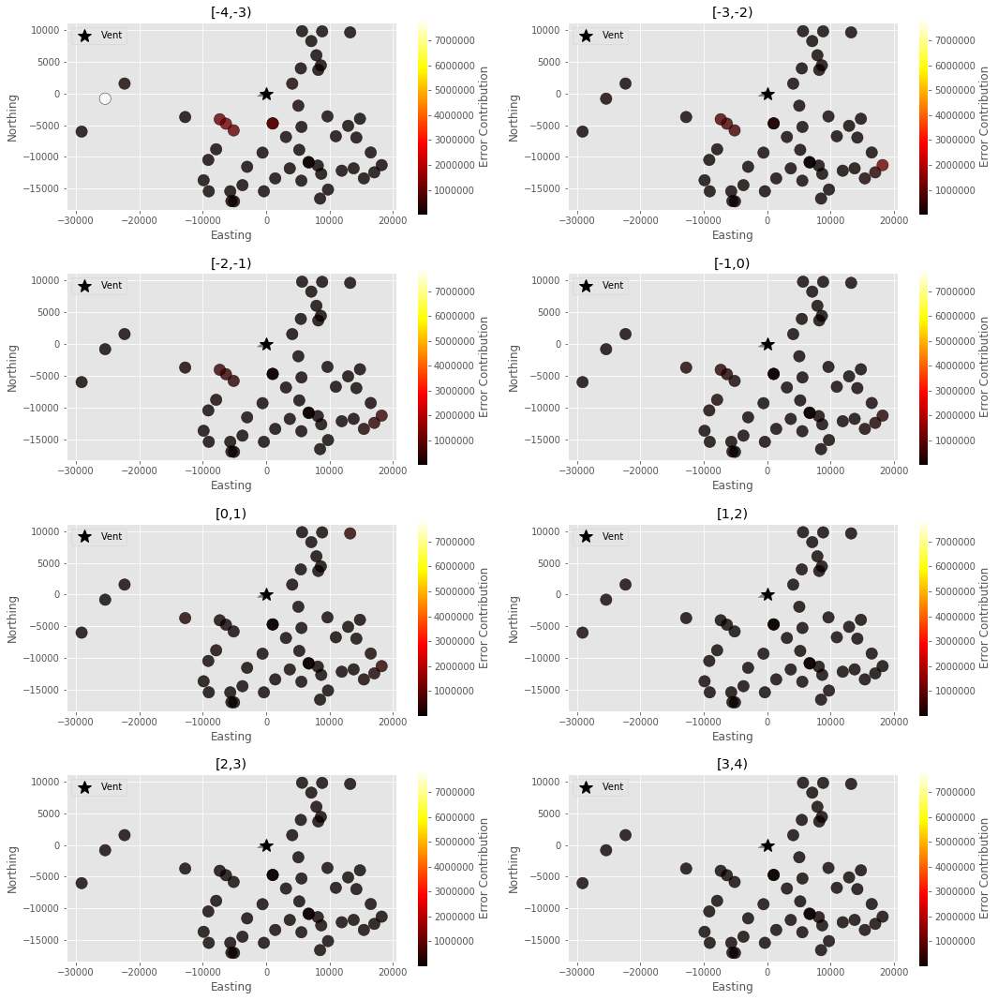

c:\users\nmostert\envs\spew\lib\site-packages\ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide


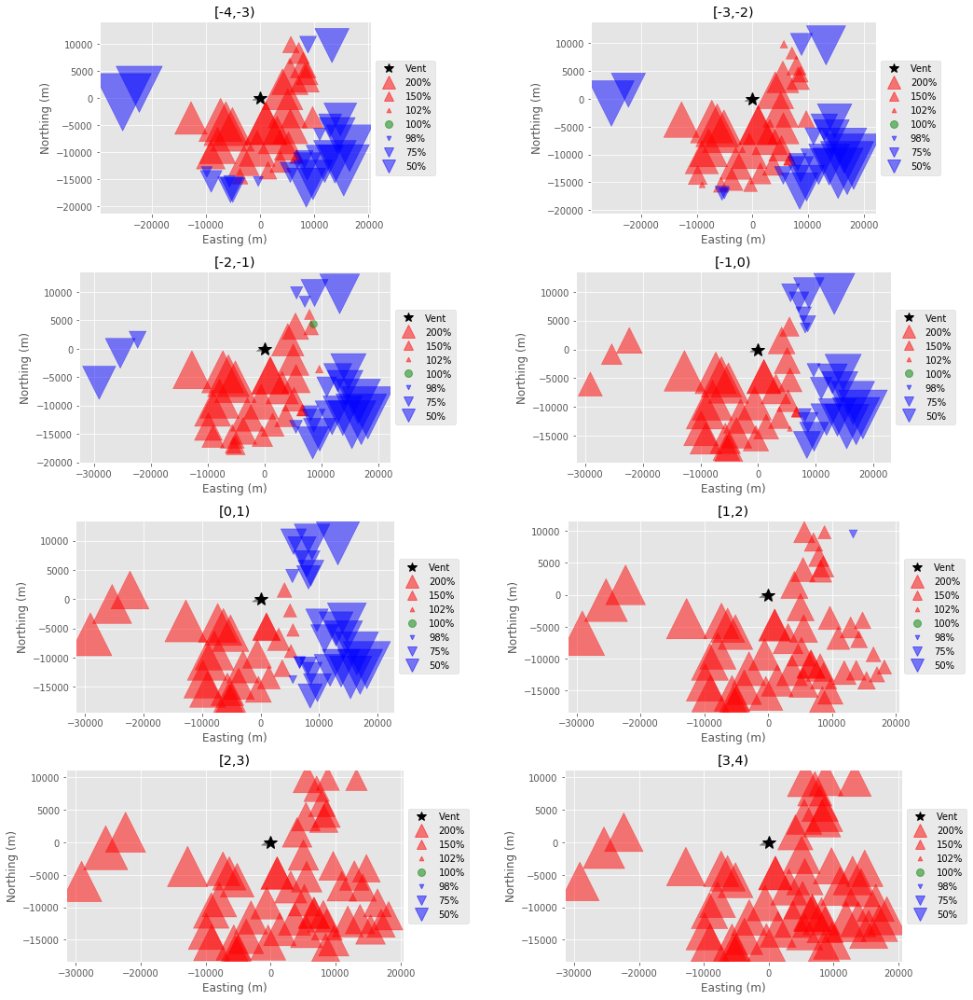

,D,M,a,b,ftt,h1,u,v
0,"4,000",6.96038e+14,610.109,2.1773,"3,600","29,999.5",-5.49386,-1.42107


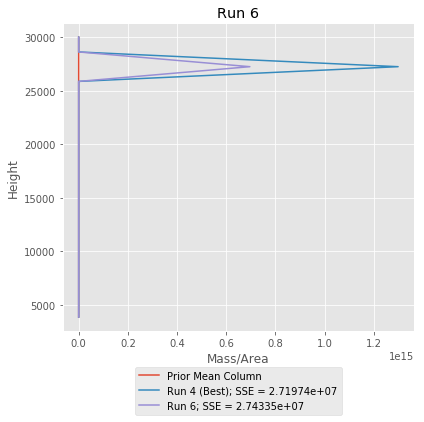

[0.5102924202628888, 0.22689811645380187, 0.09854328022234282, 0.056651038210186966, 0.04709814472175477, 0.03469636897011855, 0.013682008425117721, 0.012138622733788592]
0.5102924202628888
0.22689811645380187
0.09854328022234282
0.056651038210186966
0.04709814472175477
0.03469636897011855
0.013682008425117721
0.012138622733788592
[{'lower': -4, 'upper': -3.0, 'interval': '[-4,-3)', 'centroid': -3.5, 'density': 1024.0, 'probability': 0.5102924202628888}, {'lower': -3.0, 'upper': -2.0, 'interval': '[-3,-2)', 'centroid': -2.5, 'density': 1024.0, 'probability': 0.22689811645380187}, {'lower': -2.0, 'upper': -1.0, 'interval': '[-2,-1)', 'centroid': -1.5, 'density': 1024.0, 'probability': 0.09854328022234282}, {'lower': -1.0, 'upper': 0.0, 'interval': '[-1,0)', 'centroid': -0.5, 'density': 1024.0, 'probability': 0.056651038210186966}, {'lower': 0.0, 'upper': 1.0, 'interval': '[0,1)', 'centroid': 0.5, 'density': 1233.5, 'probability': 0.04709814472175477}, {'lower': 1.0, 'upper': 2.0, 'inter

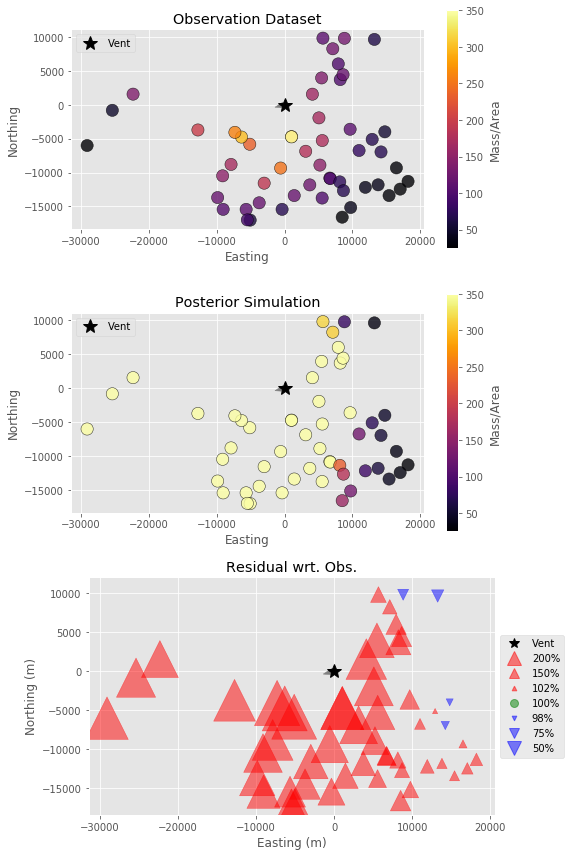

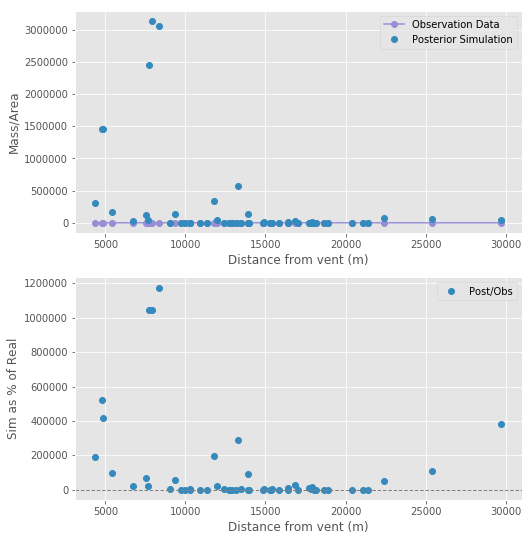

[0.13243669 0.16132092 0.1626316  0.16881614 0.18696809 0.1344063
 0.04610801 0.00731225]
[4.44289803e-01 2.72740232e-01 1.50356462e-01 8.62009391e-02
 3.50619337e-02 1.06186870e-02 6.53694600e-04 7.82486922e-05]
[-3.5, -2.5, -1.5, -0.5, 0.5, 1.5, 2.5, 3.5]


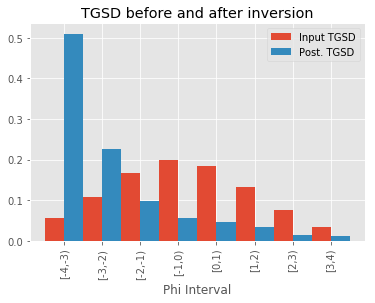

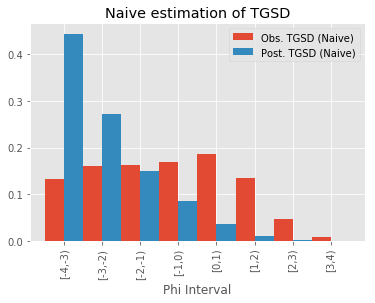

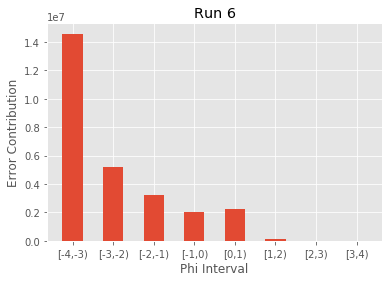

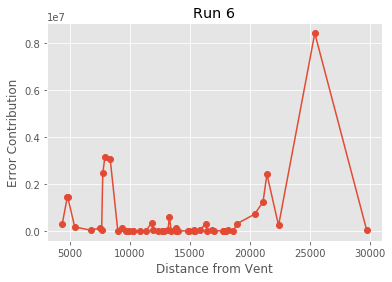

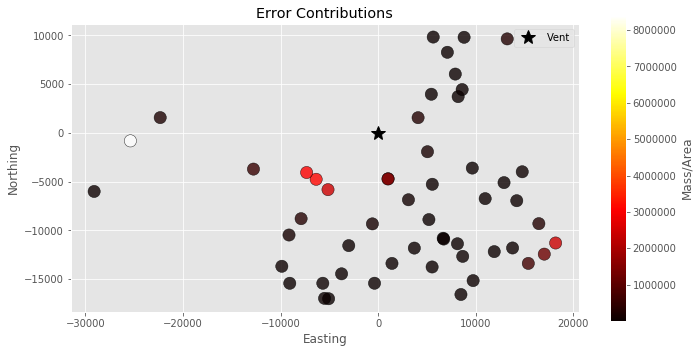

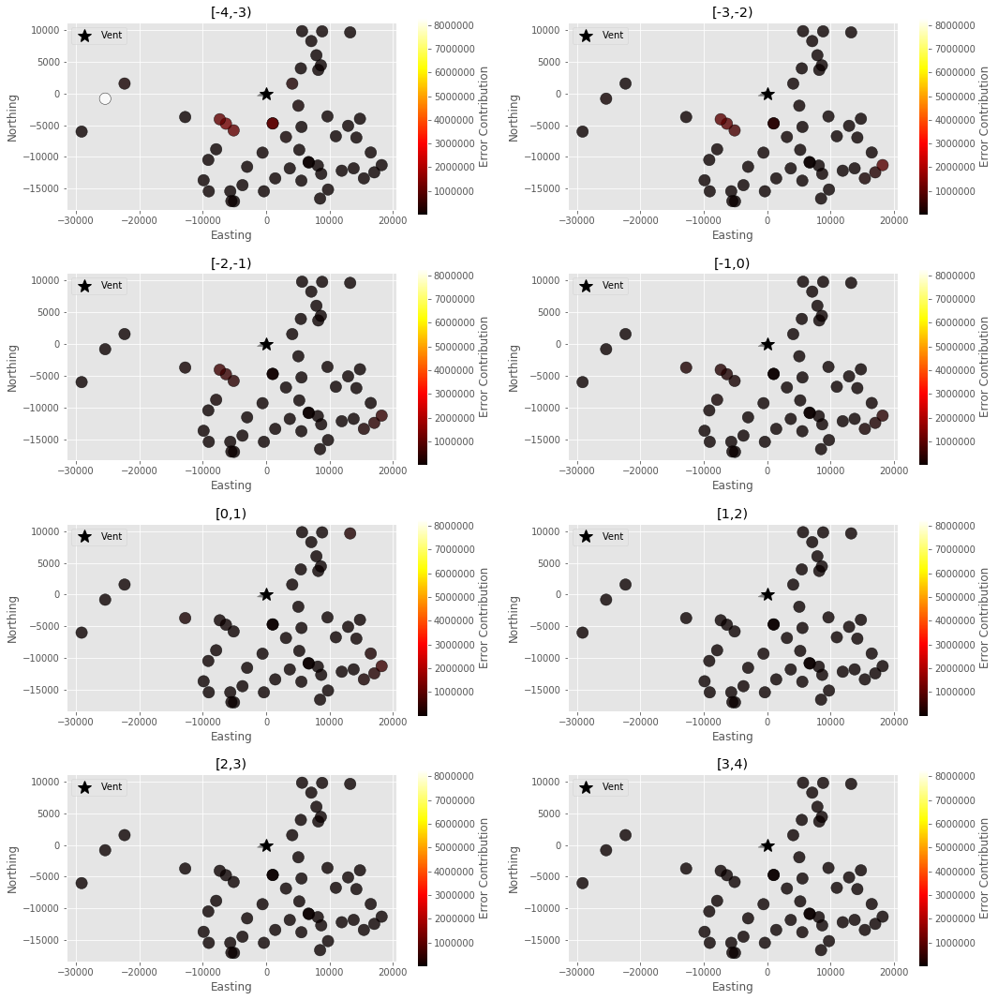

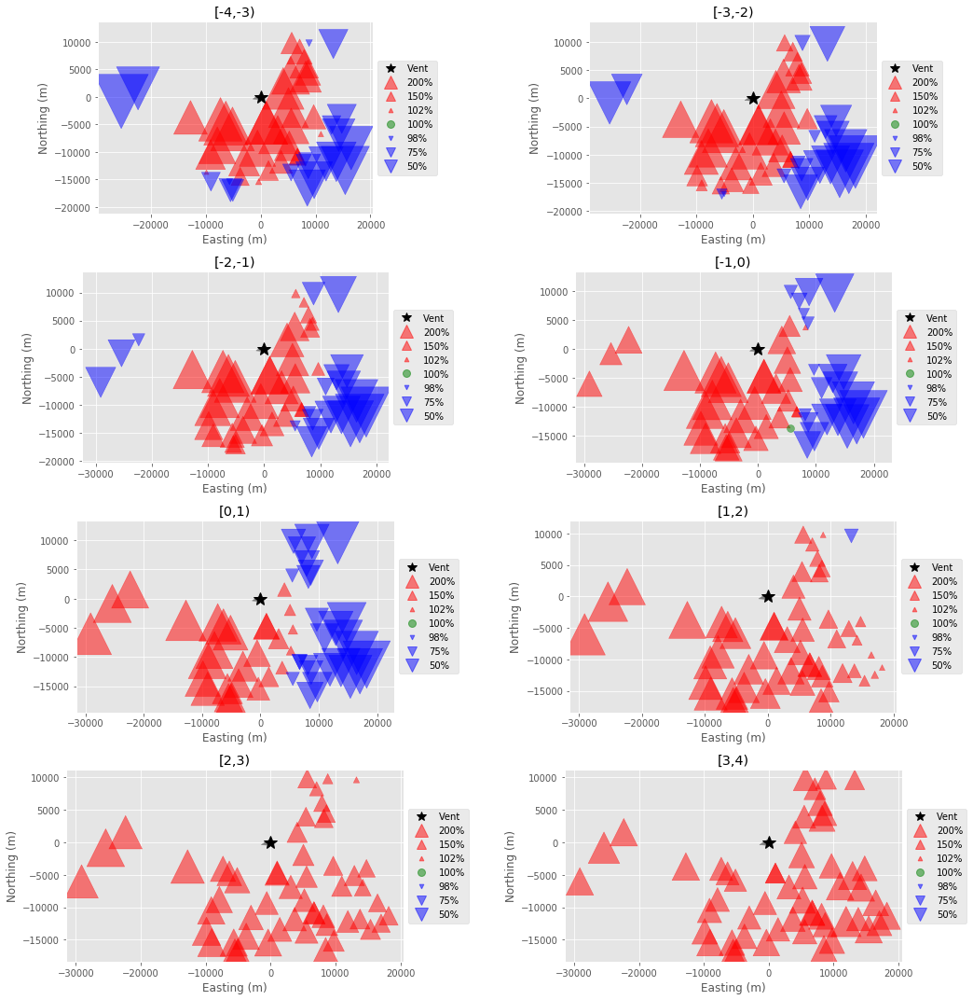

,D,M,a,b,ftt,h1,u,v
0,"4,000",6.89001e+14,590.55,1.00005,"3,600","29,994.6",-5.57673,-1.50259


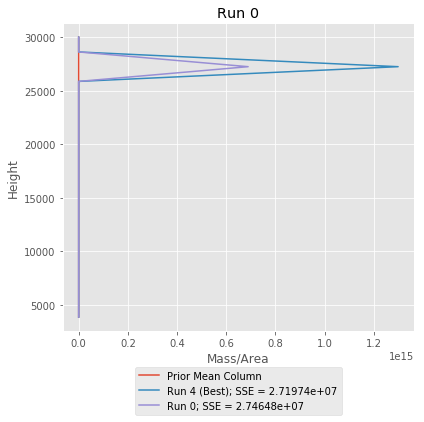

[0.4601689338873593, 0.21562145967864255, 0.10677372769254471, 0.07031108226620048, 0.06493750415596765, 0.045033992163105684, 0.019712286717659493, 0.017441013438520187]
0.4601689338873593
0.21562145967864255
0.10677372769254471
0.07031108226620048
0.06493750415596765
0.045033992163105684
0.019712286717659493
0.017441013438520187
[{'lower': -4, 'upper': -3.0, 'interval': '[-4,-3)', 'centroid': -3.5, 'density': 1024.0, 'probability': 0.4601689338873593}, {'lower': -3.0, 'upper': -2.0, 'interval': '[-3,-2)', 'centroid': -2.5, 'density': 1024.0, 'probability': 0.21562145967864255}, {'lower': -2.0, 'upper': -1.0, 'interval': '[-2,-1)', 'centroid': -1.5, 'density': 1024.0, 'probability': 0.10677372769254471}, {'lower': -1.0, 'upper': 0.0, 'interval': '[-1,0)', 'centroid': -0.5, 'density': 1024.0, 'probability': 0.07031108226620048}, {'lower': 0.0, 'upper': 1.0, 'interval': '[0,1)', 'centroid': 0.5, 'density': 1233.5, 'probability': 0.06493750415596765}, {'lower': 1.0, 'upper': 2.0, 'interv

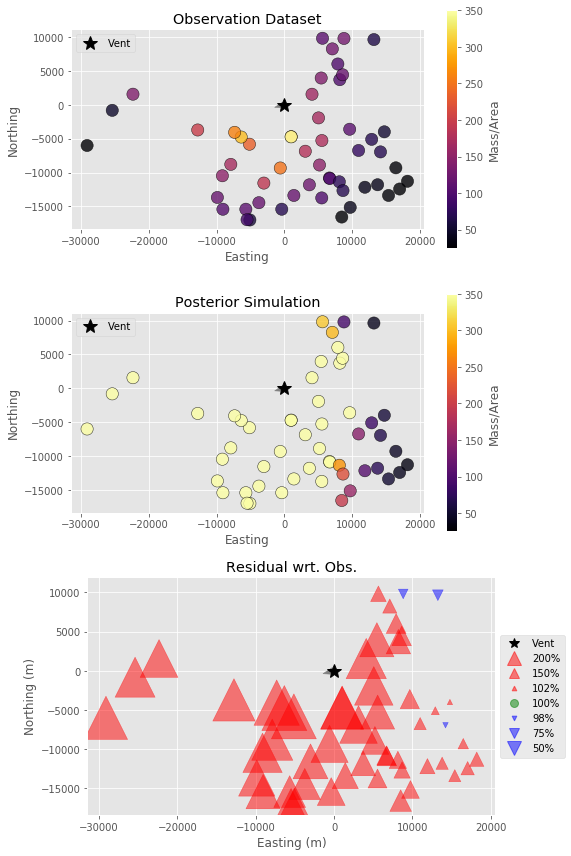

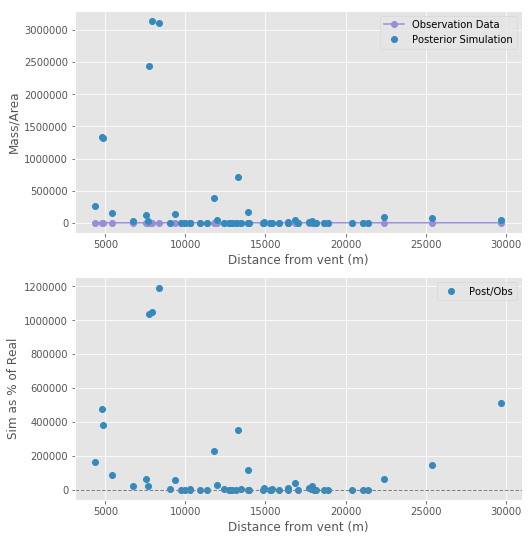

[0.13243669 0.16132092 0.1626316  0.16881614 0.18696809 0.1344063
 0.04610801 0.00731225]
[4.04228252e-01 2.63046099e-01 1.65107612e-01 1.07007194e-01
 4.66357259e-02 1.30206672e-02 8.52657595e-04 1.01792388e-04]
[-3.5, -2.5, -1.5, -0.5, 0.5, 1.5, 2.5, 3.5]


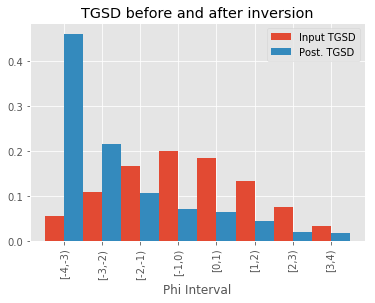

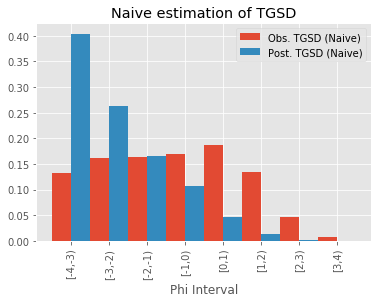

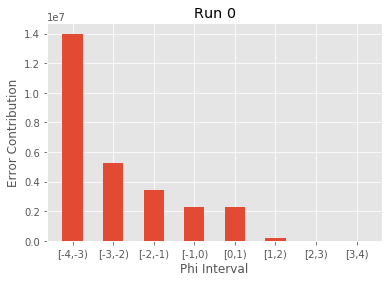

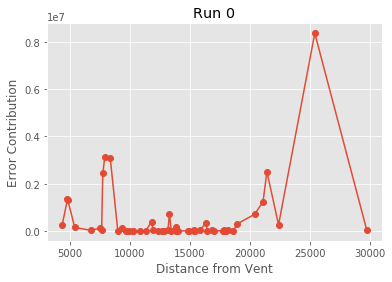

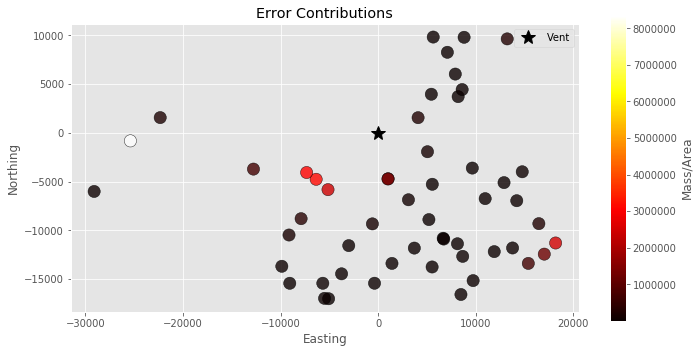

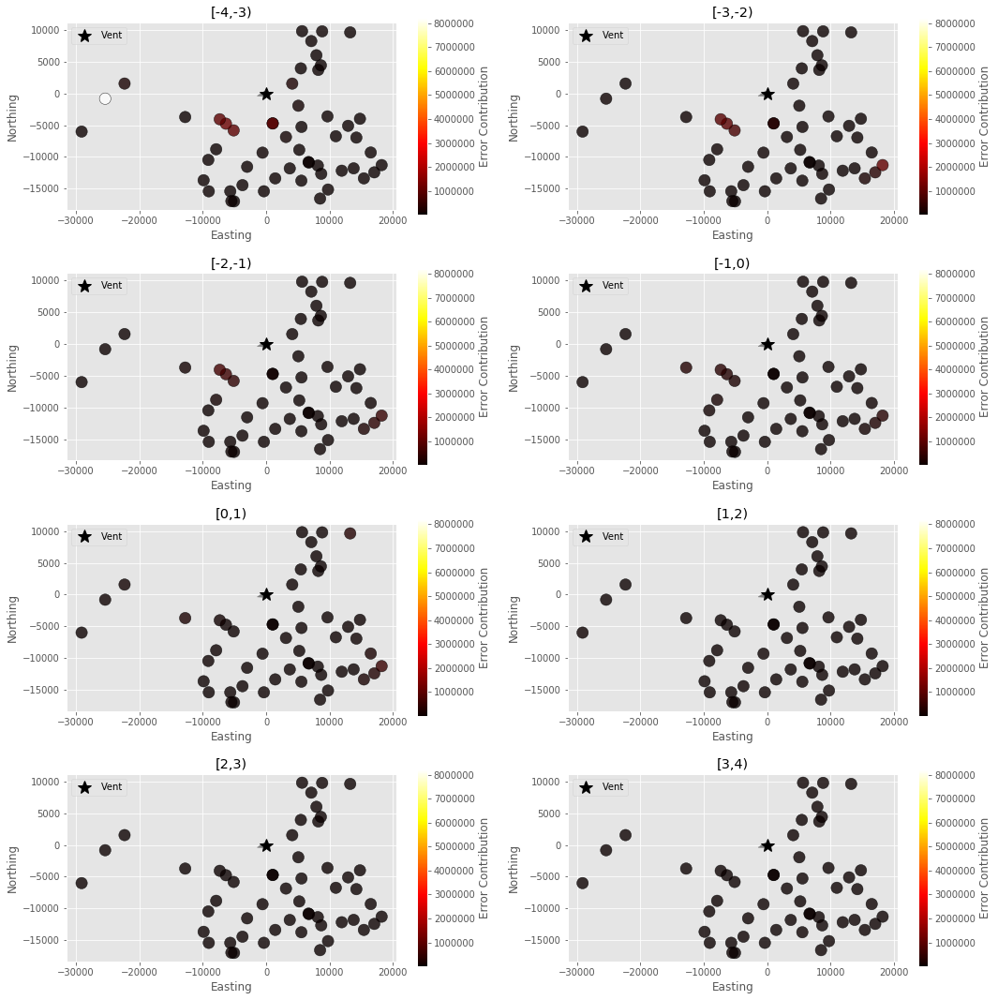

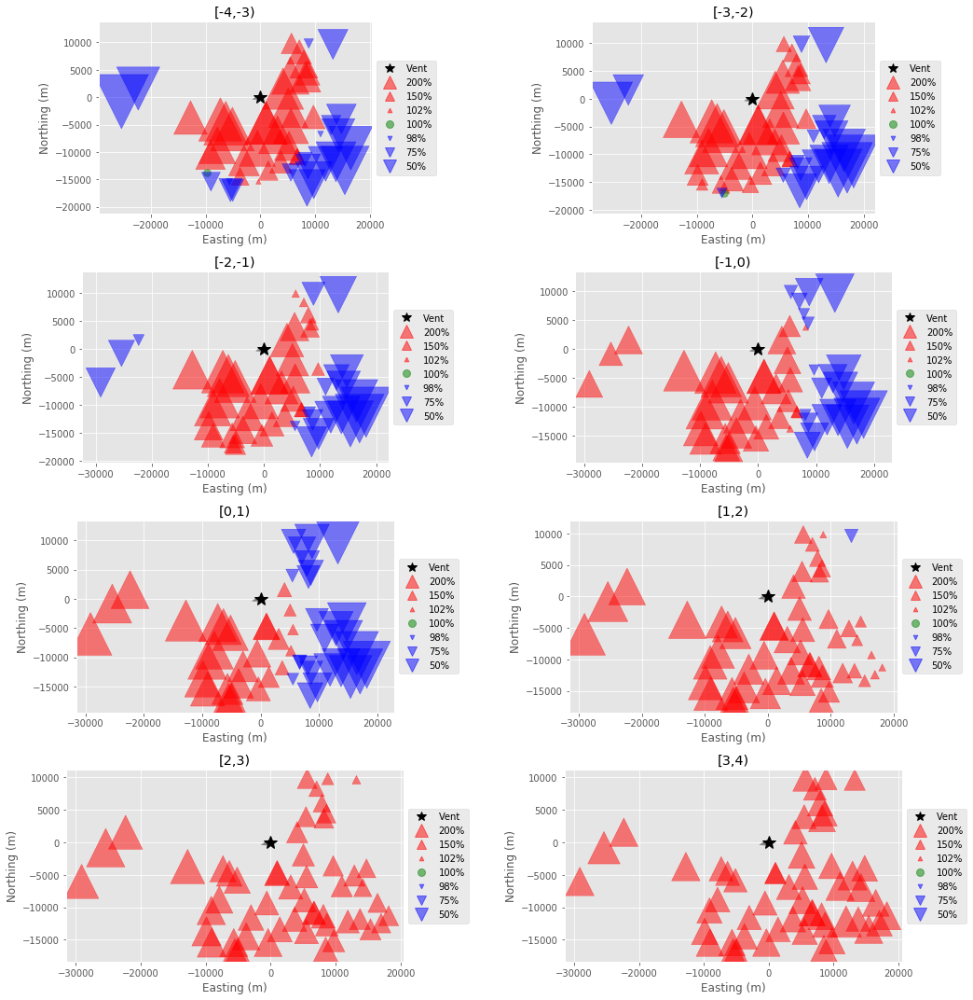

,D,M,a,b,ftt,h1,u,v
0,"4,000",6.83598e+14,604.75,1,"3,600","30,000",-5.6451,-1.42886


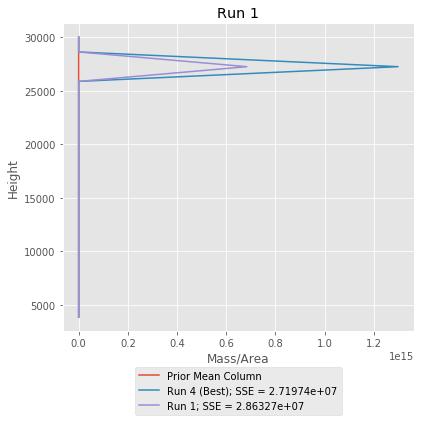

[0.4008700565883114, 0.2307389061853536, 0.1390908859588173, 0.10677227359466872, 0.07636743476528947, 0.02470414233506984, 0.008776343049594916, 0.012679957522894678]
0.4008700565883114
0.2307389061853536
0.1390908859588173
0.10677227359466872
0.07636743476528947
0.02470414233506984
0.008776343049594916
0.012679957522894678
[{'lower': -4, 'upper': -3.0, 'interval': '[-4,-3)', 'centroid': -3.5, 'density': 1024.0, 'probability': 0.4008700565883114}, {'lower': -3.0, 'upper': -2.0, 'interval': '[-3,-2)', 'centroid': -2.5, 'density': 1024.0, 'probability': 0.2307389061853536}, {'lower': -2.0, 'upper': -1.0, 'interval': '[-2,-1)', 'centroid': -1.5, 'density': 1024.0, 'probability': 0.1390908859588173}, {'lower': -1.0, 'upper': 0.0, 'interval': '[-1,0)', 'centroid': -0.5, 'density': 1024.0, 'probability': 0.10677227359466872}, {'lower': 0.0, 'upper': 1.0, 'interval': '[0,1)', 'centroid': 0.5, 'density': 1233.5, 'probability': 0.07636743476528947}, {'lower': 1.0, 'upper': 2.0, 'interval': '[1

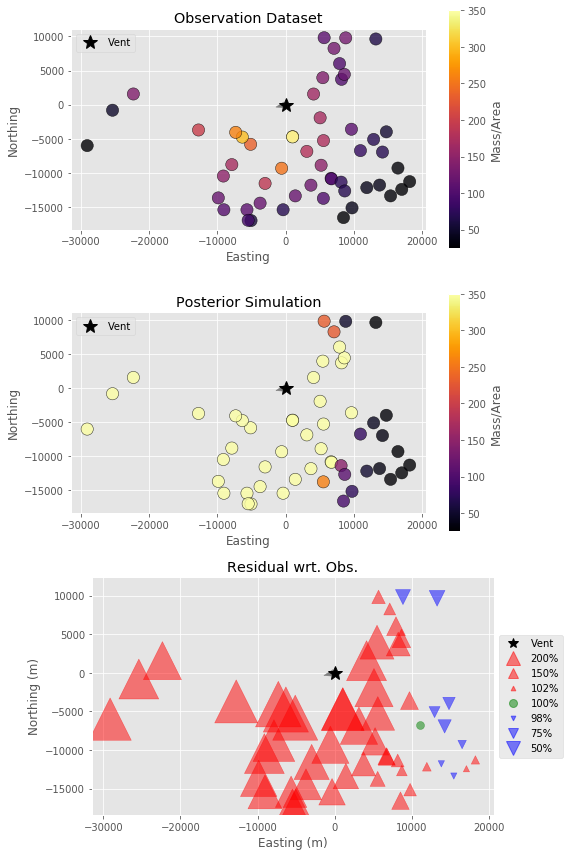

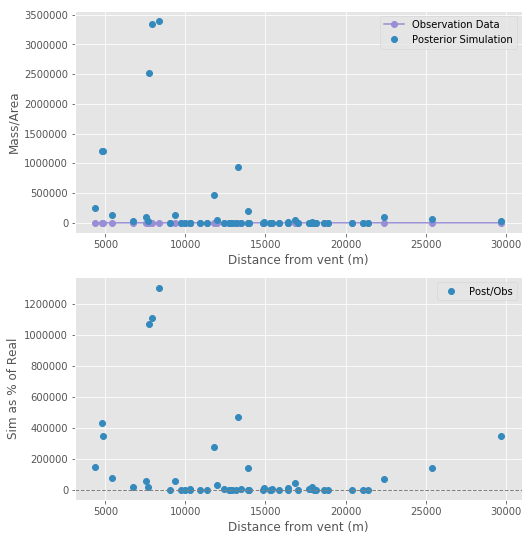

[0.13243669 0.16132092 0.1626316  0.16881614 0.18696809 0.1344063
 0.04610801 0.00731225]
[3.29201196e-01 2.63068859e-01 2.00303285e-01 1.49897234e-01
 5.05076848e-02 6.61129178e-03 3.43244409e-04 6.72054935e-05]
[-3.5, -2.5, -1.5, -0.5, 0.5, 1.5, 2.5, 3.5]


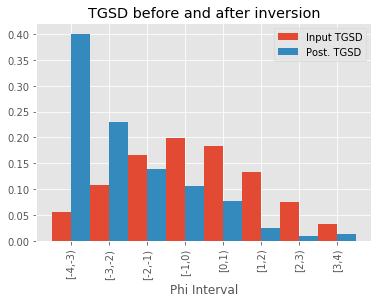

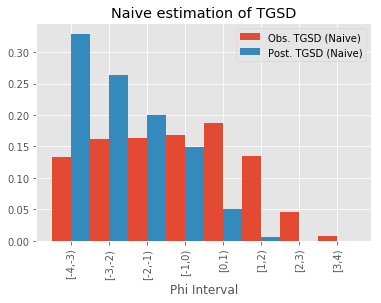

C:\Users\nmostert\Documents\repos\inversion_project\utils.py:451: RuntimeWarning: divide by zero encountered in log
  b_star = np.log(b - 1)
C:\Users\nmostert\Documents\repos\inversion_project\utils.py:452: RuntimeWarning: divide by zero encountered in log
  h1_star = -np.log(-np.log(h1/H))
C:\Users\nmostert\Documents\repos\inversion_project\utils.py:487: RuntimeWarning: divide by zero encountered in double_scalars
  factor_a = (1/((a-1)*(b-1)*(H-h1)))


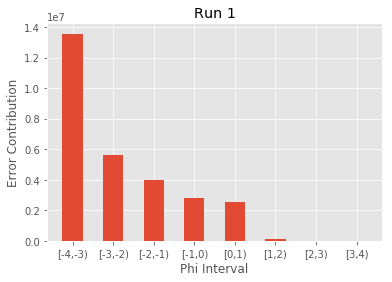

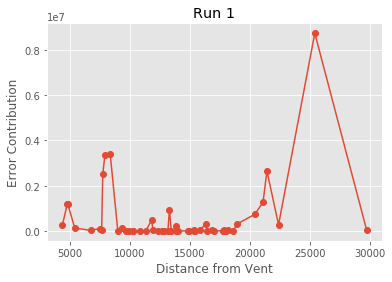

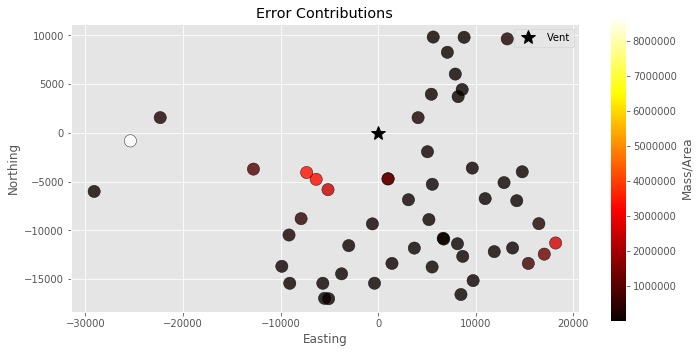

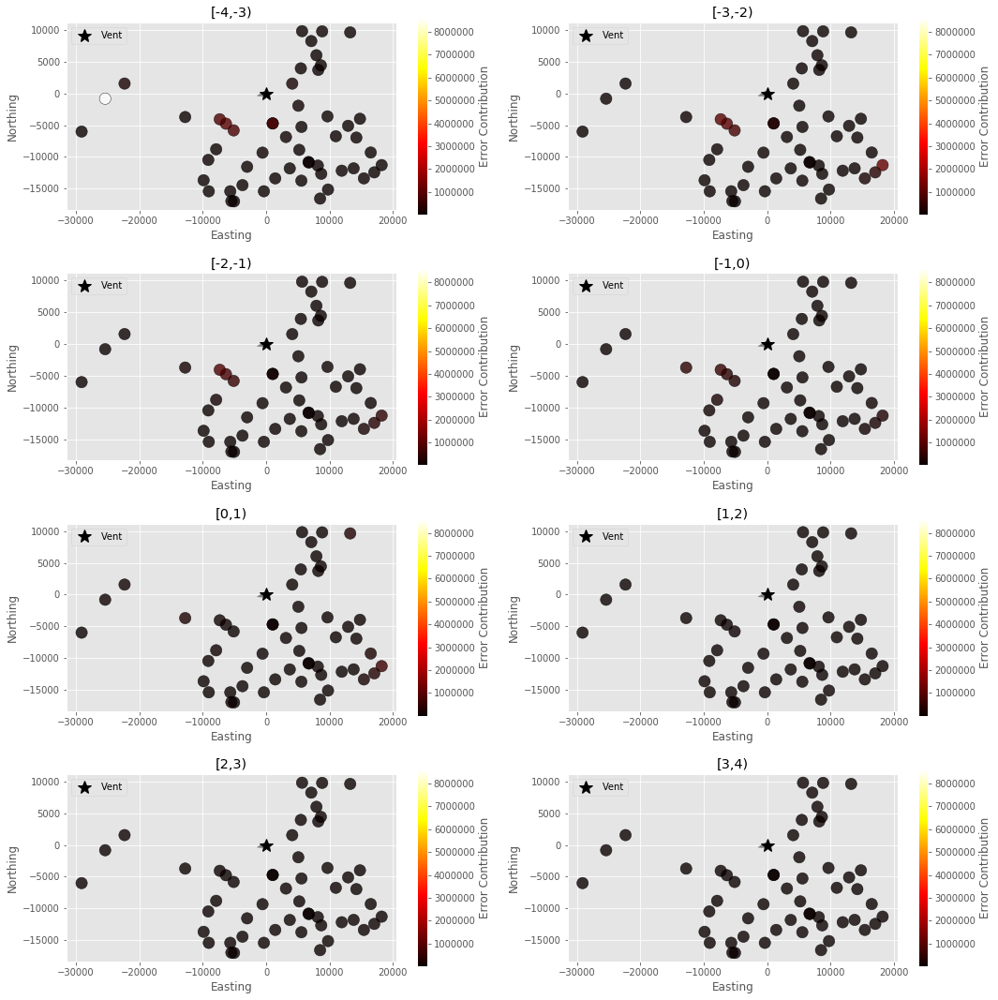

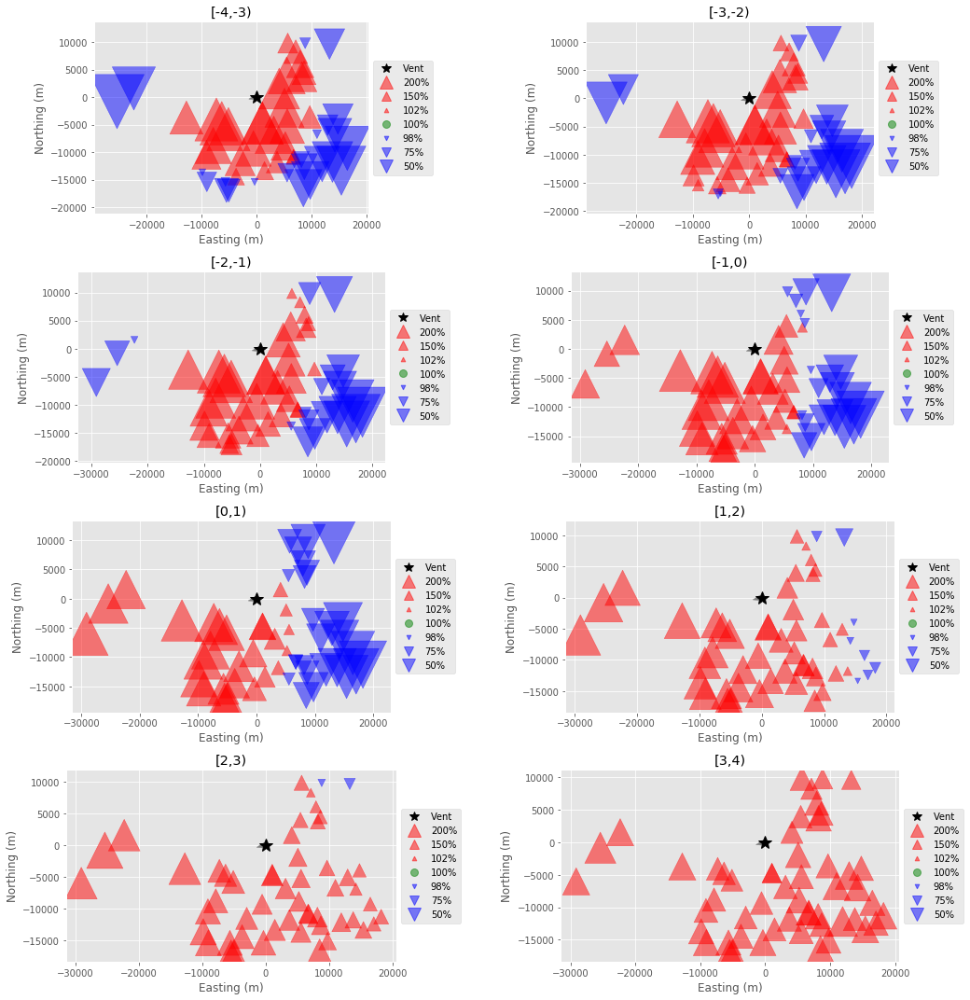

,D,M,a,b,ftt,h1,u,v
0,"4,000",7.31622e+14,603.379,1,"3,600","29,999.7",-5.56129,-1.35116


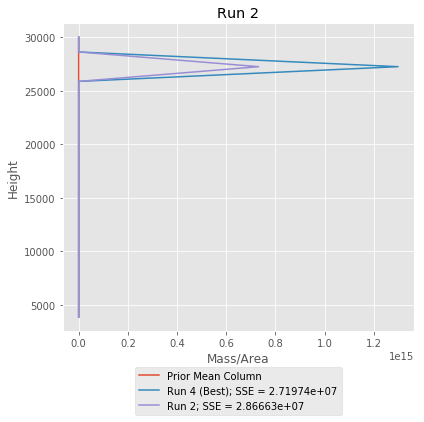

[0.41641550148502665, 0.25789585229206796, 0.12127352487998581, 0.06701938814760733, 0.051750141215472806, 0.04803822308979539, 0.03001735902842242, 0.007590009861621575]
0.41641550148502665
0.25789585229206796
0.12127352487998581
0.06701938814760733
0.051750141215472806
0.04803822308979539
0.03001735902842242
0.007590009861621575
[{'lower': -4, 'upper': -3.0, 'interval': '[-4,-3)', 'centroid': -3.5, 'density': 1024.0, 'probability': 0.41641550148502665}, {'lower': -3.0, 'upper': -2.0, 'interval': '[-3,-2)', 'centroid': -2.5, 'density': 1024.0, 'probability': 0.25789585229206796}, {'lower': -2.0, 'upper': -1.0, 'interval': '[-2,-1)', 'centroid': -1.5, 'density': 1024.0, 'probability': 0.12127352487998581}, {'lower': -1.0, 'upper': 0.0, 'interval': '[-1,0)', 'centroid': -0.5, 'density': 1024.0, 'probability': 0.06701938814760733}, {'lower': 0.0, 'upper': 1.0, 'interval': '[0,1)', 'centroid': 0.5, 'density': 1233.5, 'probability': 0.051750141215472806}, {'lower': 1.0, 'upper': 2.0, 'inte

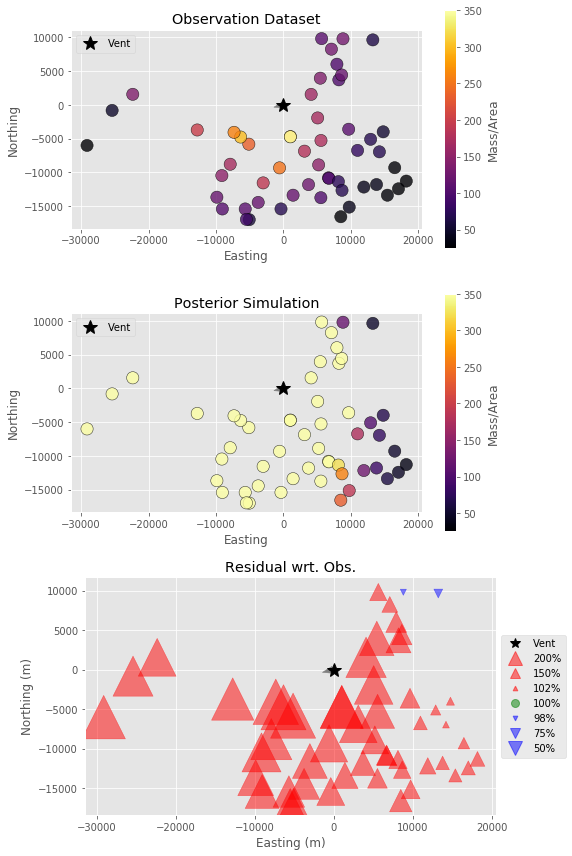

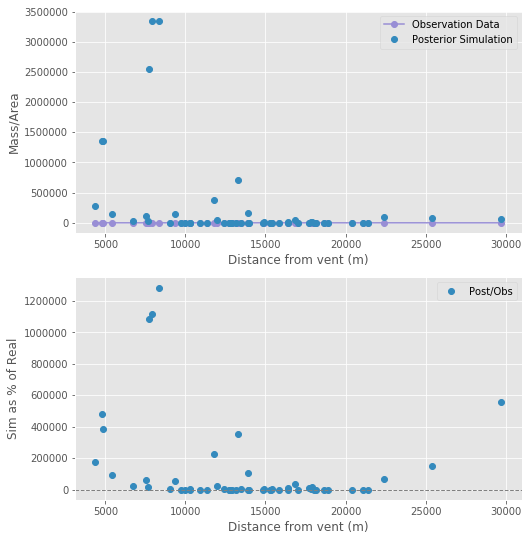

[0.13243669 0.16132092 0.1626316  0.16881614 0.18696809 0.1344063
 0.04610801 0.00731225]
[3.58424104e-01 3.06438066e-01 1.82314877e-01 9.95446107e-02
 3.74797460e-02 1.43804562e-02 1.37115578e-03 4.69849971e-05]
[-3.5, -2.5, -1.5, -0.5, 0.5, 1.5, 2.5, 3.5]


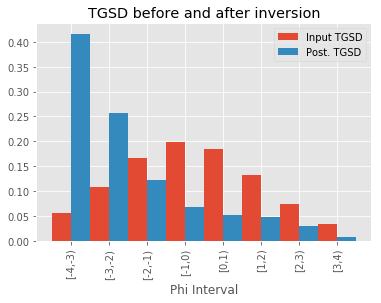

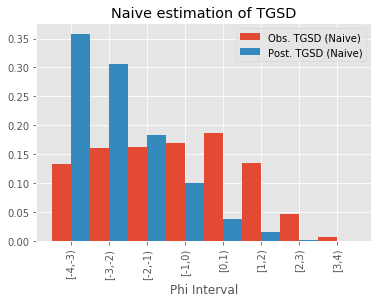

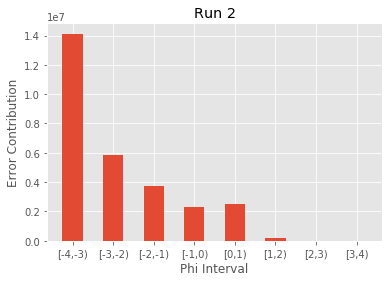

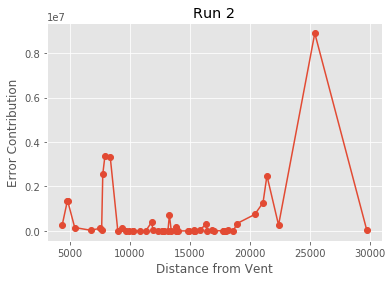

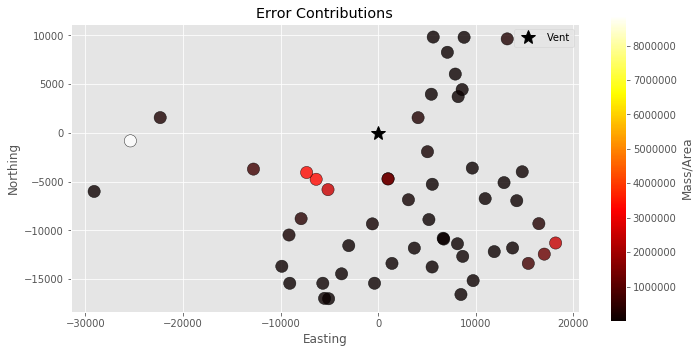

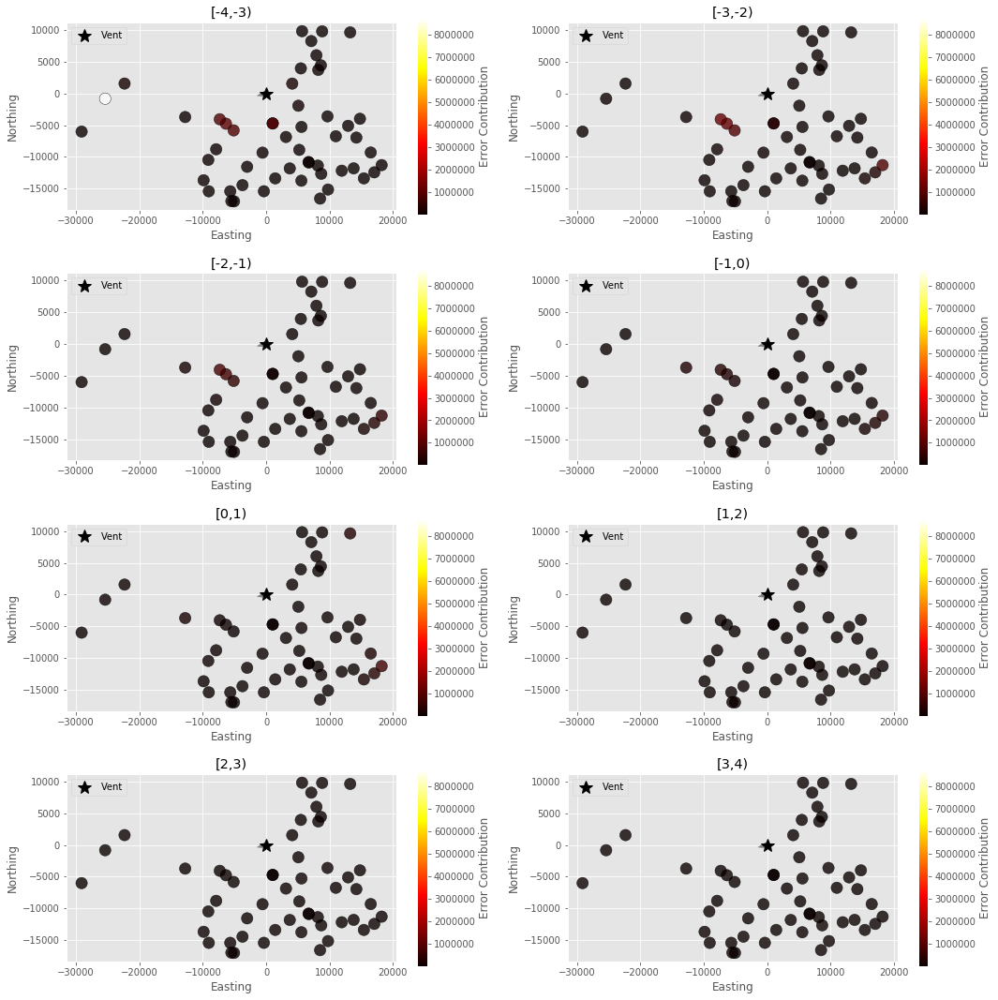

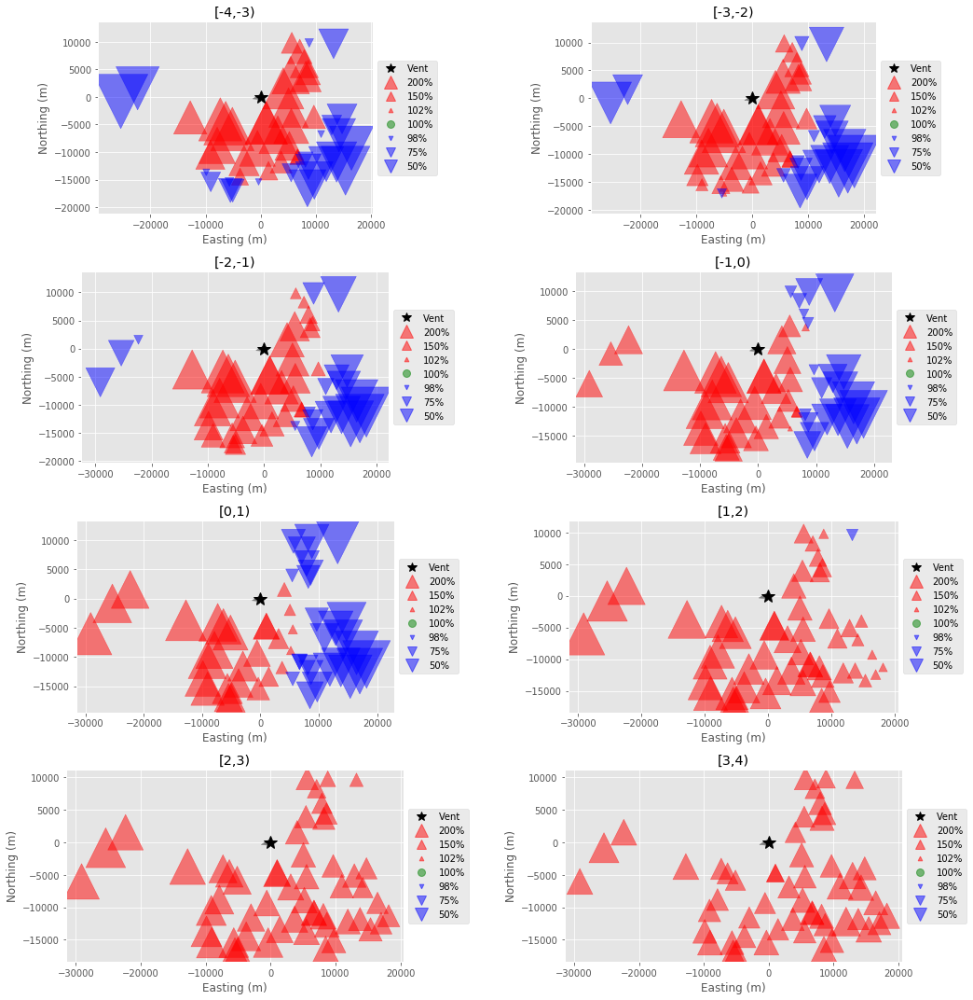

,D,M,a,b,ftt,h1,u,v
0,"4,000",7.00767e+14,592.708,1.00001,"3,600","30,000",-5.632,-1.4119


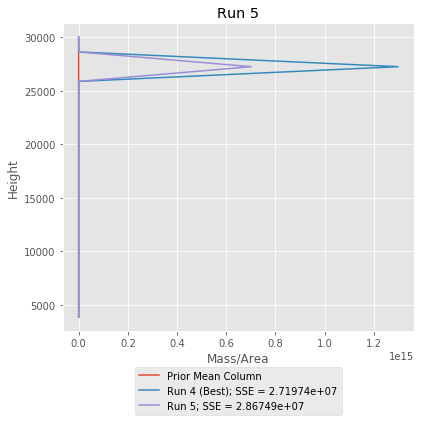

[0.3954705881698075, 0.24675608475359362, 0.1350554786246437, 0.08732104619000464, 0.07096138867881081, 0.03826373445243365, 0.012868256803254841, 0.013303422327451027]
0.3954705881698075
0.24675608475359362
0.1350554786246437
0.08732104619000464
0.07096138867881081
0.03826373445243365
0.012868256803254841
0.013303422327451027
[{'lower': -4, 'upper': -3.0, 'interval': '[-4,-3)', 'centroid': -3.5, 'density': 1024.0, 'probability': 0.3954705881698075}, {'lower': -3.0, 'upper': -2.0, 'interval': '[-3,-2)', 'centroid': -2.5, 'density': 1024.0, 'probability': 0.24675608475359362}, {'lower': -2.0, 'upper': -1.0, 'interval': '[-2,-1)', 'centroid': -1.5, 'density': 1024.0, 'probability': 0.1350554786246437}, {'lower': -1.0, 'upper': 0.0, 'interval': '[-1,0)', 'centroid': -0.5, 'density': 1024.0, 'probability': 0.08732104619000464}, {'lower': 0.0, 'upper': 1.0, 'interval': '[0,1)', 'centroid': 0.5, 'density': 1233.5, 'probability': 0.07096138867881081}, {'lower': 1.0, 'upper': 2.0, 'interval': 

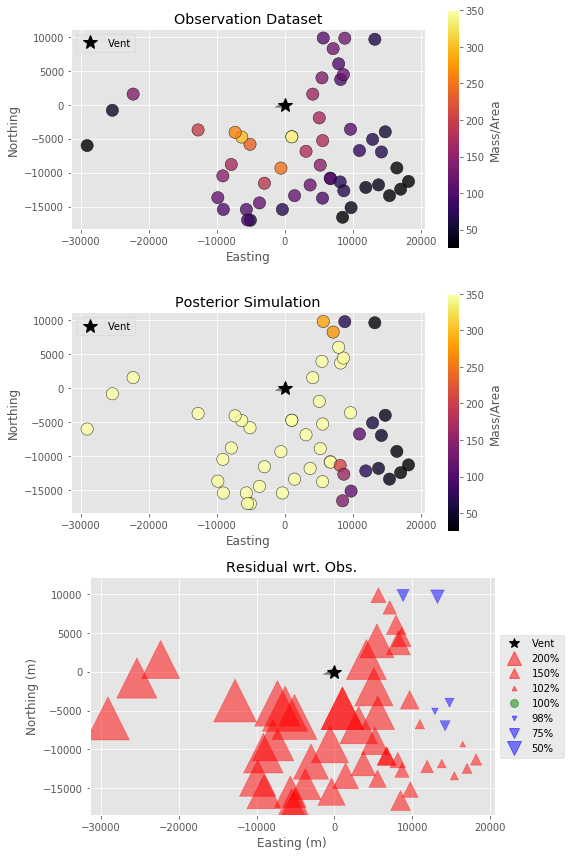

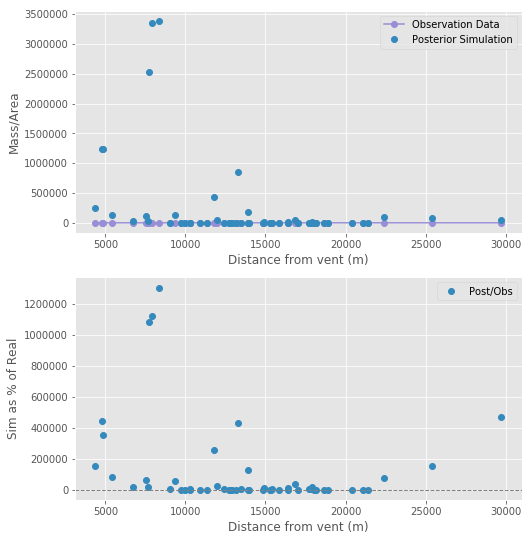

[0.13243669 0.16132092 0.1626316  0.16881614 0.18696809 0.1344063
 0.04610801 0.00731225]
[3.31008203e-01 2.86440766e-01 1.98068188e-01 1.25117684e-01
 4.82078940e-02 1.05612064e-02 5.22804668e-04 7.32551859e-05]
[-3.5, -2.5, -1.5, -0.5, 0.5, 1.5, 2.5, 3.5]


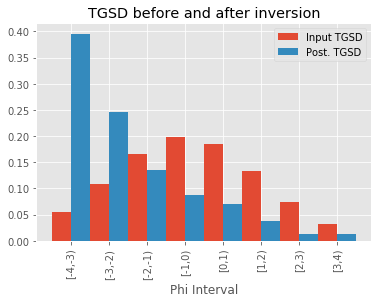

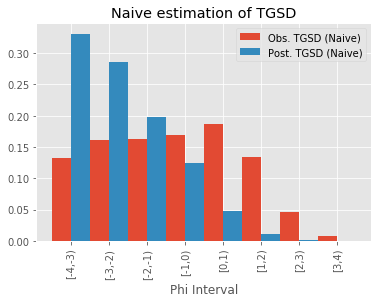

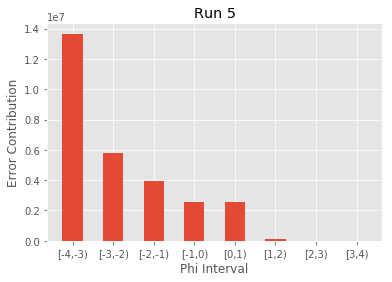

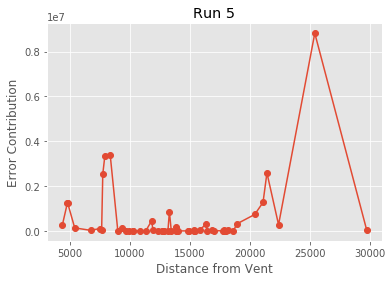

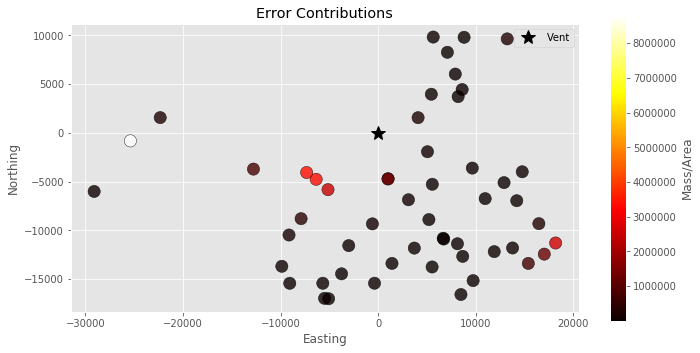

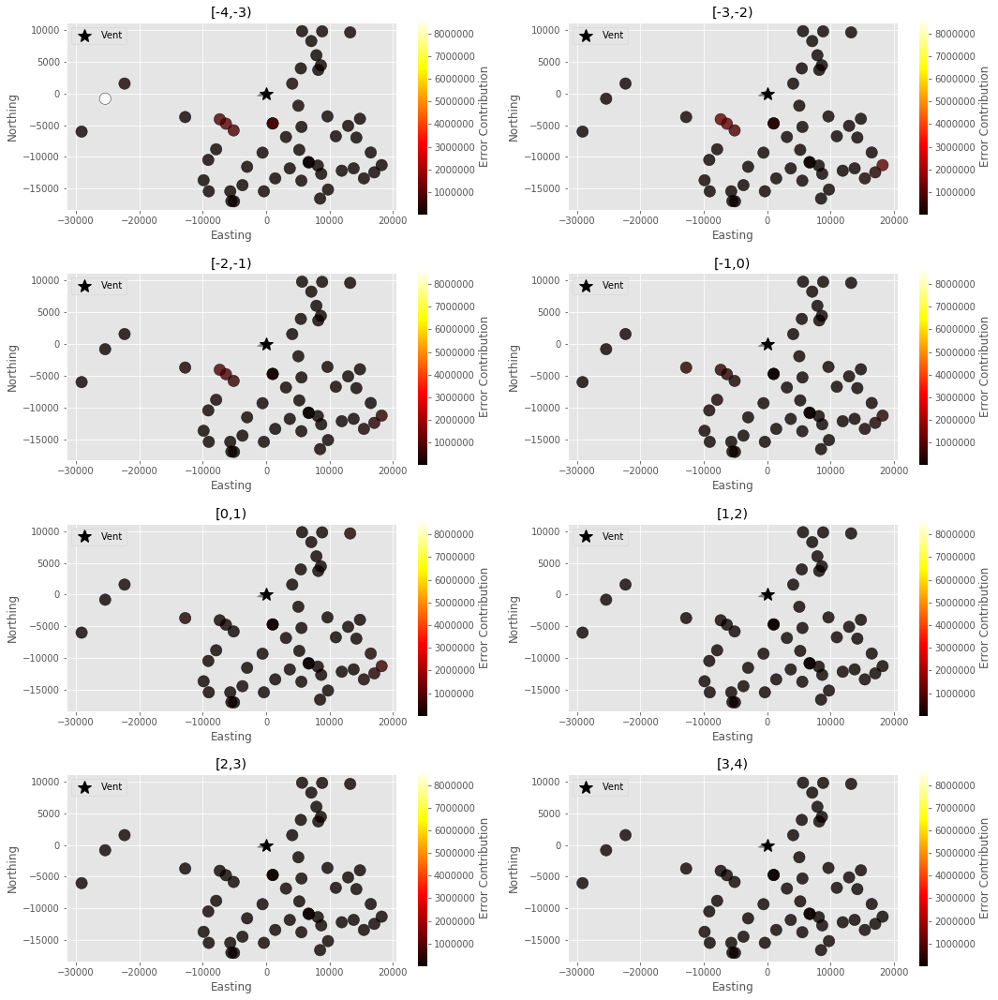

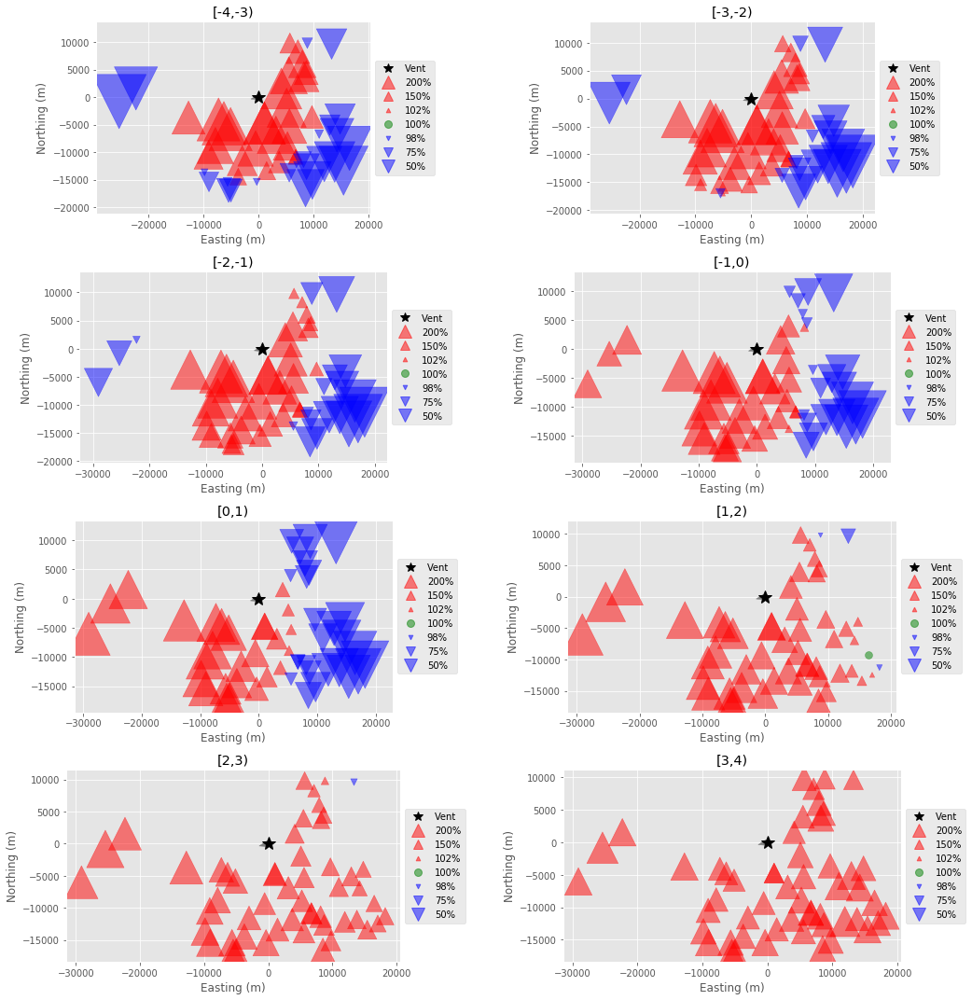

,D,M,a,b,ftt,h1,u,v
0,"4,000",7.1023e+14,"4,713.16",1.59675,"3,600","30,000",-5.5763,-1.32002


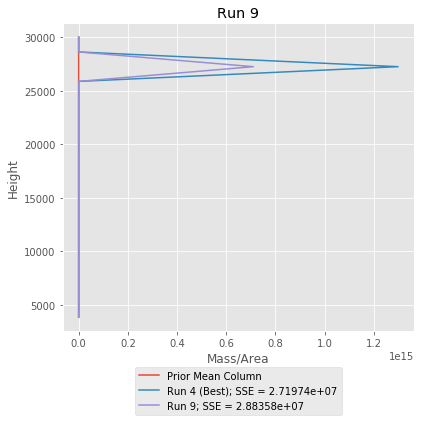

[0.4166772273105033, 0.26916093940733415, 0.1348133288710039, 0.07692601861353811, 0.05633365727467655, 0.02893463834227184, 0.007964271934441743, 0.009189918246230385]
0.4166772273105033
0.26916093940733415
0.1348133288710039
0.07692601861353811
0.05633365727467655
0.02893463834227184
0.007964271934441743
0.009189918246230385
[{'lower': -4, 'upper': -3.0, 'interval': '[-4,-3)', 'centroid': -3.5, 'density': 1024.0, 'probability': 0.4166772273105033}, {'lower': -3.0, 'upper': -2.0, 'interval': '[-3,-2)', 'centroid': -2.5, 'density': 1024.0, 'probability': 0.26916093940733415}, {'lower': -2.0, 'upper': -1.0, 'interval': '[-2,-1)', 'centroid': -1.5, 'density': 1024.0, 'probability': 0.1348133288710039}, {'lower': -1.0, 'upper': 0.0, 'interval': '[-1,0)', 'centroid': -0.5, 'density': 1024.0, 'probability': 0.07692601861353811}, {'lower': 0.0, 'upper': 1.0, 'interval': '[0,1)', 'centroid': 0.5, 'density': 1233.5, 'probability': 0.05633365727467655}, {'lower': 1.0, 'upper': 2.0, 'interval': 

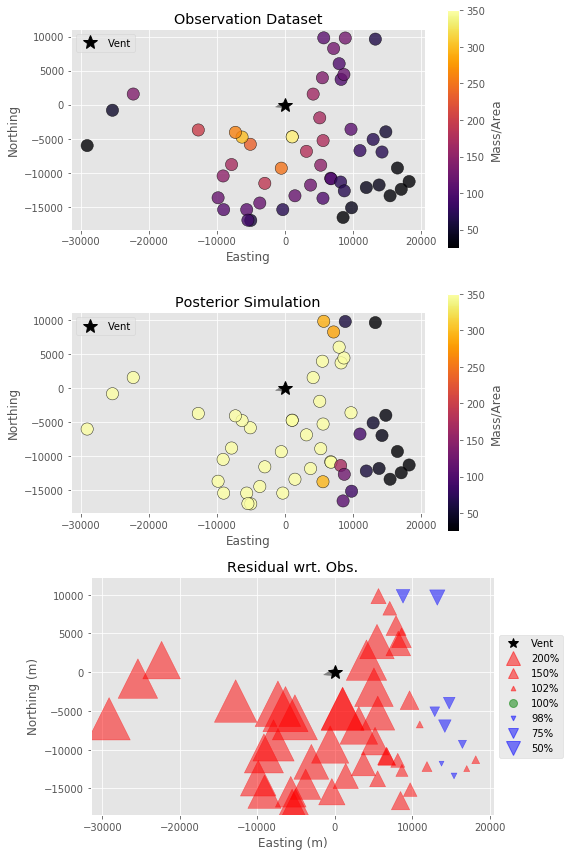

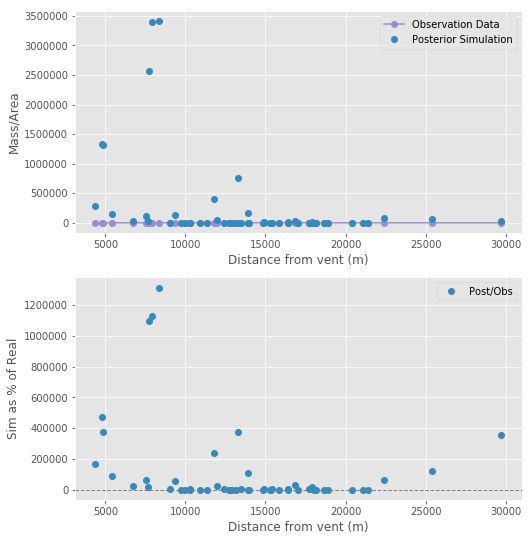

[0.13243669 0.16132092 0.1626316  0.16881614 0.18696809 0.1344063
 0.04610801 0.00731225]
[3.43436075e-01 3.06063583e-01 1.93748068e-01 1.09010481e-01
 3.90261954e-02 8.31332860e-03 3.47799530e-04 5.44705391e-05]
[-3.5, -2.5, -1.5, -0.5, 0.5, 1.5, 2.5, 3.5]


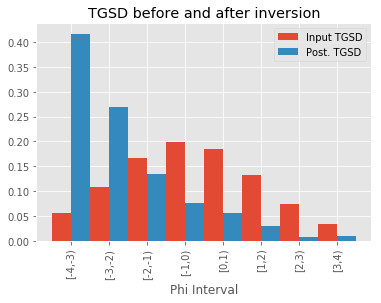

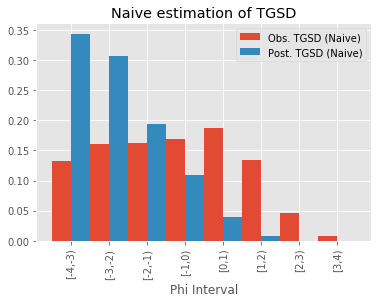

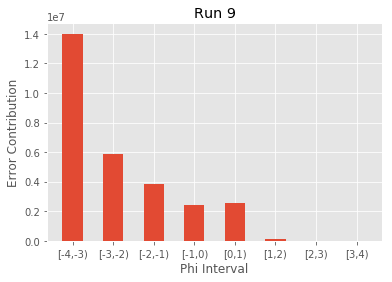

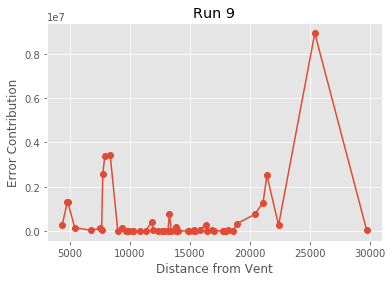

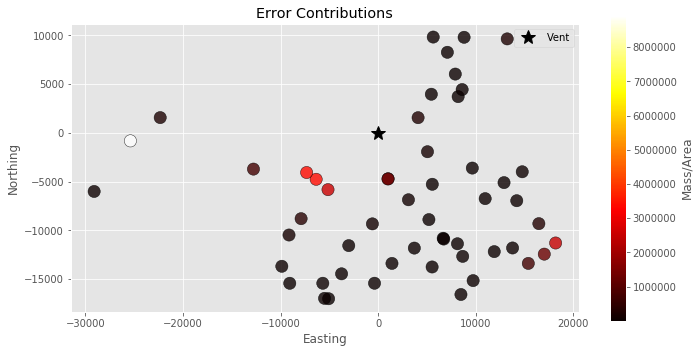

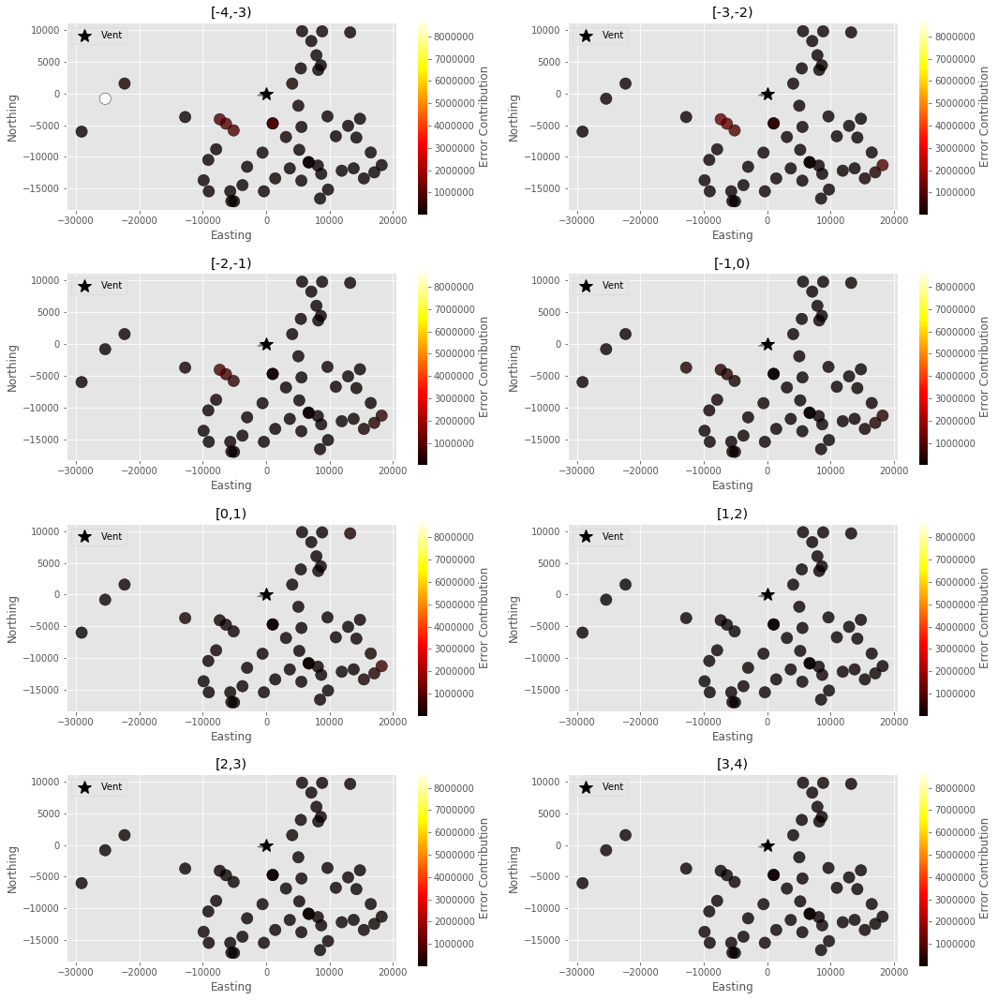

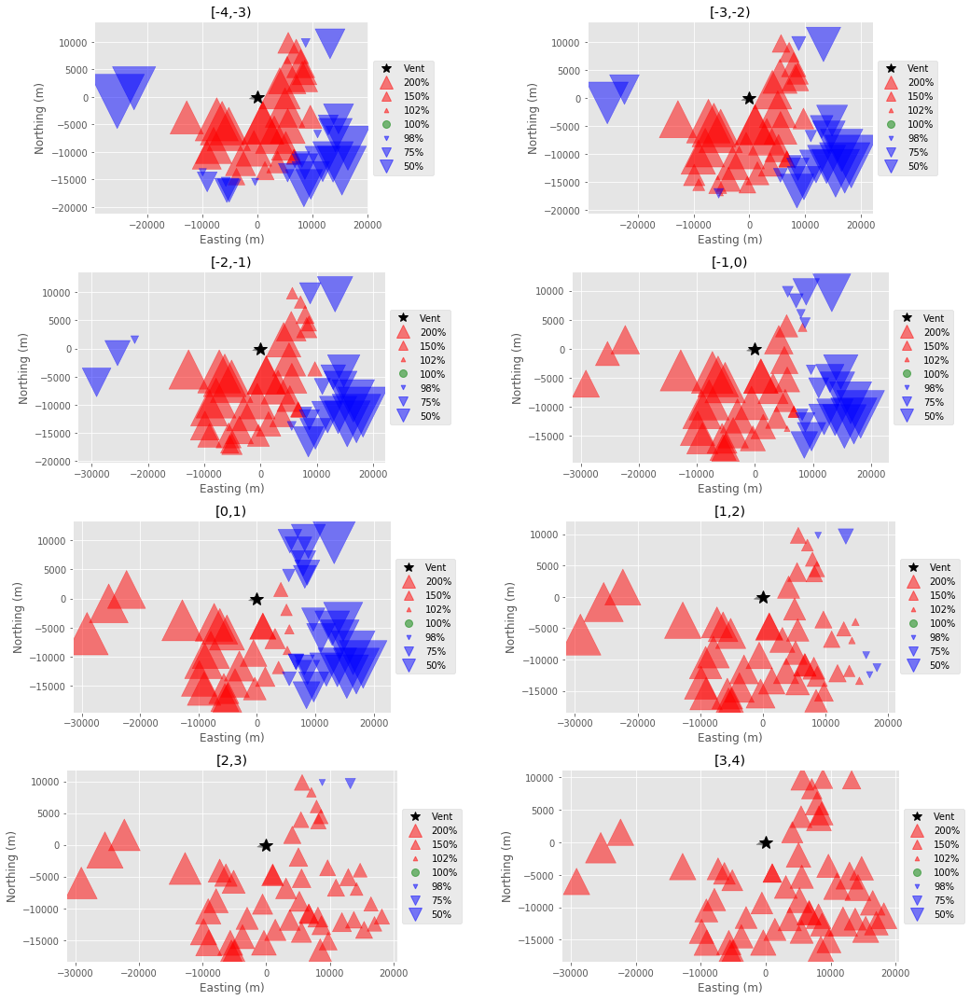

,D,M,a,b,ftt,h1,u,v
0,"4,000",7.48528e+14,606.844,1,"3,600","30,000",-5.53507,-1.28951


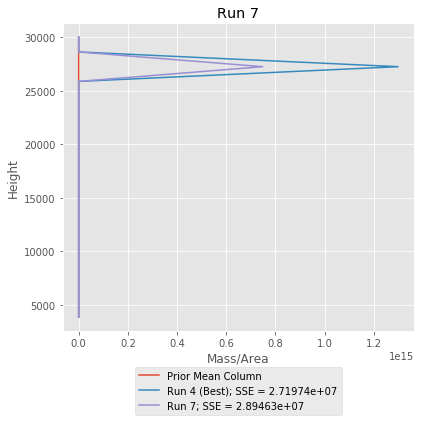

[0.4166347698781213, 0.26607769319617014, 0.11936495495321711, 0.06951117150415177, 0.04458677483290297, 0.039171669063371745, 0.029590951566869878, 0.01506201500519521]
0.4166347698781213
0.26607769319617014
0.11936495495321711
0.06951117150415177
0.04458677483290297
0.039171669063371745
0.029590951566869878
0.01506201500519521
[{'lower': -4, 'upper': -3.0, 'interval': '[-4,-3)', 'centroid': -3.5, 'density': 1024.0, 'probability': 0.4166347698781213}, {'lower': -3.0, 'upper': -2.0, 'interval': '[-3,-2)', 'centroid': -2.5, 'density': 1024.0, 'probability': 0.26607769319617014}, {'lower': -2.0, 'upper': -1.0, 'interval': '[-2,-1)', 'centroid': -1.5, 'density': 1024.0, 'probability': 0.11936495495321711}, {'lower': -1.0, 'upper': 0.0, 'interval': '[-1,0)', 'centroid': -0.5, 'density': 1024.0, 'probability': 0.06951117150415177}, {'lower': 0.0, 'upper': 1.0, 'interval': '[0,1)', 'centroid': 0.5, 'density': 1233.5, 'probability': 0.04458677483290297}, {'lower': 1.0, 'upper': 2.0, 'interval

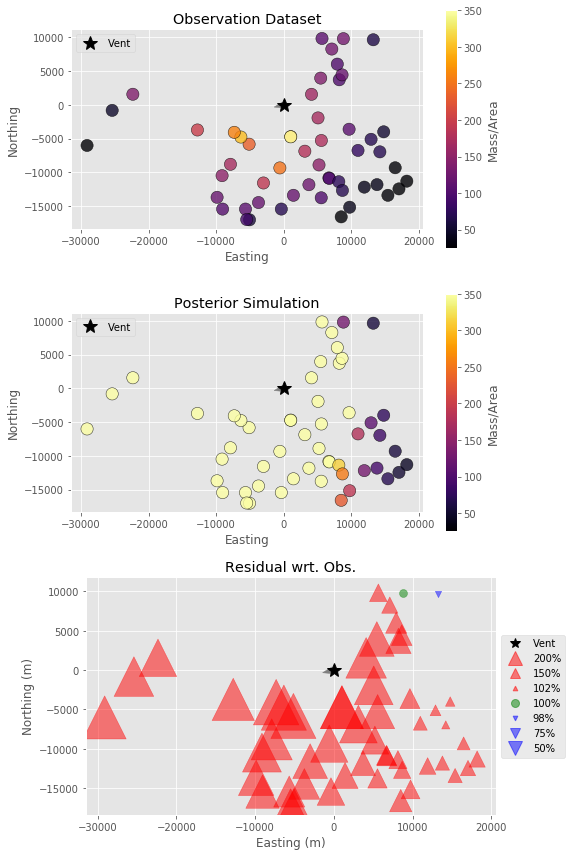

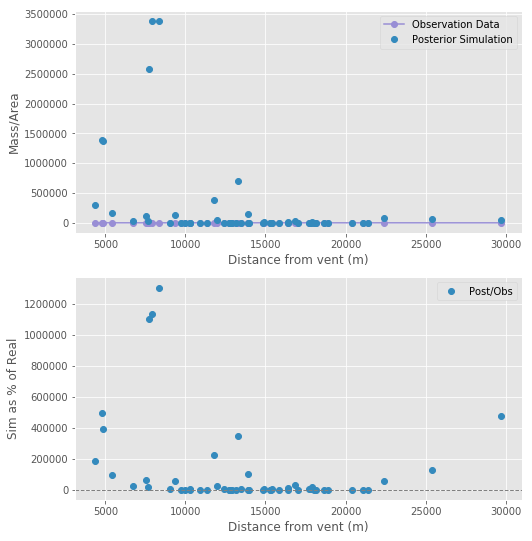

[0.13243669 0.16132092 0.1626316  0.16881614 0.18696809 0.1344063
 0.04610801 0.00731225]
[3.57768575e-01 3.14383193e-01 1.78385894e-01 1.03073649e-01
 3.28090408e-02 1.20676875e-02 1.41426487e-03 9.76951410e-05]
[-3.5, -2.5, -1.5, -0.5, 0.5, 1.5, 2.5, 3.5]


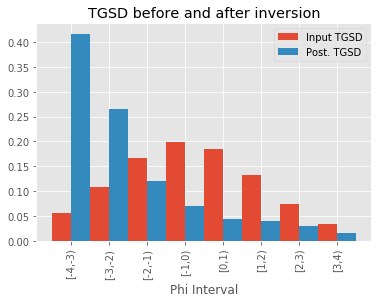

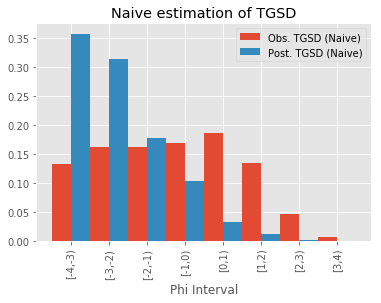

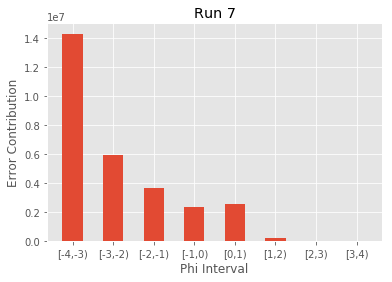

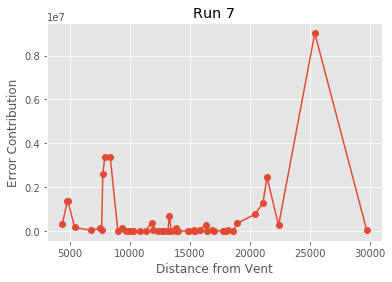

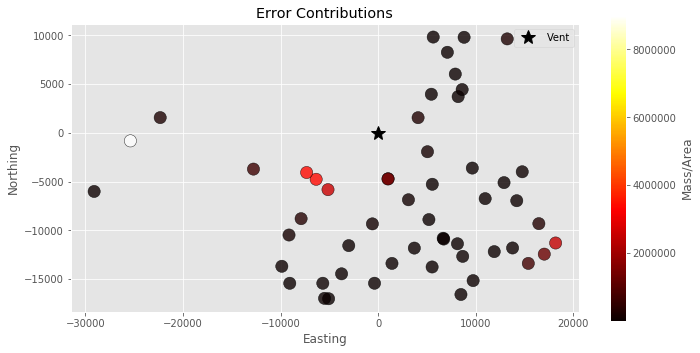

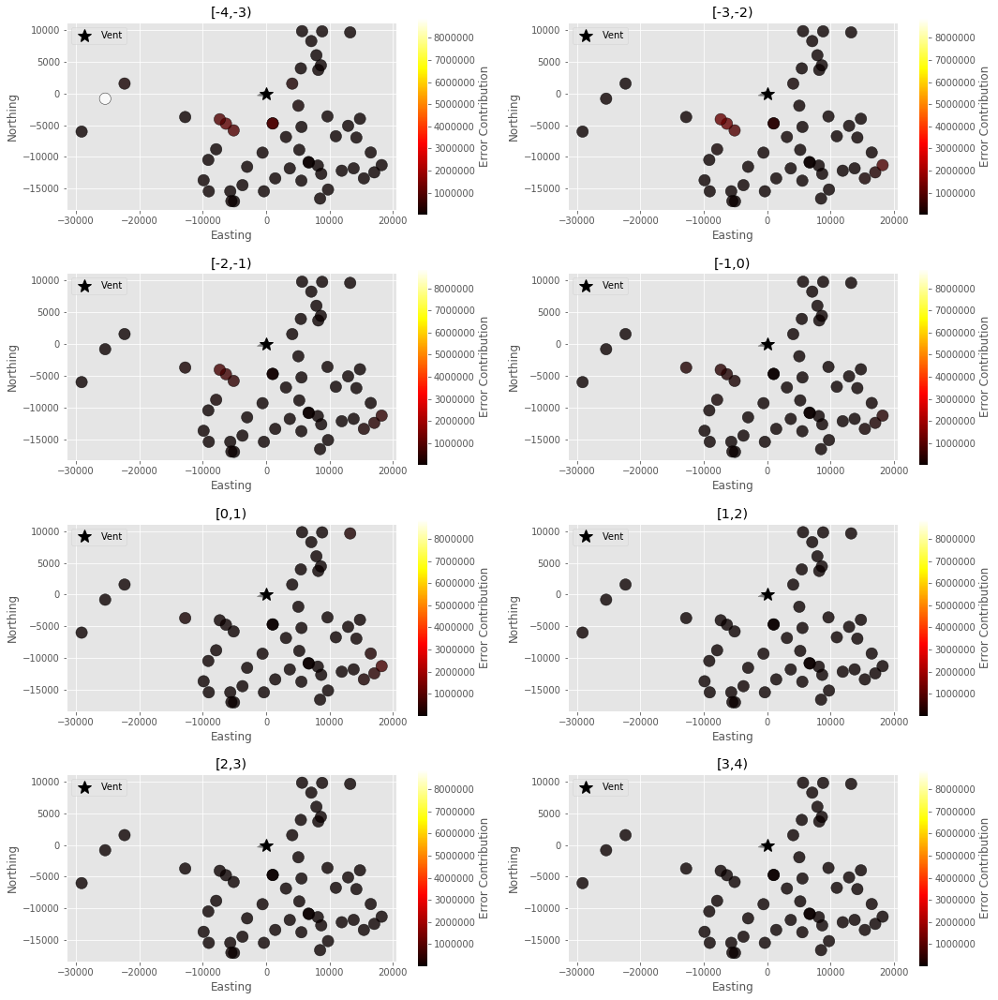

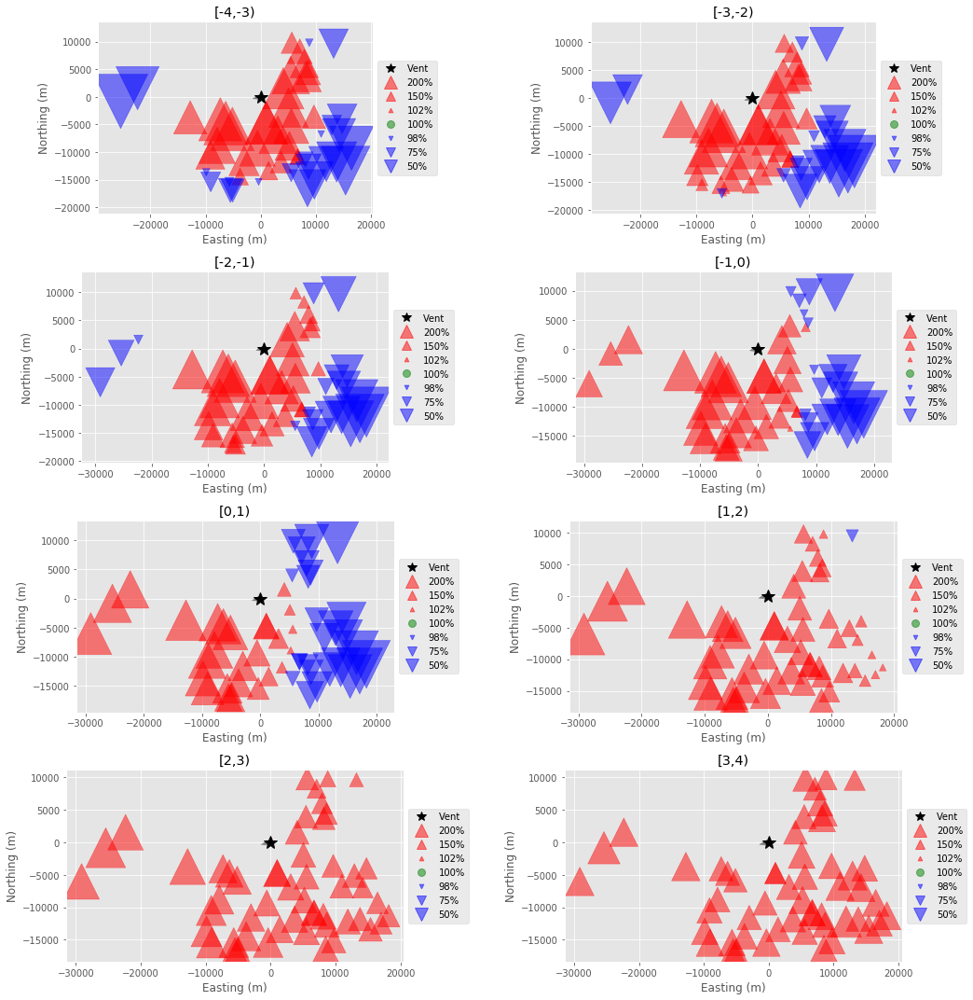

,D,M,a,b,ftt,h1,u,v
0,"4,000",7.22387e+14,392.052,1,"3,600","30,000",-5.71704,-1.38928


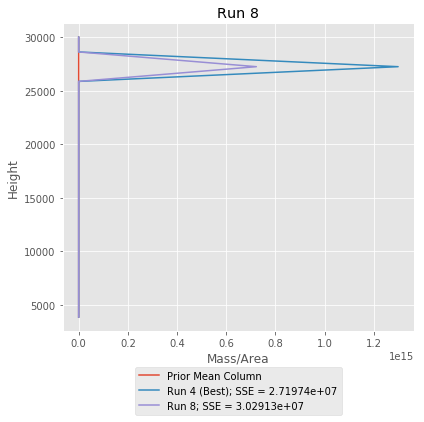

[0.3200654206834097, 0.2526045518176872, 0.1651489430874624, 0.11192567020729038, 0.08548361472862853, 0.042177914987492224, 0.015277723271872263, 0.0073161612161574095]
0.3200654206834097
0.2526045518176872
0.1651489430874624
0.11192567020729038
0.08548361472862853
0.042177914987492224
0.015277723271872263
0.0073161612161574095
[{'lower': -4, 'upper': -3.0, 'interval': '[-4,-3)', 'centroid': -3.5, 'density': 1024.0, 'probability': 0.3200654206834097}, {'lower': -3.0, 'upper': -2.0, 'interval': '[-3,-2)', 'centroid': -2.5, 'density': 1024.0, 'probability': 0.2526045518176872}, {'lower': -2.0, 'upper': -1.0, 'interval': '[-2,-1)', 'centroid': -1.5, 'density': 1024.0, 'probability': 0.1651489430874624}, {'lower': -1.0, 'upper': 0.0, 'interval': '[-1,0)', 'centroid': -0.5, 'density': 1024.0, 'probability': 0.11192567020729038}, {'lower': 0.0, 'upper': 1.0, 'interval': '[0,1)', 'centroid': 0.5, 'density': 1233.5, 'probability': 0.08548361472862853}, {'lower': 1.0, 'upper': 2.0, 'interval':

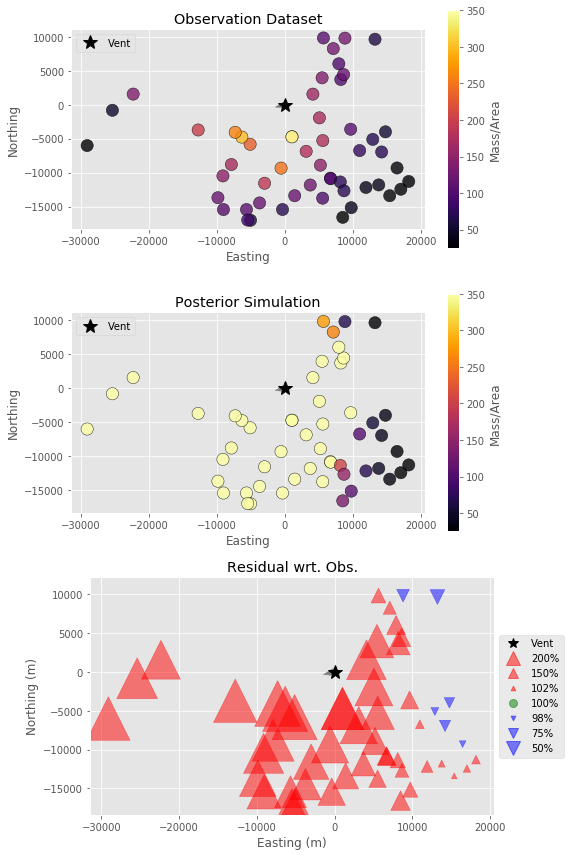

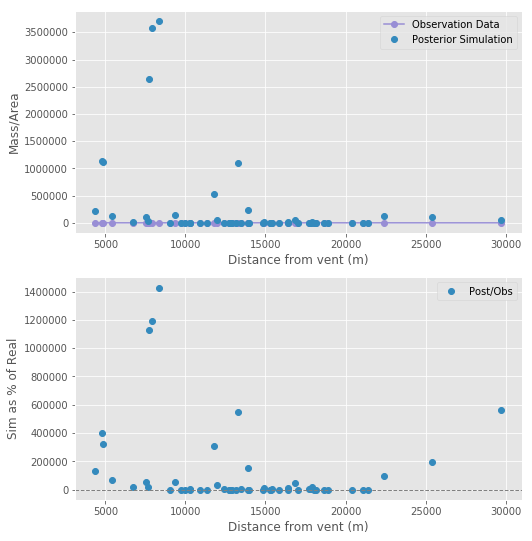

[0.13243669 0.16132092 0.1626316  0.16881614 0.18696809 0.1344063
 0.04610801 0.00731225]
[2.60087617e-01 2.85256624e-01 2.34797888e-01 1.53491908e-01
 5.48472972e-02 1.09203940e-02 5.61699446e-04 3.65723318e-05]
[-3.5, -2.5, -1.5, -0.5, 0.5, 1.5, 2.5, 3.5]


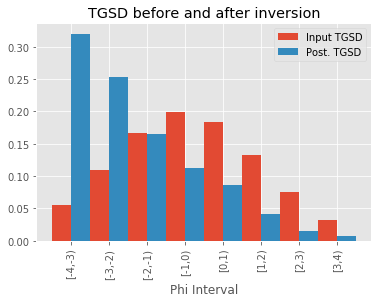

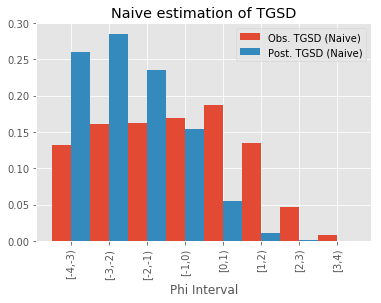

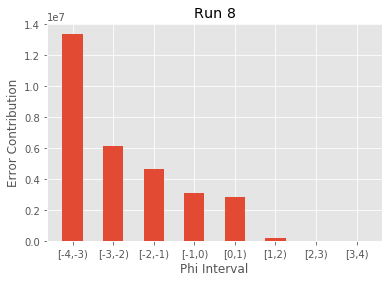

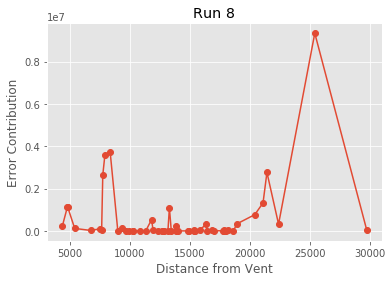

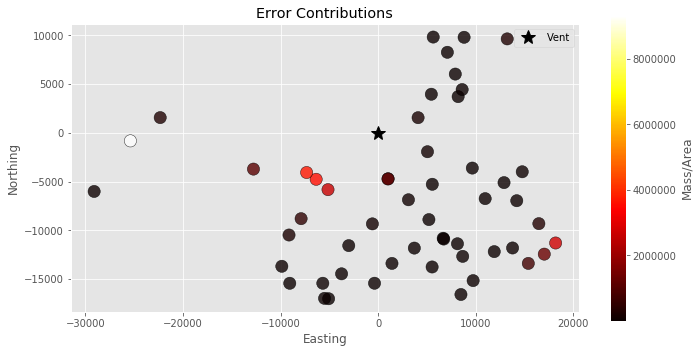

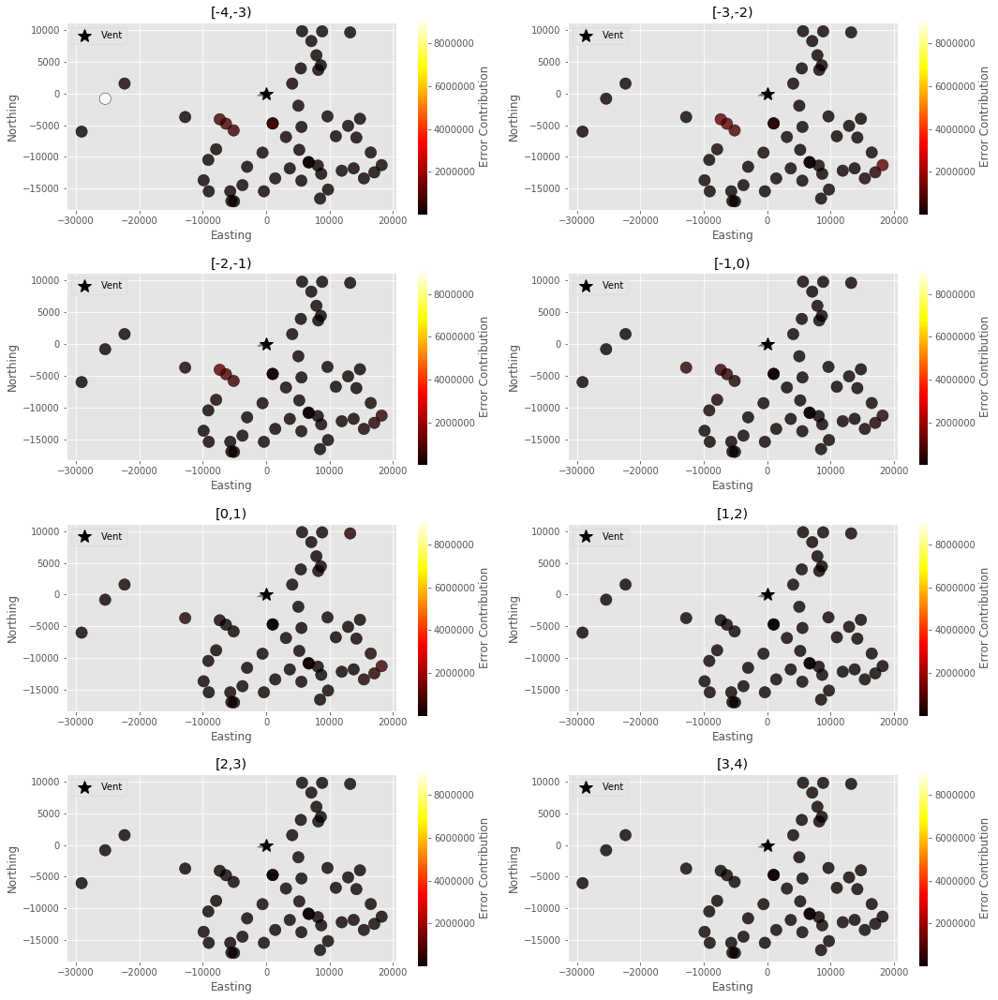

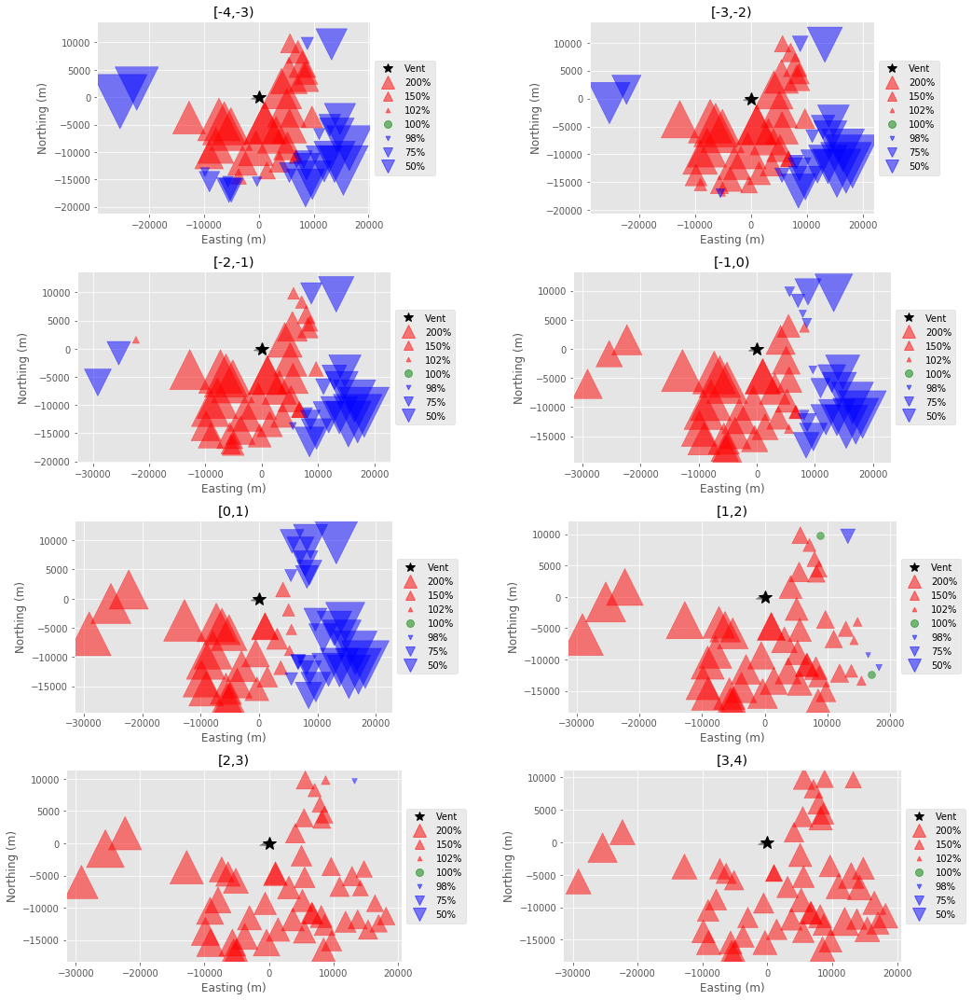

,D,M,a,b,ftt,h1,u,v
0,"4,000",9.14715e+14,588.316,1.01145,"3,600","29,986.3",-5.69983,-1.39102


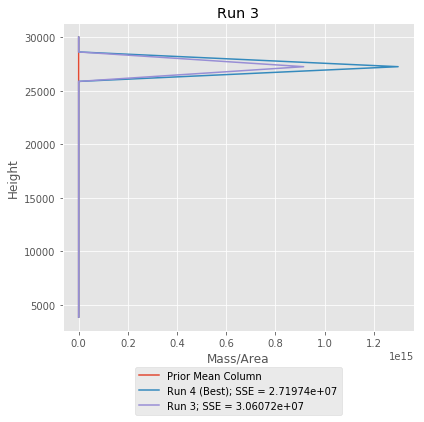

[0.25541691036704744, 0.21100923834549284, 0.12541186649942698, 0.08113809700189208, 0.059489694996320897, 0.0769257445991748, 0.08190761914493512, 0.10870082904570987]
0.25541691036704744
0.21100923834549284
0.12541186649942698
0.08113809700189208
0.059489694996320897
0.0769257445991748
0.08190761914493512
0.10870082904570987
[{'lower': -4, 'upper': -3.0, 'interval': '[-4,-3)', 'centroid': -3.5, 'density': 1024.0, 'probability': 0.25541691036704744}, {'lower': -3.0, 'upper': -2.0, 'interval': '[-3,-2)', 'centroid': -2.5, 'density': 1024.0, 'probability': 0.21100923834549284}, {'lower': -2.0, 'upper': -1.0, 'interval': '[-2,-1)', 'centroid': -1.5, 'density': 1024.0, 'probability': 0.12541186649942698}, {'lower': -1.0, 'upper': 0.0, 'interval': '[-1,0)', 'centroid': -0.5, 'density': 1024.0, 'probability': 0.08113809700189208}, {'lower': 0.0, 'upper': 1.0, 'interval': '[0,1)', 'centroid': 0.5, 'density': 1233.5, 'probability': 0.059489694996320897}, {'lower': 1.0, 'upper': 2.0, 'interval

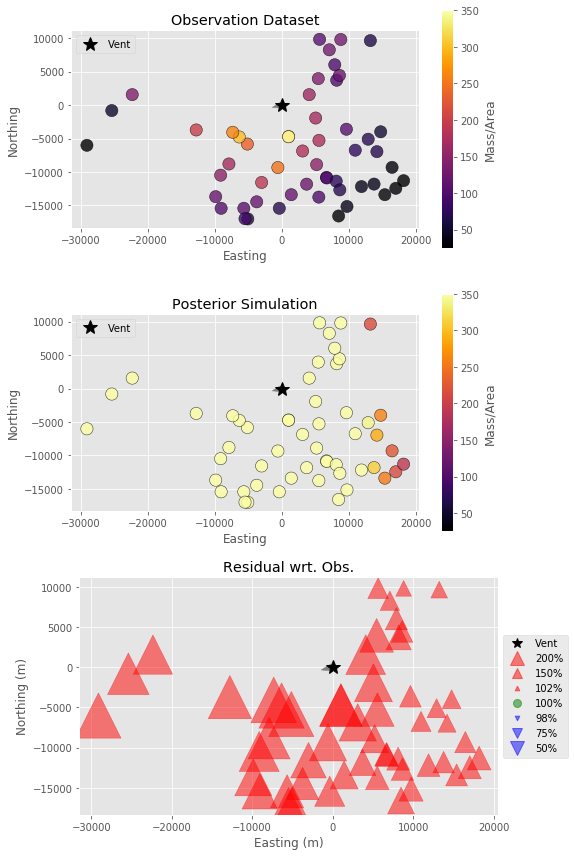

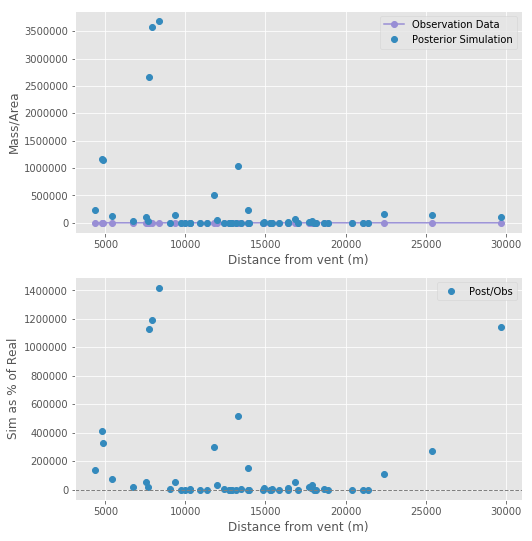

[0.13243669 0.16132092 0.1626316  0.16881614 0.18696809 0.1344063
 0.04610801 0.00731225]
[0.26006212 0.29852389 0.22359092 0.13994147 0.04816296 0.02518861
 0.00383804 0.00069199]
[-3.5, -2.5, -1.5, -0.5, 0.5, 1.5, 2.5, 3.5]


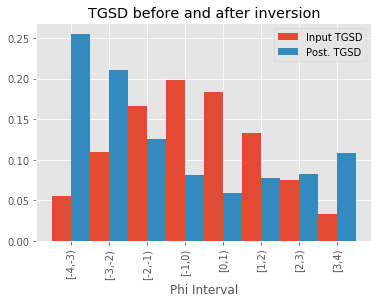

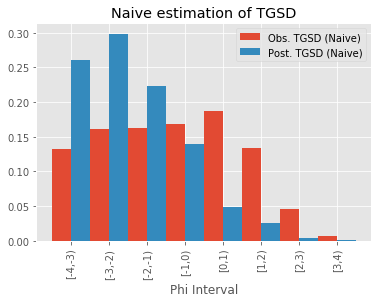

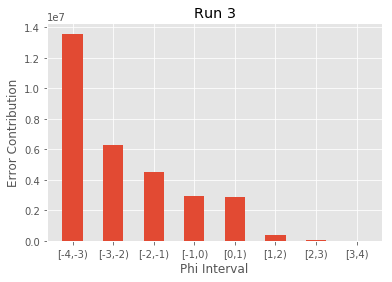

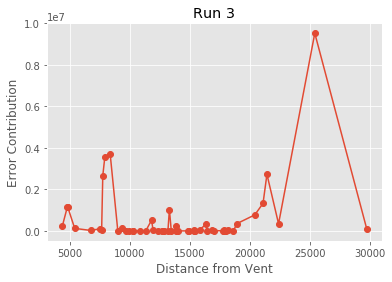

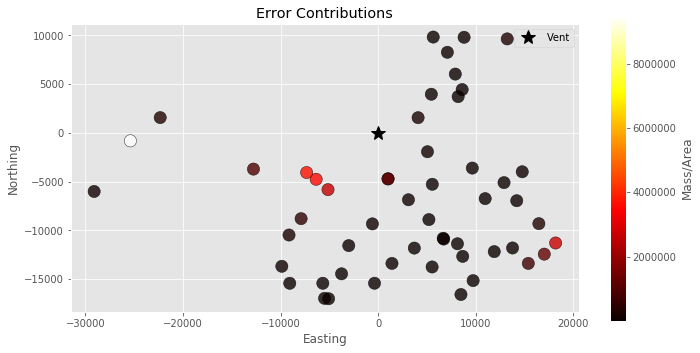

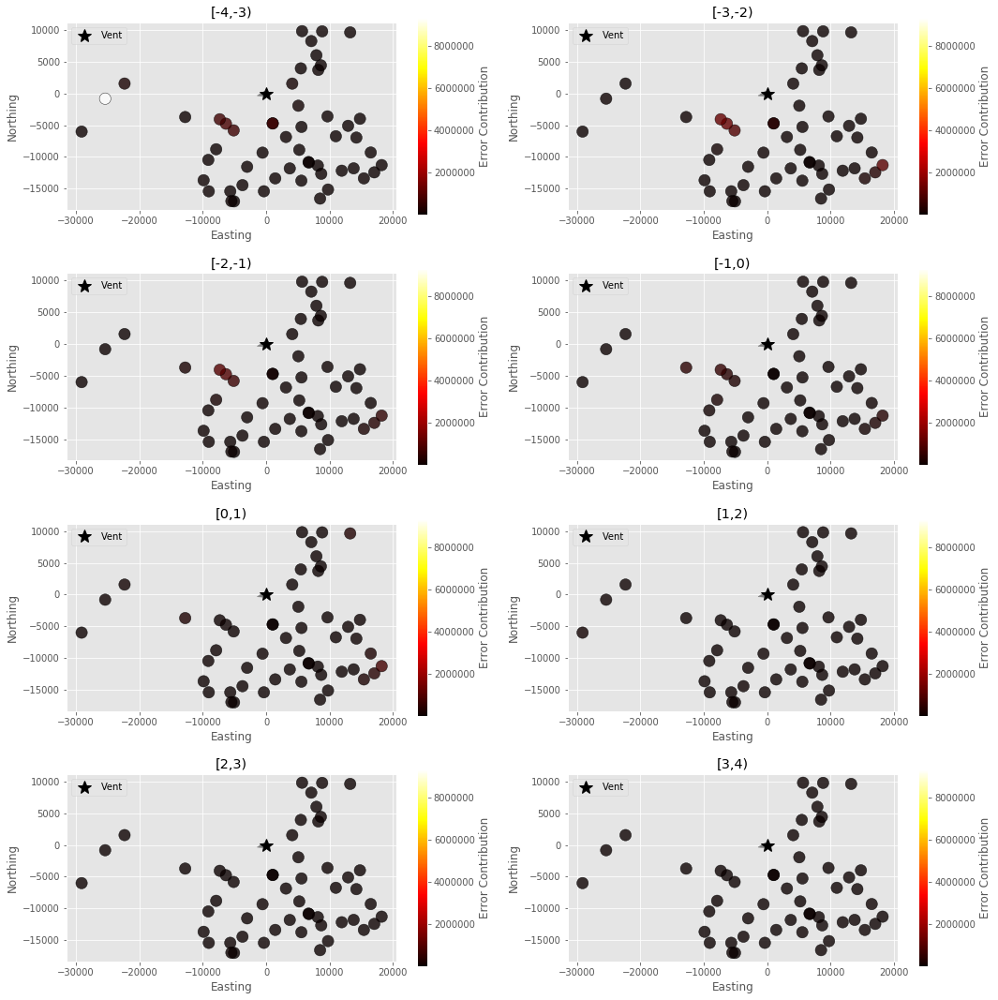

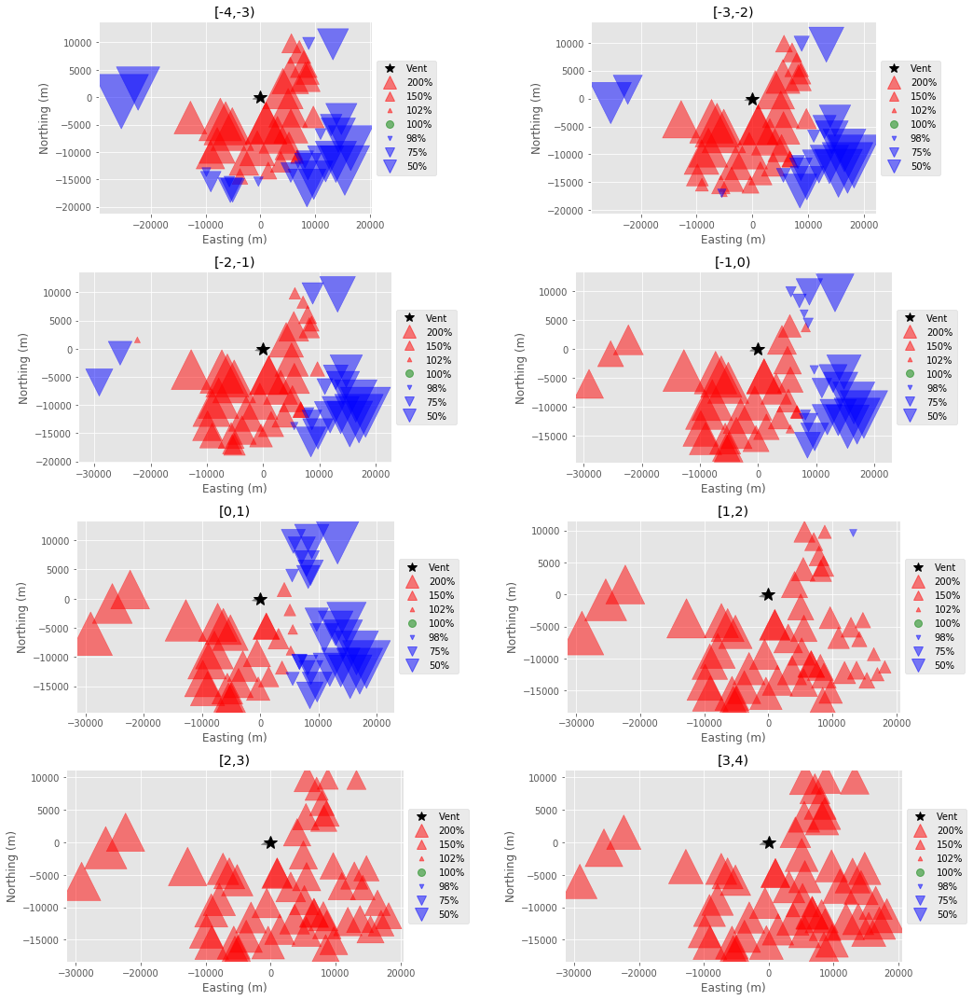

In [29]:
best = np.argsort(sse_list)
# q_mass = mass_dist_in_plume(config["ALPHA"],config["BETA"], config["VENT_ELEVATION"], 
#         config["PLUME_HEIGHT"],
#         heights,
#         config["ERUPTION_MASS"])

q_mass = beta_plume(config["ALPHA"],config["BETA"],config["PLUME_HEIGHT"],
                    config["ERUPTION_MASS"],
                    heights,
                    config["VENT_ELEVATION"], 
                    H)


fig, ax1 = plt.subplots(1,1, figsize=(6, 10), facecolor='w', edgecolor='k')

ax1.plot(inverted_masses_list[best[0]],
             heights, 
             '-', label="Run %d (Best); SSE = %g"%(best[0], sse_list[best[0]]))




for i in best[1:]:
    label = "Run %d; SSE = %g"%(i, sse_list[i])
    ax1.plot(inverted_masses_list[i],
             heights, 
             '-', label=label)
ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1))
ax1.set_title("All fits")
ax1.set_ylabel("Height")
ax1.set_xlabel("Mass/Area")
plt.tight_layout()
plt.show()

fig, ax1 = plt.subplots(1,1, figsize=(6, 6), facecolor='w', edgecolor='k')
ax1.plot(inverted_masses_list[best[0]],
             heights, 
             '-', label="Run %d (Best); SSE = %g"%(best[0], sse_list[best[0]]))
ax1.plot(q_mass, heights, label="Prior Mean Column")
ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1))
ax1.set_title("Best fit")
ax1.set_ylabel("Height")
ax1.set_xlabel("Mass/Area")
plt.tight_layout()
plt.show()

params_df = pd.DataFrame(params_list)
params_df["SSE"] = sse_list
params_df = params_df.sort_values("SSE")
params_df = params_df[["a", "b", "h1", "u", "v", "D", "ftt", "M", "SSE"]]
display(params_df)

for i in best:
    display(pd.DataFrame([params_list[i]]))
    
    fig, ax1 = plt.subplots(1,1, figsize=(6, 6), facecolor='w', edgecolor='k')
    ax1.plot(q_mass, heights, label="Prior Mean Column")
    ax1.plot(inverted_masses_list[best[0]],
             heights, 
             '-', label="Run %d (Best); SSE = %g"%(best[0], sse_list[best[0]]))
    label = "Run %d; SSE = %g"%(i, sse_list[i])
    ax1.plot(inverted_masses_list[i],
             heights, 
             '-', label=label)
    ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1))
    ax1.set_title("Run %d"%i)
    ax1.set_ylabel("Height")
    ax1.set_xlabel("Mass/Area")
    plt.tight_layout()
    plt.show()
    
    phi_new = phi_steps.copy()
    print(tgsd_list[i])
    for j, phi in enumerate(phi_new):
        print(tgsd_list[i][j])
        phi["probability"] = tgsd_list[i][j]
    print(phi_new)
    
    q_dist = beta(params_list[i]["a"],params_list[i]["b"])

    grid = data[["Easting", "Northing"]]

    post_df = gaussian_stack_forward(
        grid, int(config["COL_STEPS"]), config["VENT_ELEVATION"], 
        params_list[i]["h1"], 2500, phi_new, (params_list[i]["a"],params_list[i]["b"]), 
        params_list[i]["M"], 
        (params_list[i]["u"],params_list[i]["v"]), params_list[i]["D"], config["EDDY_CONST"],
        3600
    )
    
    post_df["radius"] = np.sqrt(post_df["Easting"]**2 + post_df["Northing"]**2)
    post_df = post_df.sort_values(by=['radius'])
    post_df["Residual"] = post_df["MassArea"].values/data["MassArea"].values
    
    fig, axs = plt.subplots(3,1, figsize=(
            8, 12), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    bounds = (25, 350)
    vis.plot_sample(data, vent=(0,0), log=False,bounds=bounds, 
                title="Observation Dataset", cbar_label="Mass/Area", ax=axs[0],
                   wind=(params_list[i]["u"]*20,params_list[i]["v"]*20))
    vis.plot_sample(post_df, vent=(0,0), log=False, bounds=bounds,
                title="Posterior Simulation", cbar_label="Mass/Area", ax=axs[1],
                   wind=(params_list[i]["u"]*20,params_list[i]["v"]*20))
    vis.plot_residuals(post_df, vent=(0,0), values="Residual", plot_type="size",
                title="Residual wrt. Obs.", ax=axs[2],
                       wind=(params_list[i]["u"]*20,params_list[i]["v"]*20))

    plt.tight_layout()
    plt.show()

    
        
    fig, axs = plt.subplots(2,1, figsize=(
            8, 9), facecolor='w', edgecolor='k')
    axs = axs.ravel()

    axs[0].plot(data["radius"].values, data["MassArea"].values, 'C2o-', label="Observation Data")
    axs[0].plot(post_df["radius"].values, post_df["MassArea"].values, 'C1o', label="Posterior Simulation")
    axs[0].legend()
    axs[0].set_xlabel("Distance from vent (m)")
    axs[0].set_ylabel("Mass/Area")


    axs[1].plot(post_df["radius"].values, post_df["Residual"].values*100, 'C1o', label="Post/Obs")
    axs[1].axhline(100, linestyle="--", lw=1, c="gray")  
    axs[1].legend()
    axs[1].set_xlabel("Distance from vent (m)")
    axs[1].set_ylabel("Sim as % of Real")
    plt.show()
    
    old_tgsd = [phi["probability"] for phi in phi_steps]
    x = [phi["centroid"] for phi in phi_new]
    labels = [phi["interval"] for phi in phi_new]
    
    obs_tgsd = get_tgsd(data, phi_new)
    post_tgsd = get_tgsd(post_df, phi_new)
    
    print(obs_tgsd)
    print(post_tgsd)
    print(x)
    
    
    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.bar([xx-0.25 for xx in x], probs, width=0.5, align="center", label="Input TGSD")
    ax.bar([xx+0.25 for xx in x], tgsd_list[i], width=0.5, align="center", label="Post. TGSD")
    ax.set_xticks(x)
    ax.set_xticklabels(labels, rotation=90)
    ax.set_xlabel("Phi Interval")
    plt.title("TGSD before and after inversion")
    plt.legend()
    
    plt.show()
    
    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.bar([xx-0.25 for xx in x], obs_tgsd, width=0.5, align="center", label="Obs. TGSD (Naive)")
    ax.bar([xx+0.25 for xx in x], post_tgsd, width=0.5, align="center", label="Post. TGSD (Naive)")
    ax.set_xticks(x)
    ax.set_xticklabels(labels, rotation=90)
    ax.set_xlabel("Phi Interval")
    plt.title("Naive estimation of TGSD")
    plt.legend()
    
    plt.show()

    sse, contributions, setup = get_error_contributions(
        data, len(data), 20, 
        config["VENT_ELEVATION"], H, 2500, phi_steps, 
        params_list[i], column_cap = H, )
    
    
#     fig, axs = plt.subplots(2,2, figsize=(
#             12, 8), facecolor='w', edgecolor='k')
#     axs = axs.ravel()
    
#     for j, stp in enumerate(setup):
#         fall_times = stp[7]
#         fall_time_adj = stp[11]
#         heights = stp[4]
#         print(fall_times)
#         print(fall_time_adj)
#         print(heights)
#         axs[0].semilogx([f + fall_time_adj for f in fall_times], heights, label=phi_steps[j]["interval"])
# #         axs[1].plot(fall_time_adj, heights)\
#     axs[0].legend()
#     axs[0].set_ylabel("Height (m)")
#     axs[0].set_xlabel("Fall time (s)")
#     plt.show()
    
    point_contributions = np.sum(contributions, 0)
    phi_contributions = np.sum(contributions, 1)
    
    
    

    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.bar(x, phi_contributions, width=0.5, align="center")
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    plt.xlabel("Phi Interval")
    plt.ylabel("Error Contribution")
    plt.title("Run %d"%i)
    plt.show()

    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.plot(data["radius"], point_contributions, "C0o-")
    plt.xlabel("Distance from Vent")
    plt.ylabel("Error Contribution")
    plt.title("Run %d"%i)
    plt.show()
    
    data["Contributions"] = point_contributions
    fig, ax = plt.subplots(1, 1, figsize=(10,5), facecolor='w', edgecolor='k')

    vis.plot_sample(data, vent=(0,0), log=False, values="Contributions",
                title="Error Contributions", cbar_label="Mass/Area", ax = ax, cmap="hot")
    plt.tight_layout()
    plt.show()
#      bounds=(min(min(contributions)),max(max(contributions))),

    fig, axs = plt.subplots(4,2, figsize=(15,15), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    for j, phi_cont in enumerate(phi_contributions):
        data["Contributions"] = contributions[j]
#         display(data[["Contributions", "MassArea"]])
        vis.plot_sample(data, vent=(0,0), log=False, values="Contributions", 
                        bounds=(min(min(contributions)),max(max(contributions))),
                        title=phi_new[j]["interval"], cbar_label="Error Contribution", 
                        ax = axs[j], cmap="hot", 
                        wind=(params_list[i]["u"]*20,params_list[i]["v"]*20))
    plt.tight_layout()
    plt.show()

    
    fig, axs = plt.subplots(4, 2, figsize=(15,15), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    for j, phi_step in enumerate(phi_new):
        post_df["mass_res"] = (post_df["MassArea"].values*(post_df[phi_step["interval"]].values/100))/\
                             (data["MassArea"].values*(data[phi_step["interval"]].values/100))
        vis.plot_residuals(post_df, vent=(0,0), values="mass_res", plot_type="size",
                        title=phi_steps[j]["interval"],  
                        ax = axs[j]
                          , wind=(params_list[i]["u"]*20,params_list[i]["v"]*20))
    plt.tight_layout()
    plt.show()
    


In [53]:
for i in best:
    display(pd.DataFrame([priors_list[i], params_list[i]], index=["Priors", "Posteriors"]).T)
    
params_df = pd.DataFrame(params_list)
params_df["SSE"] = sse_list
params_df = params_df.sort_values("SSE")
params_df = params_df[["a", "b", "h1", "u", "v", "D", "ftt", "M", "SSE"]]
display(params_df)

,Priors,Posteriors
D,"35,489.7","73,567.2"
M,2.5e+11,2.5e+11
a,3.35575,1.69857
b,2.56848,1.27925
ftt,"3,600","3,600"
h1,"31,123.1","42,982.7"
u,0.000298855,-1.35956
v,0.0004808,-0.377603


,Priors,Posteriors
D,"232,570","73,749.7"
M,2.5e+11,2.5e+11
a,1.34646,1.72436
b,3.8172,1.28002
ftt,"3,600","3,600"
h1,"10,793.8","42,968.6"
u,0.000875052,-1.21008
v,0.000932623,-0.658801


,Priors,Posteriors
D,"37,150.6","73,971.3"
M,2.5e+11,2.5e+11
a,1.28936,1.65204
b,1.48306,1.18717
ftt,"3,600","3,600"
h1,"20,114.9","41,336.4"
u,-0.000612916,-1.42932
v,6.3282e-05,-0.0527631


,Priors,Posteriors
D,"39,643.9","73,853.5"
M,2.5e+11,2.5e+11
a,2.52288,1.66819
b,1.23431,1.28011
ftt,"3,600","3,600"
h1,"28,574.4","42,995.2"
u,0.000490688,-1.42522
v,0.00031642,-0.0116472


,Priors,Posteriors
D,"23,230.2","74,651.7"
M,2.5e+11,2.5e+11
a,6.42523,1.76158
b,3.6926,1.1477
ftt,"3,600","3,600"
h1,"13,891.7","39,905.6"
u,0.000374073,-1.09512
v,-0.00145362,-0.813661


,Priors,Posteriors
D,"59,294.7","74,670.4"
M,2.5e+11,2.5e+11
a,1.88963,1.63313
b,1.82174,1.19388
ftt,"3,600","3,600"
h1,"14,050","41,394.3"
u,-0.00107537,-1.36689
v,-2.75719e-05,0.291588


,Priors,Posteriors
D,"116,976","74,524.5"
M,2.5e+11,2.5e+11
a,1.31773,1.65247
b,1.7845,1.28607
ftt,"3,600","3,600"
h1,"19,274","43,007.6"
u,0.00119914,-1.35793
v,5.77549e-05,0.301964


,Priors,Posteriors
D,"163,704","75,942"
M,2.5e+11,2.5e+11
a,4.48697,1.77493
b,2.59043,1.19644
ftt,"3,600","3,600"
h1,"33,966.2","41,010.2"
u,0.00145007,-0.523873
v,-0.00069531,-1.14386


,Priors,Posteriors
D,"45,988.6","76,169.5"
M,2.5e+11,2.5e+11
a,1.78638,1.78846
b,2.19711,1.21255
ftt,"3,600","3,600"
h1,"22,205.8","41,059.2"
u,0.000870552,-0.472606
v,-0.000908088,-1.15566


,Priors,Posteriors
D,"228,484","76,835.7"
M,2.5e+11,2.5e+11
a,2.19098,1.69442
b,1.30649,1.31004
ftt,"3,600","3,600"
h1,"43,554.7","43,038"
u,-2.46561e-06,-0.696164
v,-0.000772026,0.673961


,Priors,Posteriors
D,"131,176","77,790.9"
M,2.5e+11,2.5e+11
a,8.81113,1.86249
b,1.59637,1.36469
ftt,"3,600","3,600"
h1,"17,669.6","42,966.7"
u,0.00178223,0.00797205
v,-2.21237e-05,-0.974792


,Priors,Posteriors
D,"58,288.5","77,927.2"
M,2.5e+11,2.5e+11
a,1.83478,1.86355
b,2.85579,1.36236
ftt,"3,600","3,600"
h1,"38,737.6","42,978.6"
u,-0.000247022,0.0584007
v,-0.000405517,-0.879043


,Priors,Posteriors
D,"470,601","78,090.5"
M,2.5e+11,2.5e+11
a,1.28186,1.82921
b,1.97874,1.23997
ftt,"3,600","3,600"
h1,"28,621.6","41,206.4"
u,0.00212011,0.0768985
v,0.00133905,-0.834617


,Priors,Posteriors
D,"16,297.8","78,873.4"
M,2.5e+11,2.5e+11
a,2.03777,1.49303
b,2.30323,1.15199
ftt,"3,600","3,600"
h1,"28,810.8","42,992.1"
u,0.00244871,-0.176356
v,-0.000330777,0.003096


,Priors,Posteriors
D,"14,997.2","78,112.1"
M,2.5e+11,2.5e+11
a,8.79253,1.8085
b,1.20254,1.2115
ftt,"3,600","3,600"
h1,"17,762.5","41,156.7"
u,3.17136e-05,0.109658
v,-0.000171359,-0.572626


,Priors,Posteriors
D,"23,194.8","78,028.4"
M,2.5e+11,2.5e+11
a,3.11986,1.80245
b,1.38445,1.24665
ftt,"3,600","3,600"
h1,"25,873.5","41,751"
u,0.000453458,-0.0019016
v,0.000808002,-0.0126663


,Priors,Posteriors
D,"179,937","78,066"
M,2.5e+11,2.5e+11
a,1.47838,1.80808
b,1.51642,1.25271
ftt,"3,600","3,600"
h1,"19,471.2","41,707.9"
u,0.000859072,-0.000471267
v,0.0002466,-0.0114755


,Priors,Posteriors
D,"14,680.7","78,037.5"
M,2.5e+11,2.5e+11
a,2.05984,1.78832
b,3.17765,1.22137
ftt,"3,600","3,600"
h1,"36,975.1","41,388.9"
u,0.000919679,-1.831e-05
v,0.000202694,-0.000453887


,Priors,Posteriors
D,"50,906.7","78,083.5"
M,2.5e+11,2.5e+11
a,1.54518,1.83916
b,4.37526,1.36305
ftt,"3,600","3,600"
h1,"9,104.84","43,059.3"
u,0.000188269,0.0132035
v,-0.000765138,0.00775291


,Priors,Posteriors
D,"298,934","81,023.2"
M,2.5e+11,2.5e+11
a,1.39665,2.14333
b,1.77527,1.02122
ftt,"3,600","3,600"
h1,"22,580.4","30,207.1"
u,-2.17758e-05,0.00246083
v,0.00133286,-0.077304


,a,b,h1,u,v,D,ftt,M,SSE
8,1.69857,1.27925,"42,982.7",-1.35956,-0.377603,"73,567.2","3,600",2.5e+11,454.401
15,1.72436,1.28002,"42,968.6",-1.21008,-0.658801,"73,749.7","3,600",2.5e+11,456.11
6,1.65204,1.18717,"41,336.4",-1.42932,-0.0527631,"73,971.3","3,600",2.5e+11,456.623
5,1.66819,1.28011,"42,995.2",-1.42522,-0.0116472,"73,853.5","3,600",2.5e+11,457.33
17,1.76158,1.1477,"39,905.6",-1.09512,-0.813661,"74,651.7","3,600",2.5e+11,459.079
14,1.63313,1.19388,"41,394.3",-1.36689,0.291588,"74,670.4","3,600",2.5e+11,464.364
16,1.65247,1.28607,"43,007.6",-1.35793,0.301964,"74,524.5","3,600",2.5e+11,464.799
4,1.77493,1.19644,"41,010.2",-0.523873,-1.14386,"75,942","3,600",2.5e+11,476.018
13,1.78846,1.21255,"41,059.2",-0.472606,-1.15566,"76,169.5","3,600",2.5e+11,477.948
9,1.69442,1.31004,"43,038",-0.696164,0.673961,"76,835.7","3,600",2.5e+11,496.944


,invert,sample_function,value
D,True,<function uninformed at 0x000001817DE39C80>,"[4000, 100000]"
ftt,False,<function uninformed at 0x000001817DE39C80>,"[3600, 10000]"
a,False,<function uninformed at 0x000001817DE39C80>,"[2, 5]"
b,False,<function uninformed at 0x000001817DE39C80>,"[2, 5]"
h1,True,<function uninformed at 0x000001817DE39C80>,"[5000, 29999]"
u,True,<function uninformed at 0x000001817DE39C80>,"[-10, 10]"
v,True,<function uninformed at 0x000001817DE39C80>,"[-10, 10]"
M,False,<function lognorm at 0x000001817DFE9E18>,[250000000000.0]


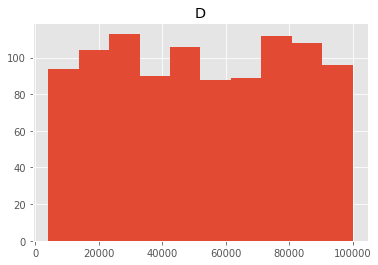

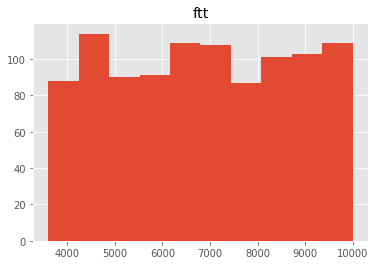

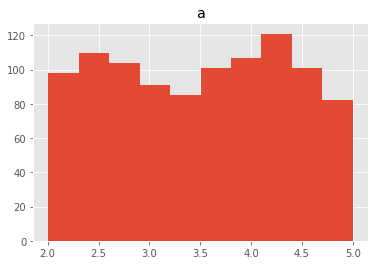

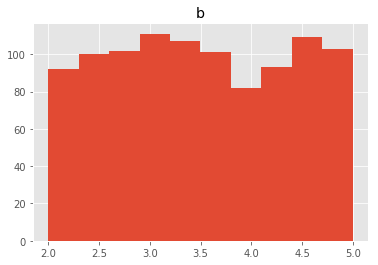

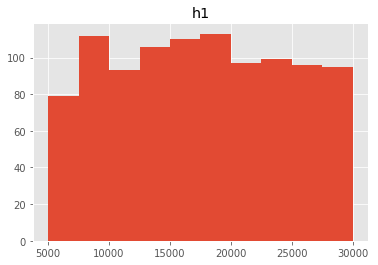

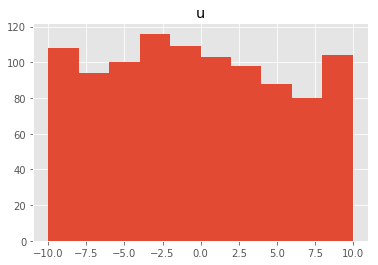

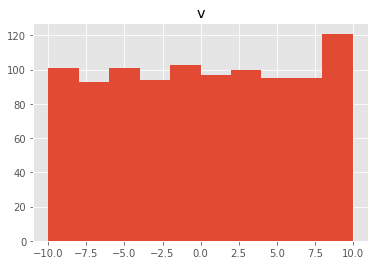

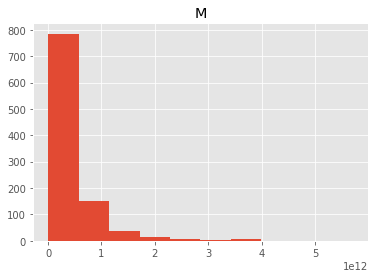

In [38]:
param_config = {
    "D": {
        "value":[4000, 100000],
        "invert":True,
        "sample_function": uninformed
    },
    "ftt": {
        "value":[3600, 10000],
        "invert":False,
        "sample_function": uninformed
    },
    "a": {
        "value":[2, 5],
        "invert":False,
        "sample_function": uninformed
    },
    "b": {
        "value":[2, 5],
        "invert":False,
        "sample_function": uninformed
    },
    "h1": {
        "value":[5000, 29999],
        "invert":True,
        "sample_function": uninformed
    },
    "u": {
        "value":[-10, 10],
        "invert":True,
        "sample_function": uninformed
    },
    "v": {
        "value":[-10, 10],
        "invert":True,
        "sample_function": uninformed
    },
    "M": {
        "value":[config["ERUPTION_MASS"]],
        "invert":False,
        "sample_function": lognorm
    }
}
param_config_df = pd.DataFrame(param_config)
display(param_config_df.T)

for key, val in param_config.items():
    x = [val["sample_function"](*val["value"]) for i in range(1000)]
    plt.hist(x)
    plt.title(key)
    plt.show()



In [39]:
log="verb"
data = obs_df
iterations = 20
########################################################

out = gaussian_stack_multi_run(
    obs_df, len(data), 20, 
    config["VENT_ELEVATION"], 
    H, 0, phi_steps, param_config, runs=iterations, column_cap = H, pre_samples=20
)

inverted_masses_list, sse_list, params_list, priors_list, heights = out

Run 0===========================================================================


C:\Users\nmostert\Documents\repos\inversion_project\utils.py:431: RuntimeWarning: invalid value encountered in true_divide
  ret = (plume/sum(plume))*tot_mass


a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00009	v* = -0.00025	            D* = 14.19720	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00009	v = -0.00025	            D = 1464750.83163	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 326
SSE: 2.7813384783897366e+20
Prior SSE: 2.95897e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"16,383.8",1.46475e+06
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"22,071.8","4,625"
u,-5.60192,9.39549e-05
v,-5.09931,-0.000247196


Run 1 Time: 3.098 minutes


Estimated remaining run time: 27.881 minutes


Run 1===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00009	v* = -0.00025	            D* = 17.60023	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00009	v = -0.00025	            D = 44023342.92939	ftt = 3600.00000	TM = 249999999999.99973
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 452
SSE: 2.781338478390512e+20
DID NOT CONVERGE


,Priors,Posteriors
D,"70,951.5",4.40233e+07
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"16,384.3","4,625"
u,3.09077,9.38498e-05
v,-6.29089,-0.000247665


Prior SSE: 3.03671e+20,	 Post SSE: 2.78134e+20
Run 1 Time: 3.098 minutes


Estimated remaining run time: 65.093 minutes


Run 1===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.74547	u* = 0.04390	v* = -0.34367	            D* = 24.11634	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 5469.76765	u = 0.04390	v = -0.34367	            D = 29757189947.26457	ftt = 3600.00000	TM = 249999999999.99973
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 475
SSE: 2.7816237223706637e+20
DID NOT CONVERGE


,Priors,Posteriors
D,"91,801",2.97572e+10
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"27,603.7","5,469.77"
u,9.13047,0.0439002
v,-8.73971,-0.343668


Prior SSE: 2.821e+20,	 Post SSE: 2.78162e+20
Run 1 Time: 3.098 minutes


Estimated remaining run time: 102.356 minutes


Run 1===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = -0.00029	v* = 0.00014	            D* = 9.06700	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00008	u = -0.00029	v = 0.00014	            D = 8664.61875	ftt = 3600.00000	TM = 249999999999.99973
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 466
SSE: 2.7813384880225445e+20
DID NOT CONVERGE


,Priors,Posteriors
D,"22,771.3","8,664.62"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"22,287.6","4,625"
u,1.13024,-0.000294666
v,-4.84715,0.000138673


Prior SSE: 2.90209e+20,	 Post SSE: 2.78134e+20
Run 1 Time: 3.098 minutes


Estimated remaining run time: 138.928 minutes


Run 1===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00009	v* = -0.00025	            D* = 13.71708	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00009	v = -0.00025	            D = 906261.58538	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 436
SSE: 2.781338478389738e+20
Prior SSE: 2.95919e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"40,189.2","906,262"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"16,345","4,625"
u,9.72445,9.45087e-05
v,-2.8959,-0.000246848


Run 2 Time: 3.634 minutes


Estimated remaining run time: 108.068 minutes


Run 2===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = -0.00843	v* = 0.00017	            D* = 25.53851	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = -0.00843	v = 0.00017	            D = 123377538916.96564	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 424
SSE: 2.7813444645045843e+20
Prior SSE: 2.90977e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"99,434.1",1.23378e+11
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"11,326","4,625"
u,4.20048,-0.00842903
v,-4.88472,0.000174049


Run 3 Time: 4.001 minutes


Estimated remaining run time: 92.286 minutes


Run 3===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00009	v* = -0.00025	            D* = 21.19533	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00009	v = -0.00025	            D = 1603292834.84586	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 333
SSE: 2.7813384793728755e+20
Prior SSE: 2.8875e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"44,220.5",1.60329e+09
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"22,433.1","4,625"
u,-7.24196,9.35897e-05
v,-9.84392,-0.000245798


Run 4 Time: 3.238 minutes


Estimated remaining run time: 78.928 minutes


Run 4===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.64062	u* = -1.30503	v* = -0.04440	            D* = 11.97828	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 6746.33894	u = -1.30503	v = -0.04440	            D = 159258.60818	ftt = 3600.00000	TM = 249999999999.99973
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 469
SSE: 2.7853776353541528e+20
DID NOT CONVERGE


,Priors,Posteriors
D,"66,868.4","159,259"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"23,490.4","6,746.34"
u,-7.11464,-1.30503
v,-0.119235,-0.044402


Prior SSE: 2.88462e+20,	 Post SSE: 2.78538e+20
Run 4 Time: 3.238 minutes


Estimated remaining run time: 91.620 minutes


Run 4===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.64023	u* = 0.08656	v* = 0.58395	            D* = 27.15139	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 6751.42311	u = 0.08656	v = 0.58395	            D = 619013622196.85962	ftt = 3600.00000	TM = 249999999999.99973
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 487
SSE: 2.78686664173125e+20
DID NOT CONVERGE


,Priors,Posteriors
D,"26,208.3",6.19014e+11
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"18,959.8","6,751.42"
u,6.19586,0.0865586
v,4.51353,0.583948


Prior SSE: 4.37943e+20,	 Post SSE: 2.78687e+20
Run 4 Time: 3.238 minutes


Estimated remaining run time: 103.720 minutes


Run 4===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00015	v* = -0.00035	            D* = 23.41368	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00015	v = -0.00035	            D = 14737721475.69694	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 271
SSE: 2.7813385613935886e+20
Prior SSE: 2.86296e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"13,265.8",1.47377e+10
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"25,444.8","4,625"
u,-5.80706,0.00015403
v,-2.07718,-0.000352736


Run 5 Time: 2.528 minutes


Estimated remaining run time: 86.571 minutes


Run 5===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00009	v* = -0.00026	            D* = 9.36581	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00009	v = -0.00026	            D = 11682.02917	ftt = 3600.00000	TM = 249999999999.99973
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 456
SSE: 2.7813384784429082e+20
DID NOT CONVERGE


,Priors,Posteriors
D,"4,989.72","11,682"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"15,970.6","4,625"
u,-7.1835,9.27219e-05
v,-5.88037,-0.000257691


Prior SSE: 5.03601e+20,	 Post SSE: 2.78134e+20
Run 5 Time: 2.528 minutes


Estimated remaining run time: 96.193 minutes


Run 5===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00010	v* = -0.00025	            D* = 20.63001	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00010	v = -0.00025	            D = 910957192.45552	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 322
SSE: 2.78133847870751e+20
Prior SSE: 2.91156e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"4,138.23",9.10957e+08
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"16,935.8","4,625"
u,-3.56868,9.79403e-05
v,-9.62956,-0.000250231


Run 6 Time: 3.189 minutes


Estimated remaining run time: 82.485 minutes


Run 6===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = -0.00152	v* = -0.00095	            D* = 9.10866	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = -0.00152	v = -0.00095	            D = 9033.22263	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 428
SSE: 2.7813384896834463e+20
Prior SSE: 2.82332e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"95,084.9","9,033.22"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"22,746.4","4,625"
u,-2.27183,-0.00152181
v,-0.960333,-0.000947646


Run 7 Time: 3.793 minutes


Estimated remaining run time: 72.311 minutes


Run 7===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.64148	u* = -0.06747	v* = -0.14205	            D* = 8.85506	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 6735.41654	u = -0.06747	v = -0.14205	            D = 7009.78718	ftt = 3600.00000	TM = 249999999999.99973
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 479
SSE: 2.7814016320870833e+20
DID NOT CONVERGE


,Priors,Posteriors
D,"85,206.8","7,009.79"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"18,160","6,735.42"
u,1.89138,-0.0674747
v,6.65759,-0.142053


Prior SSE: 2.97038e+20,	 Post SSE: 2.7814e+20
Run 7 Time: 3.793 minutes


Estimated remaining run time: 78.103 minutes


Run 7===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00009	v* = -0.00025	            D* = 20.63362	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00009	v = -0.00025	            D = 914255756.51462	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 257
SSE: 2.7813384787097793e+20
Prior SSE: 2.79143e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"91,307.3",9.14256e+08
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"14,975.1","4,625"
u,-6.88993,9.04987e-05
v,-3.68409,-0.000248883


Run 8 Time: 2.349 minutes


Estimated remaining run time: 66.510 minutes


Run 8===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00002	v* = -0.00024	            D* = 22.97655	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00002	v = -0.00024	            D = 9518975315.87540	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 419
SSE: 2.781338513017983e+20
Prior SSE: 2.92222e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"55,730.5",9.51898e+09
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"25,949.4","4,625"
u,-4.028,2.11352e-05
v,2.07022,-0.000237075


Run 9 Time: 3.643 minutes


Estimated remaining run time: 58.061 minutes


Run 9===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00011	v* = -0.00026	            D* = 20.42450	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00011	v = -0.00026	            D = 741734654.51246	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 352
SSE: 2.7813384786011822e+20
Prior SSE: 2.81119e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"42,479.9",7.41735e+08
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"11,164","4,625"
u,-8.07247,0.000106475
v,-7.60188,-0.000258804


Run 10 Time: 2.794 minutes


Estimated remaining run time: 49.790 minutes


Run 10===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00020	v* = -0.00018	            D* = 9.33541	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00001	u = 0.00020	v = -0.00018	            D = 11332.32844	ftt = 3600.00000	TM = 249999999999.99973
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 472
SSE: 2.781338478511727e+20
DID NOT CONVERGE


,Priors,Posteriors
D,"83,987.7","11,332.3"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"20,031.3","4,625"
u,-6.59286,0.000204997
v,-0.7071,-0.000184259


Prior SSE: 2.8606e+20,	 Post SSE: 2.78134e+20
Run 10 Time: 2.794 minutes


Estimated remaining run time: 52.608 minutes


Run 10===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00009	v* = -0.00025	            D* = 17.56104	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00009	v = -0.00025	            D = 42331499.28209	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 309
SSE: 2.781338478390455e+20
Prior SSE: 3.06013e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"21,377.5",4.23315e+07
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"25,323.4","4,625"
u,-6.80155,9.39363e-05
v,-2.18213,-0.000247061


Run 11 Time: 2.340 minutes


Estimated remaining run time: 44.426 minutes


Run 11===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = -0.00157	v* = 0.00017	            D* = 24.34977	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = -0.00157	v = 0.00017	            D = 37581253410.71875	ftt = 3600.00000	TM = 249999999999.99973
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 438
SSE: 2.781339024773966e+20
DID NOT CONVERGE


,Priors,Posteriors
D,"46,317.5",3.75813e+10
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"19,957.2","4,625"
u,6.10989,-0.00156655
v,3.88684,0.000167839


Prior SSE: 2.8679e+20,	 Post SSE: 2.78134e+20
Run 11 Time: 2.340 minutes


Estimated remaining run time: 46.734 minutes


Run 11===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82202	u* = 0.00010	v* = -0.00023	            D* = 20.44119	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.47952	u = 0.00010	v = -0.00023	            D = 754212832.33896	ftt = 3600.00000	TM = 249999999999.99973
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 455
SSE: 2.78133847942672e+20
DID NOT CONVERGE


,Priors,Posteriors
D,"44,857.7",7.54213e+08
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"29,326.4","4,625.48"
u,-6.6679,0.000101176
v,4.19017,-0.000228941


Prior SSE: 2.94043e+20,	 Post SSE: 2.78134e+20
Run 11 Time: 2.340 minutes


Estimated remaining run time: 49.042 minutes


Run 11===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00009	v* = -0.00025	            D* = 16.25648	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00009	v = -0.00025	            D = 11484128.12229	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 423
SSE: 2.7813384783897946e+20
Prior SSE: 4.75613e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"51,958.8",1.14841e+07
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"23,915.4","4,625"
u,9.21705,9.36668e-05
v,5.54823,-0.000247491


Run 12 Time: 3.373 minutes


Estimated remaining run time: 41.427 minutes


Run 12===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00007	v* = -0.00029	            D* = 9.14796	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00020	u = 0.00007	v = -0.00029	            D = 9395.22866	ftt = 3600.00000	TM = 249999999999.99973
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 458
SSE: 2.7813384802959353e+20
DID NOT CONVERGE


,Priors,Posteriors
D,"54,151","9,395.23"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"24,554.8","4,625"
u,5.7405,6.52662e-05
v,4.43711,-0.000289511


Prior SSE: 2.94479e+20,	 Post SSE: 2.78134e+20
Run 12 Time: 3.373 minutes


Estimated remaining run time: 43.288 minutes


Run 12===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82204	u* = 0.00008	v* = -0.00029	            D* = 20.12792	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.23415	u = 0.00008	v = -0.00029	            D = 551371447.40689	ftt = 3600.00000	TM = 249999999999.99973
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 472
SSE: 2.78133847891074e+20
DID NOT CONVERGE


,Priors,Posteriors
D,"22,222.3",5.51371e+08
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"20,018.4","4,625.23"
u,5.6399,7.91324e-05
v,5.90842,-0.000290741


Prior SSE: 2.88326e+20,	 Post SSE: 2.78134e+20
Run 12 Time: 3.373 minutes


Estimated remaining run time: 45.151 minutes


Run 12===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.64034	u* = -0.01615	v* = -0.00020	            D* = 8.99037	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 6750.00000	u = -0.01615	v = -0.00020	            D = 8025.39161	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 334
SSE: 2.7813429726812255e+20
Prior SSE: 2.91404e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"94,671.2","8,025.39"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"9,616.38","6,750"
u,8.18646,-0.0161455
v,-3.96183,-0.000197292


Run 13 Time: 2.843 minutes


Estimated remaining run time: 37.155 minutes


Run 13===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00043	v* = -0.00019	            D* = 22.10024	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00043	v = -0.00019	            D = 3962891671.81701	ftt = 3600.00000	TM = 249999999999.99973
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 466
SSE: 2.7813384846600697e+20
DID NOT CONVERGE


,Priors,Posteriors
D,"30,052.9",3.96289e+09
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"25,750.9","4,625"
u,5.26931,0.000425827
v,4.58155,-0.000189384


Prior SSE: 3.24246e+20,	 Post SSE: 2.78134e+20
Run 13 Time: 2.843 minutes


Estimated remaining run time: 38.647 minutes


Run 13===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00009	v* = -0.00025	            D* = 11.22923	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00009	v = -0.00025	            D = 75299.40401	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 319
SSE: 2.781338478389735e+20
Prior SSE: 2.81556e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"87,839.6","75,299.4"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"26,643","4,625"
u,-2.4975,9.34605e-05
v,-2.31452,-0.000247256


Run 14 Time: 2.465 minutes


Estimated remaining run time: 30.881 minutes


Run 14===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = -0.00342	v* = 0.05916	            D* = 25.32392	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = -0.00342	v = 0.05916	            D = 99549054936.96501	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 395
SSE: 2.781350639384372e+20
Prior SSE: 2.81025e+20,	 Post SSE: 2.78135e+20


,Priors,Posteriors
D,"49,031.4",9.95491e+10
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"24,388.7","4,625"
u,-8.87628,-0.0034174
v,0.149158,0.0591648


Run 15 Time: 3.240 minutes


Estimated remaining run time: 23.970 minutes


Run 15===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00009	v* = -0.00025	            D* = 11.20025	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00009	v = -0.00025	            D = 73148.54074	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 264
SSE: 2.7813384783897346e+20
Prior SSE: 5.48647e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"76,110.3","73,148.5"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"8,523.74","4,625"
u,-5.87438,9.37771e-05
v,-9.80712,-0.000247656


Run 16 Time: 2.185 minutes


Estimated remaining run time: 17.306 minutes


Run 16===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00062	v* = -0.00041	            D* = 9.18760	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00032	u = 0.00062	v = -0.00041	            D = 9775.17000	ftt = 3600.00000	TM = 249999999999.99973
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 470
SSE: 2.7813384800455406e+20
DID NOT CONVERGE


,Priors,Posteriors
D,"26,614.4","9,775.17"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"28,054","4,625"
u,4.31283,0.000621816
v,-4.97549,-0.000411906


Prior SSE: 4.57825e+20,	 Post SSE: 2.78134e+20
Run 16 Time: 2.185 minutes


Estimated remaining run time: 17.952 minutes


Run 16===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.80064	u* = 0.00825	v* = -0.00532	            D* = 9.13505	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4853.48350	u = 0.00825	v = -0.00532	            D = 9274.70191	ftt = 3600.00000	TM = 249999999999.99973
Success: False, Maximum number of function evaluations has been exceeded.
Iterations: 472
SSE: 2.7813390909417492e+20
DID NOT CONVERGE


,Priors,Posteriors
D,"8,671.65","9,274.7"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"10,248.5","4,853.48"
u,-7.37747,0.0082455
v,4.11926,-0.00532486


Prior SSE: 5.40082e+20,	 Post SSE: 2.78134e+20
Run 16 Time: 2.185 minutes


Estimated remaining run time: 18.622 minutes


Run 16===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00009	v* = -0.00025	            D* = 15.66557	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00009	v = -0.00025	            D = 6360173.23359	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 277
SSE: 2.7813384783897618e+20
Prior SSE: 2.79894e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"88,136.9",6.36017e+06
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"5,615.7","4,625"
u,8.45621,9.20481e-05
v,6.35912,-0.000246833


Run 17 Time: 2.440 minutes


Estimated remaining run time: 11.996 minutes


Run 17===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00012	v* = -0.00022	            D* = 20.99528	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00012	v = -0.00022	            D = 1312611634.53990	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 361
SSE: 2.781338479051952e+20
Prior SSE: 4.6366e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"5,321.06",1.31261e+09
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"13,449","4,625"
u,1.56784,0.000118212
v,-0.600922,-0.000221196


Run 18 Time: 3.366 minutes


Estimated remaining run time: 5.860 minutes


Run 18===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00009	v* = -0.00025	            D* = 18.12155	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00009	v = -0.00025	            D = 74146113.74299	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 356
SSE: 2.781338478391897e+20
Prior SSE: 2.98631e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"12,313.6",7.41461e+07
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"20,710.8","4,625"
u,0.151393,9.37269e-05
v,8.95085,-0.000247821


Run 19 Time: 3.259 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
a* = 0.00000	b* = 0.00000	            h1* = -0.82206	u* = 0.00009	v* = -0.00025	            D* = 10.09213	ftt* = 8.18869	TM* = 26.24473
a = 2.00000	b = 2.00000	            h1 = 4625.00000	u = 0.00009	v = -0.00025	            D = 24152.16604	ftt = 3600.00000	TM = 249999999999.99973
Success: True, Optimization terminated successfully.
Iterations: 323
SSE: 2.7813384783897654e+20
Prior SSE: 2.99375e+20,	 Post SSE: 2.78134e+20


,Priors,Posteriors
D,"54,521.1","24,152.2"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"13,530.3","4,625"
u,4.96298,9.35212e-05
v,-0.00472605,-0.0002471


Run 20 Time: 2.940 minutes


Estimated remaining run time: -5.597 minutes


Total Run Time: 117.53203 minutes


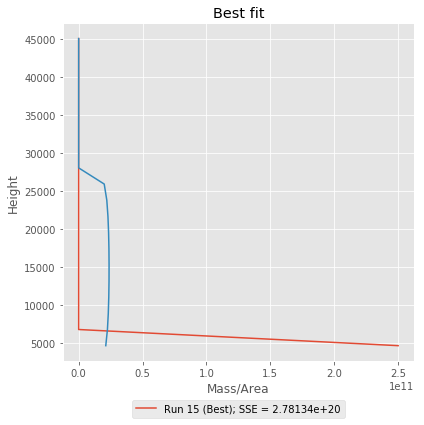

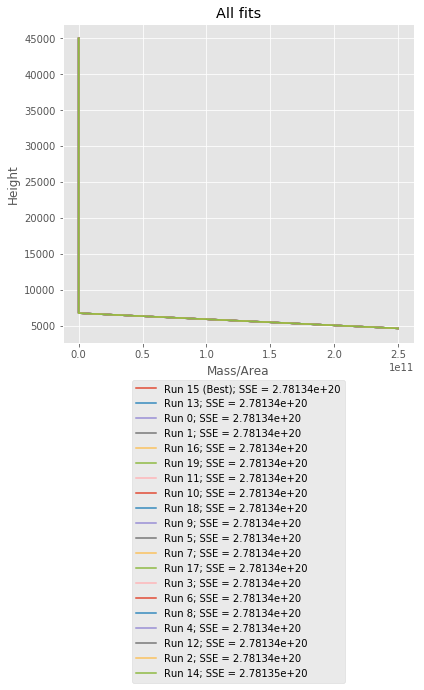

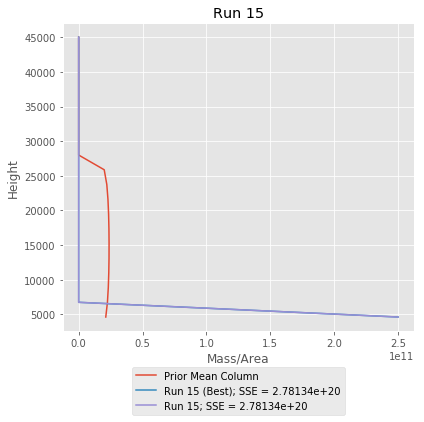

,D,M,a,b,ftt,h1,u,v
0,"73,148.5",2.5e+11,2,2,"3,600","4,625",9.37771e-05,-0.000247656


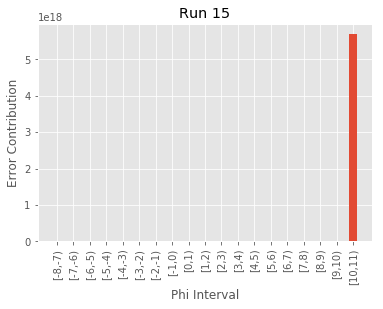

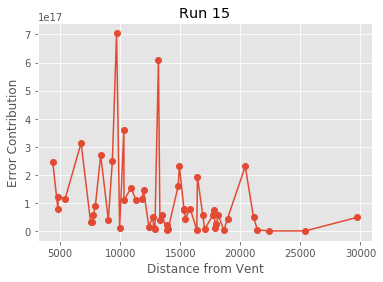

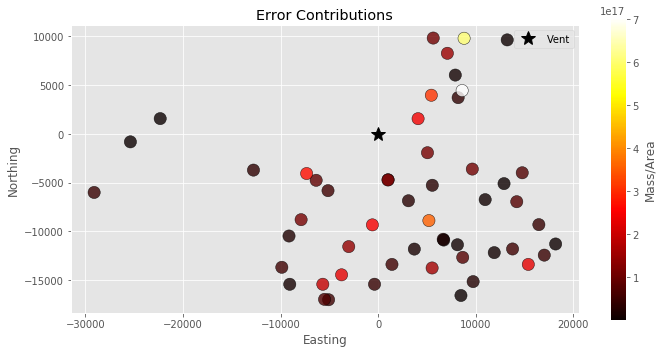

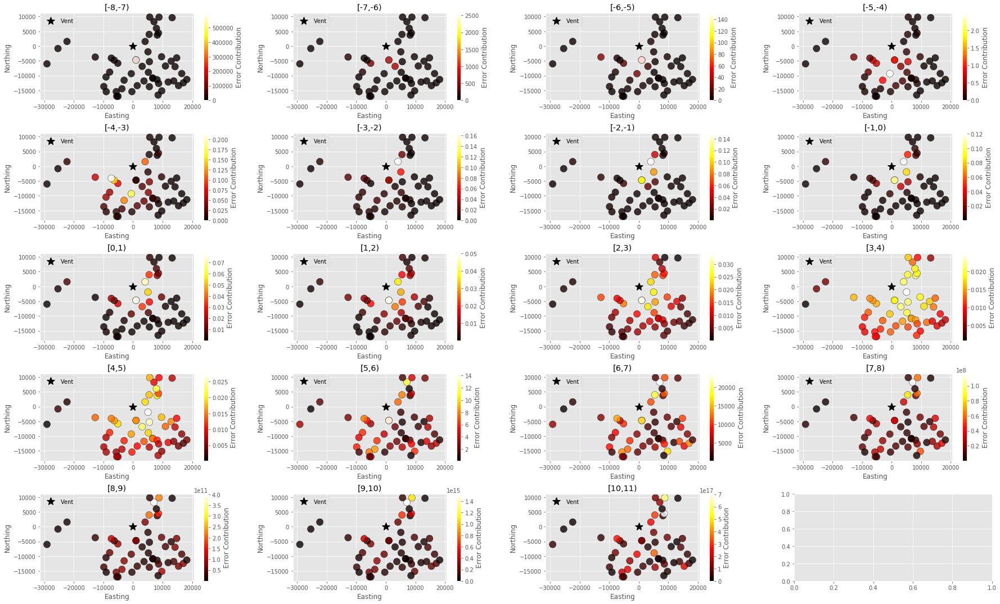

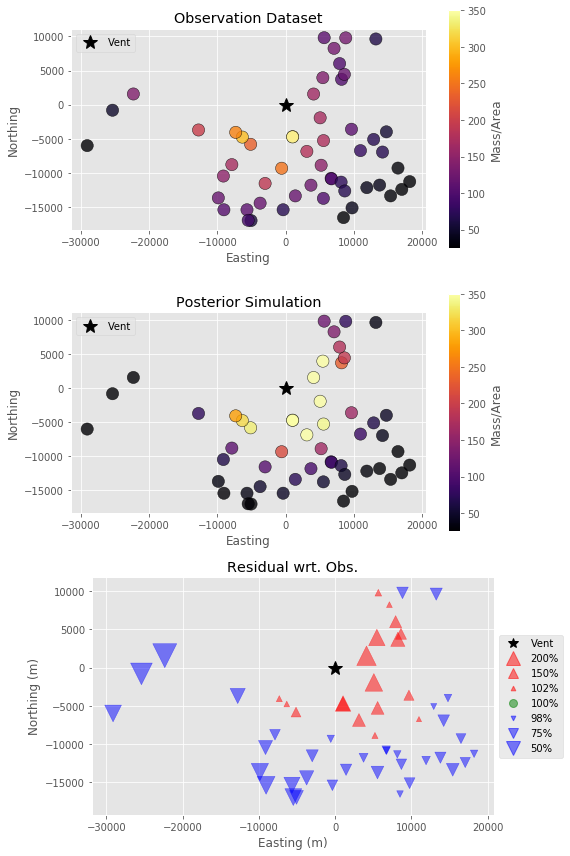

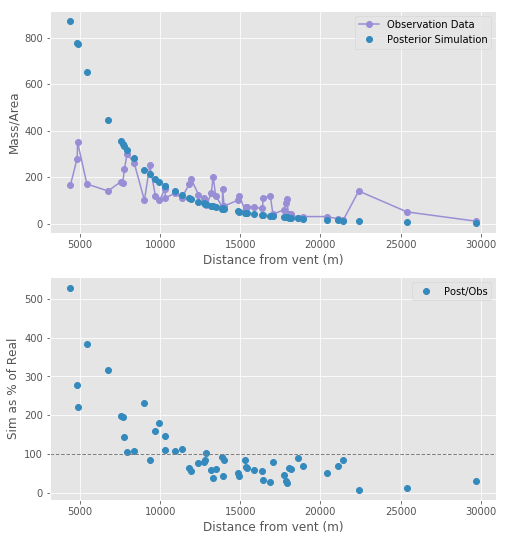

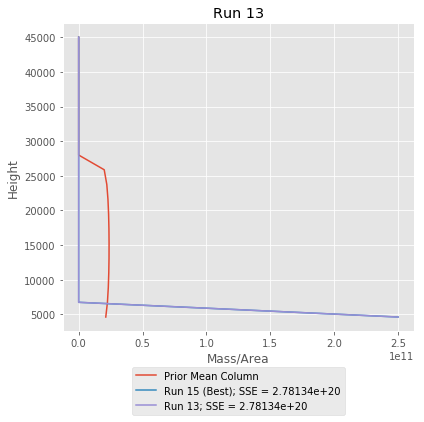

,D,M,a,b,ftt,h1,u,v
0,"75,299.4",2.5e+11,2,2,"3,600","4,625",9.34605e-05,-0.000247256


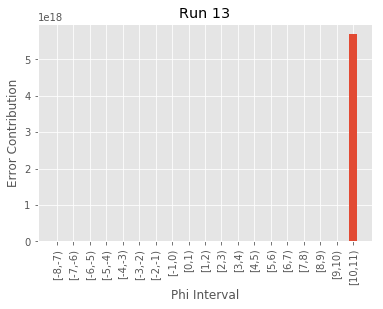

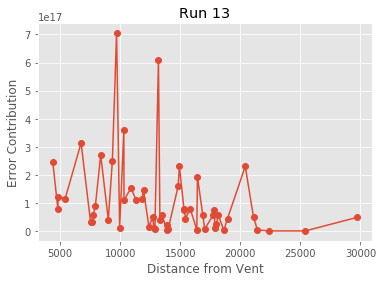

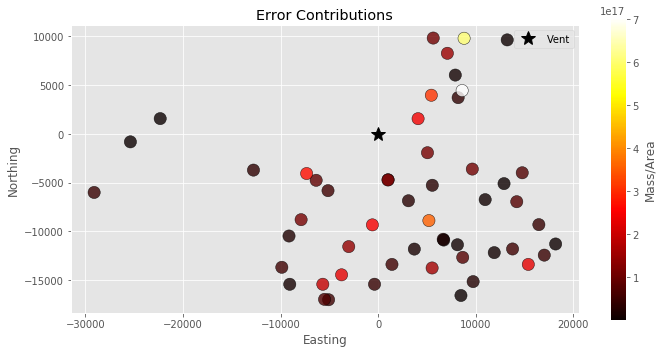

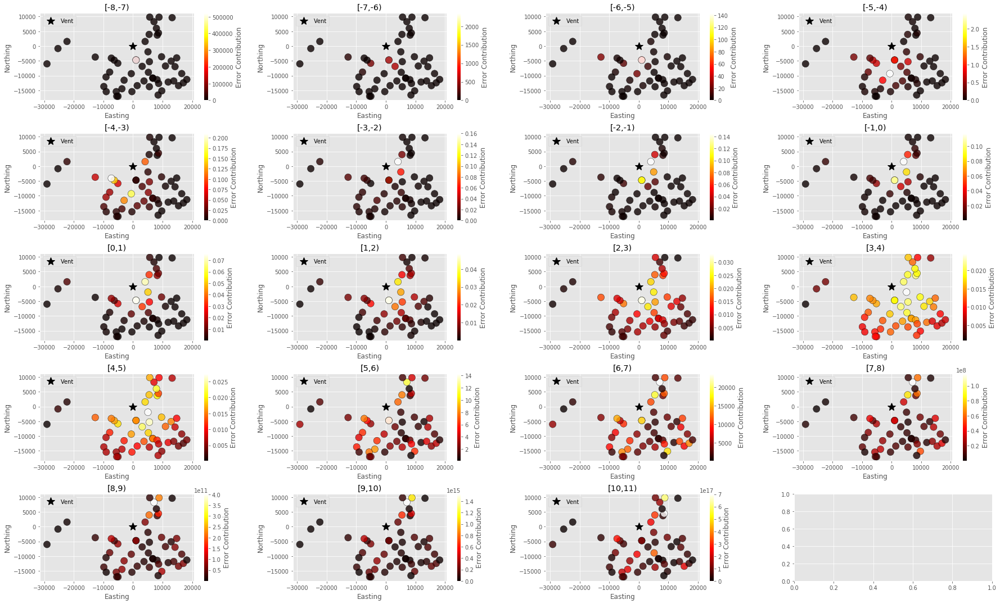

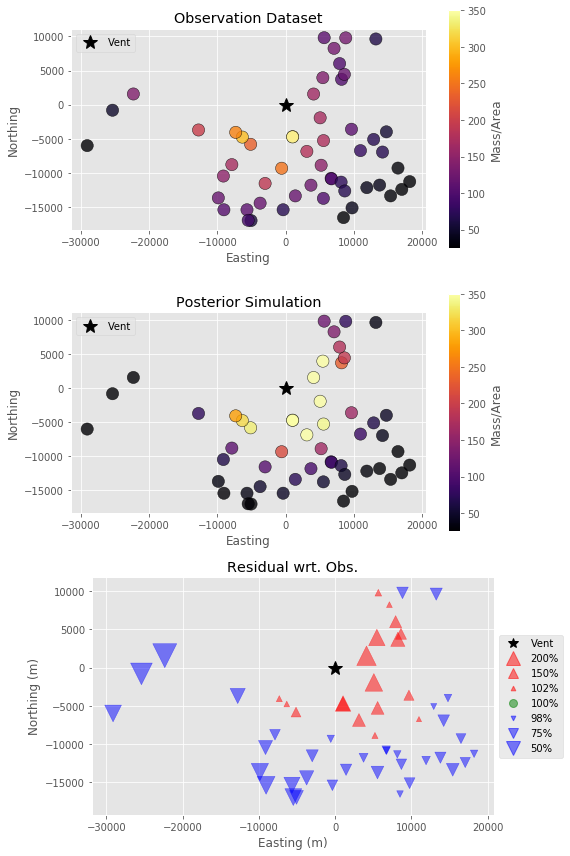

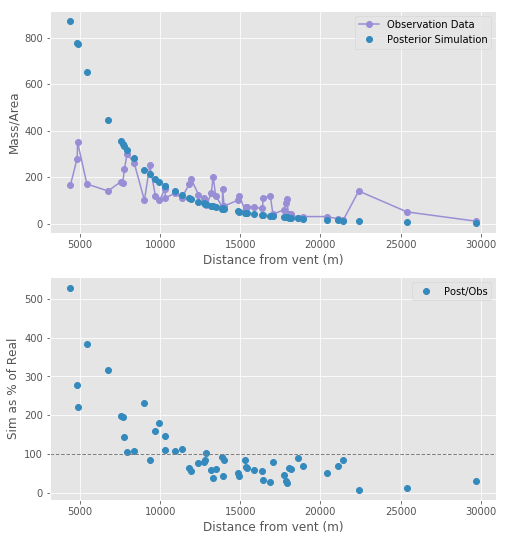

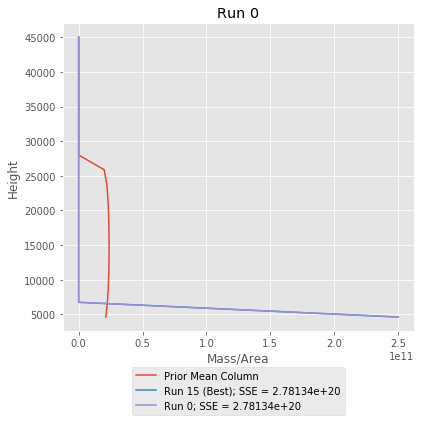

,D,M,a,b,ftt,h1,u,v
0,1.46475e+06,2.5e+11,2,2,"3,600","4,625",9.39549e-05,-0.000247196


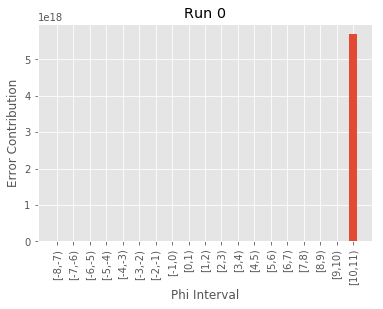

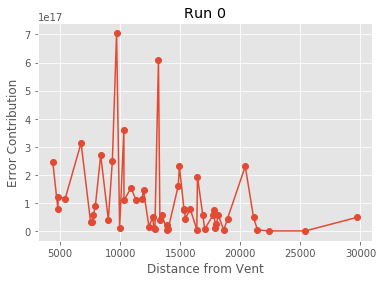

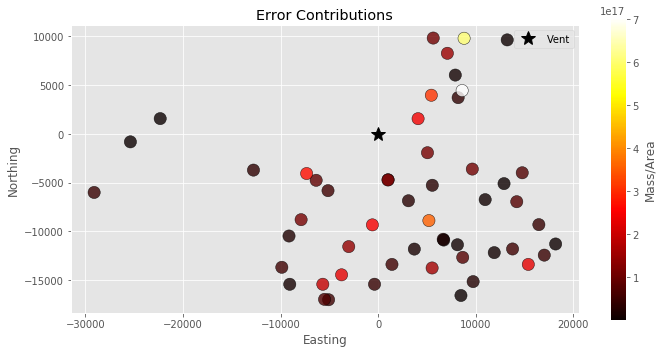

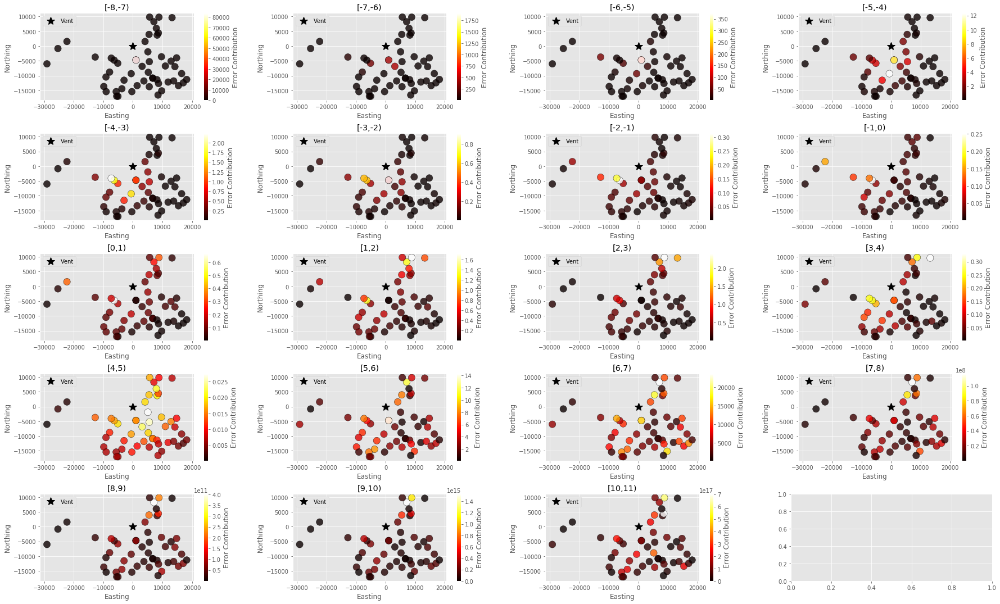

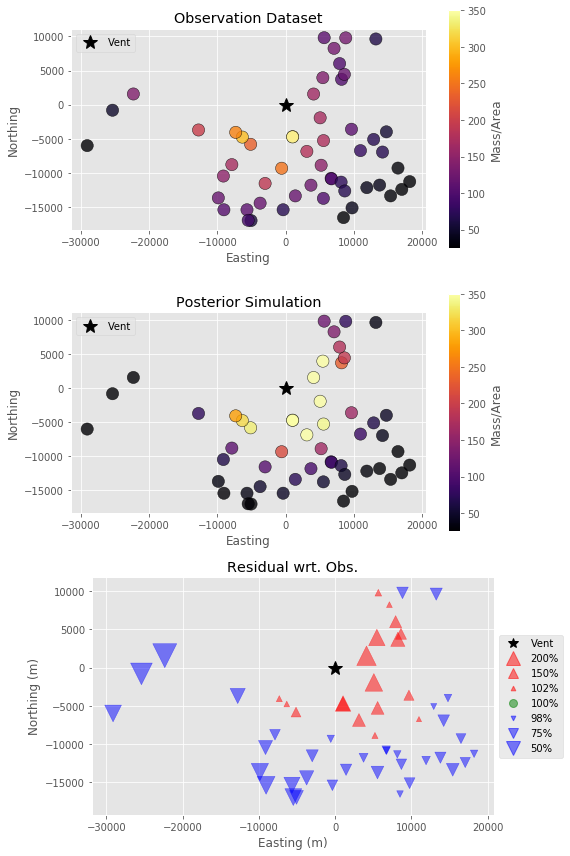

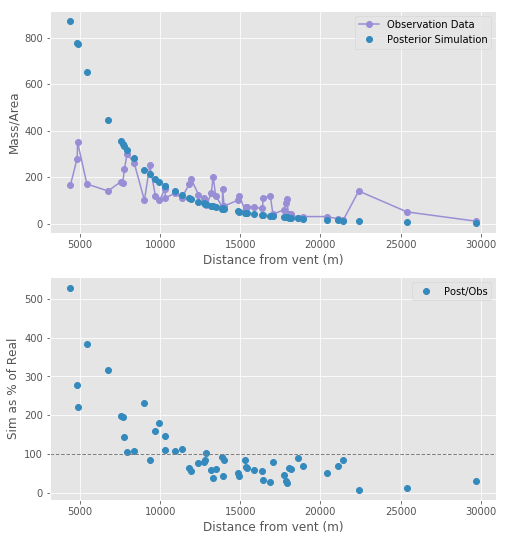

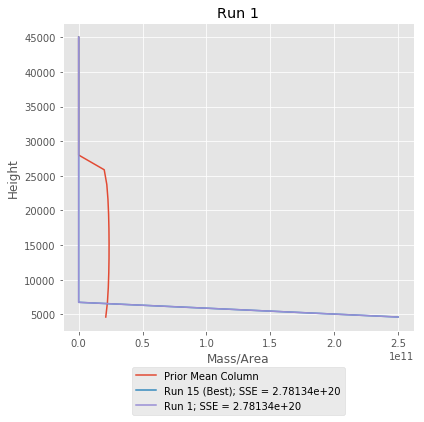

,D,M,a,b,ftt,h1,u,v
0,"906,262",2.5e+11,2,2,"3,600","4,625",9.45087e-05,-0.000246848


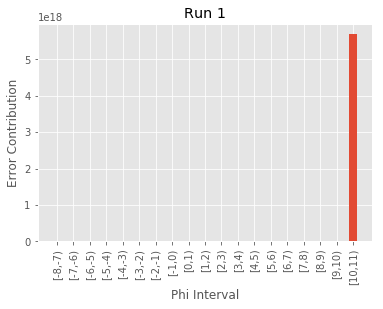

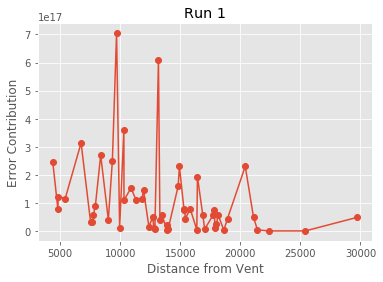

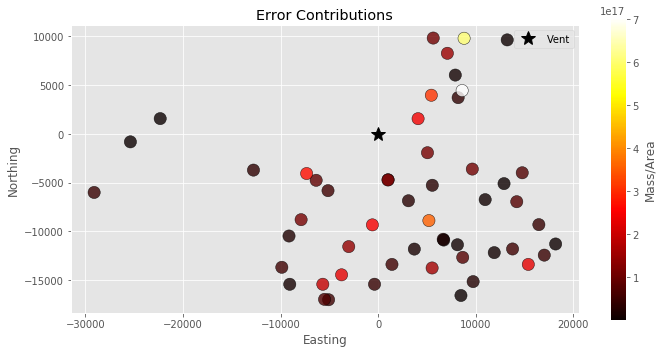

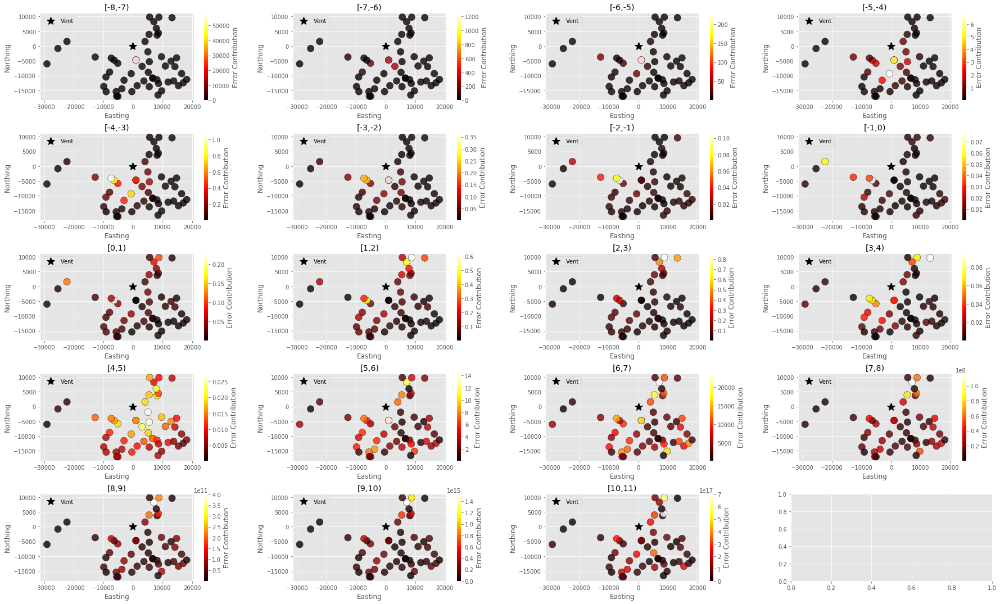

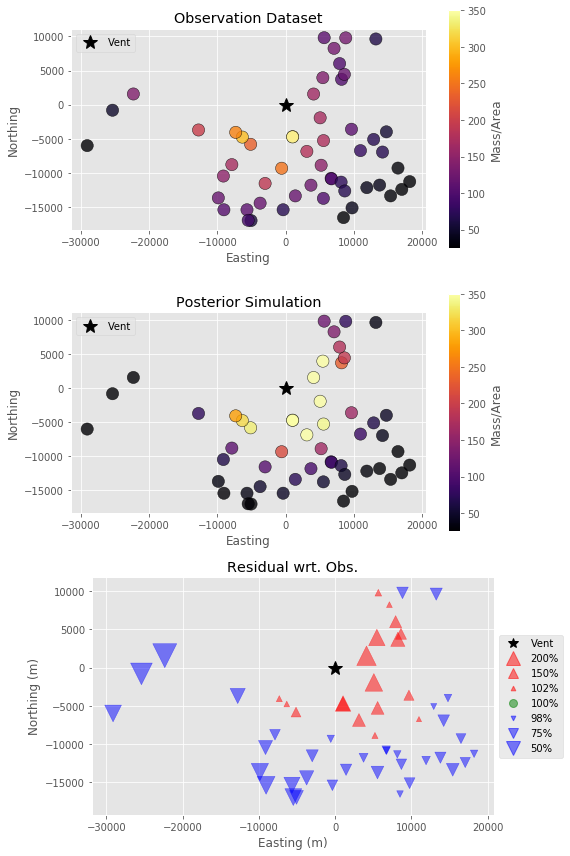

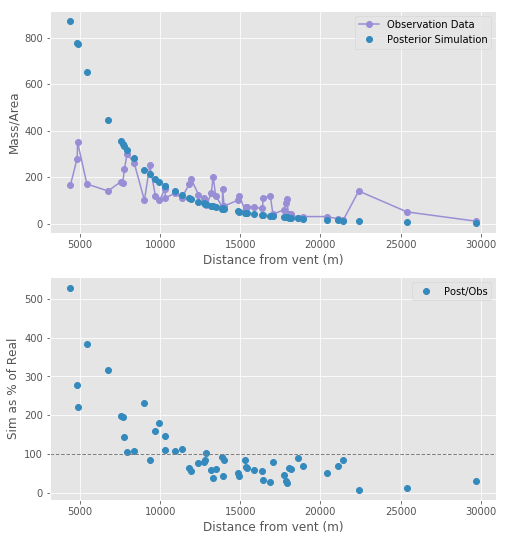

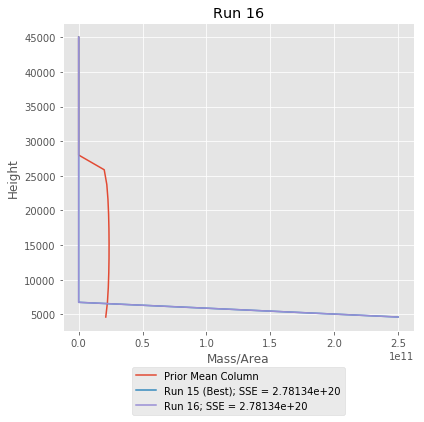

,D,M,a,b,ftt,h1,u,v
0,6.36017e+06,2.5e+11,2,2,"3,600","4,625",9.20481e-05,-0.000246833


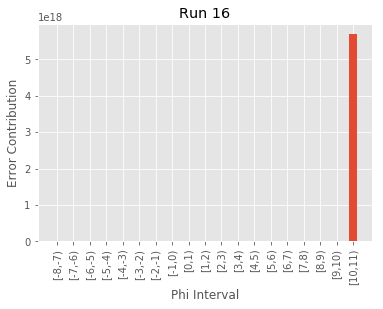

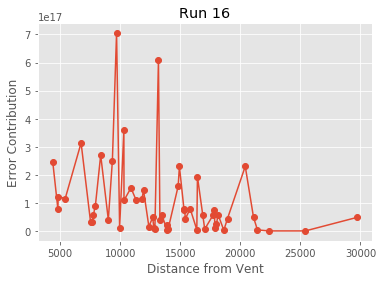

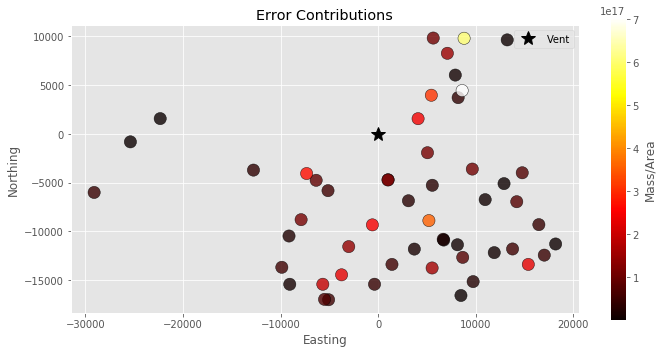

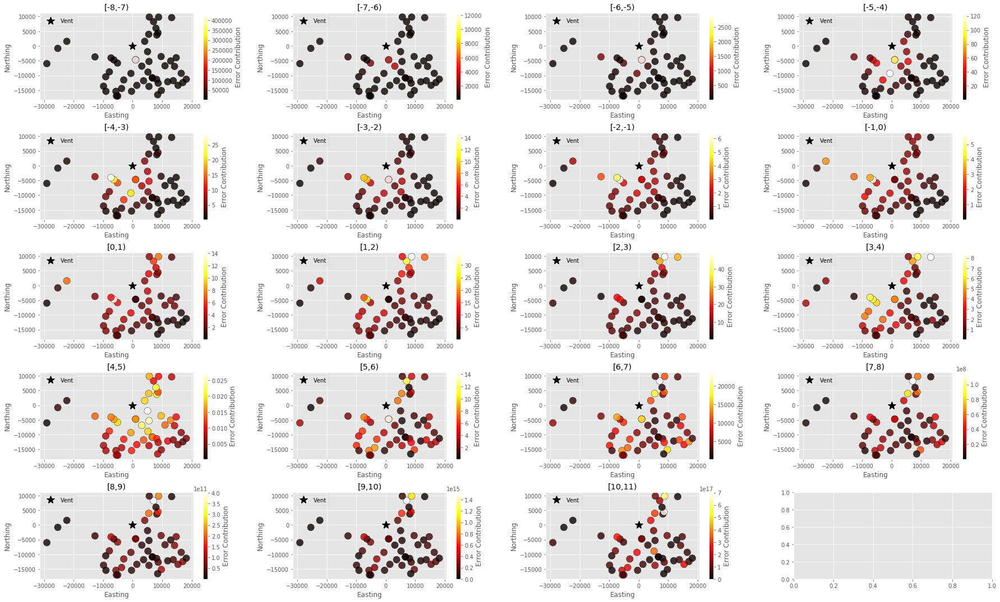

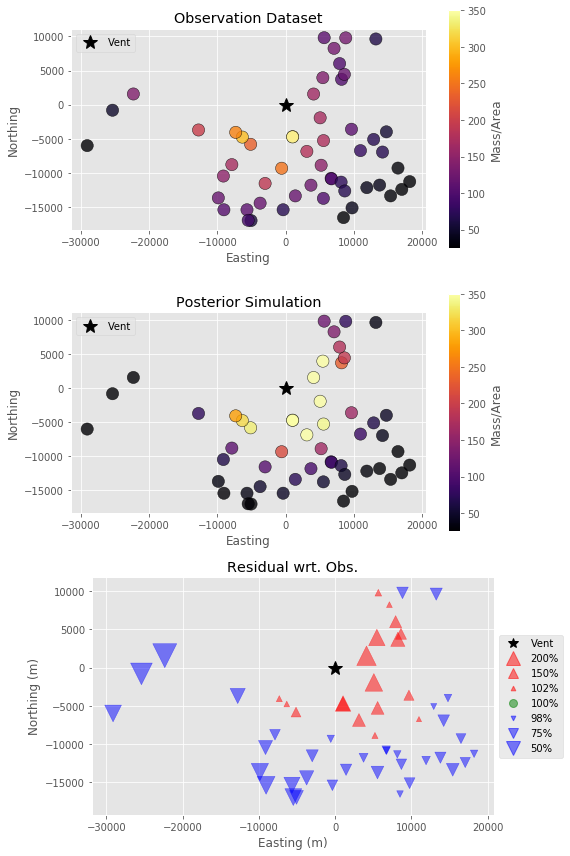

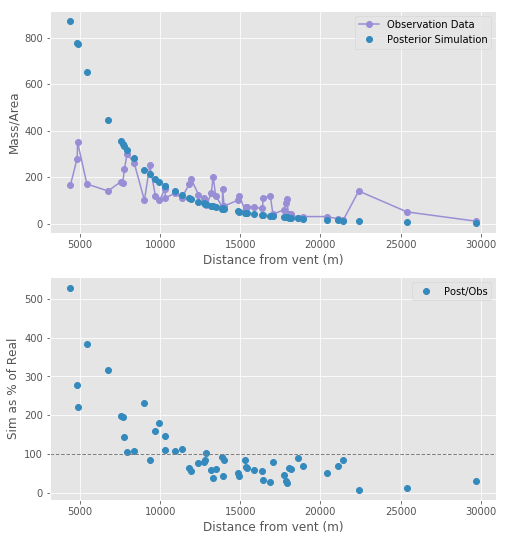

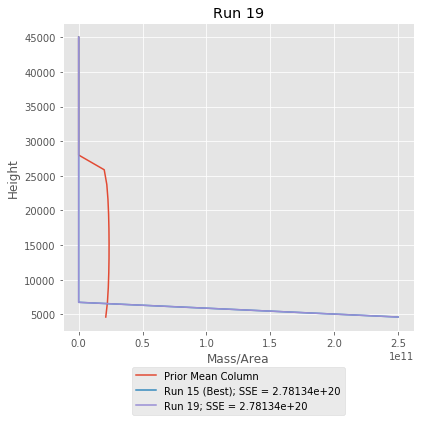

,D,M,a,b,ftt,h1,u,v
0,"24,152.2",2.5e+11,2,2,"3,600","4,625",9.35212e-05,-0.0002471


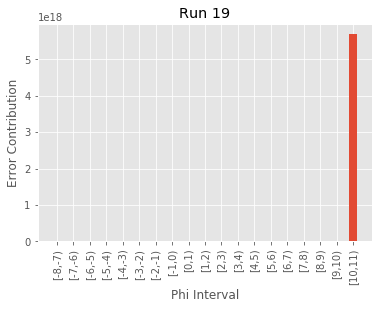

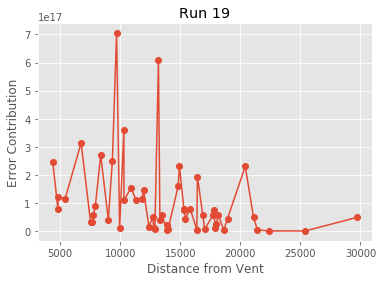

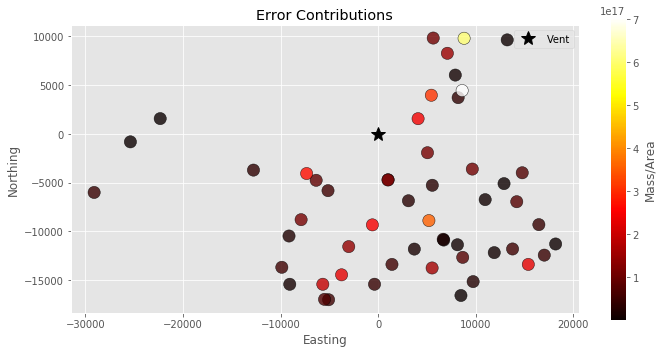

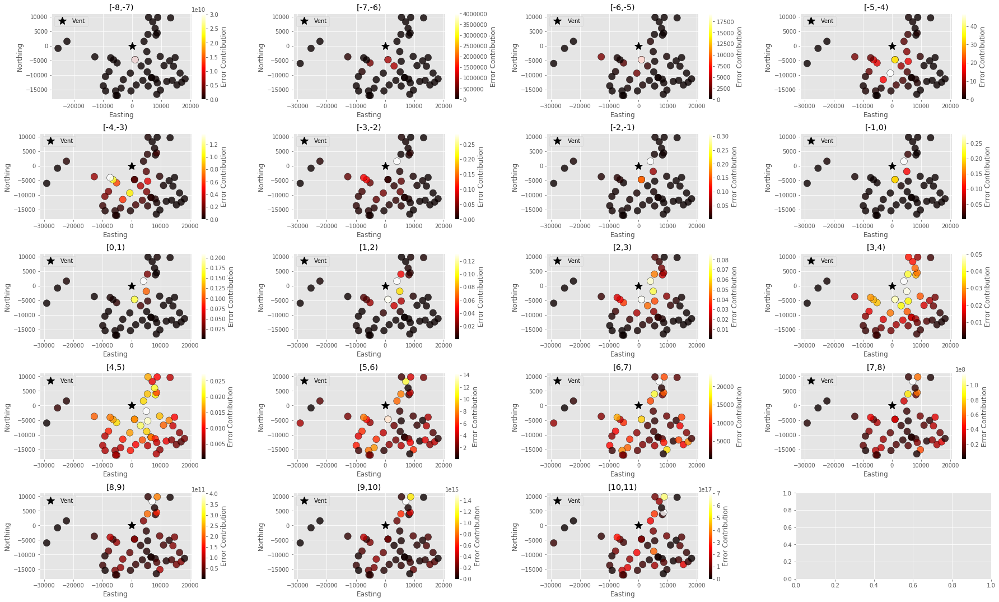

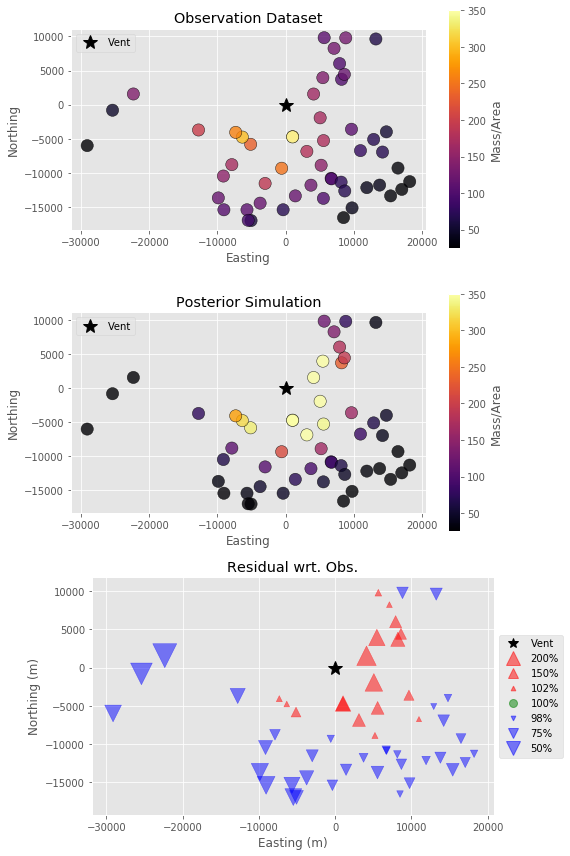

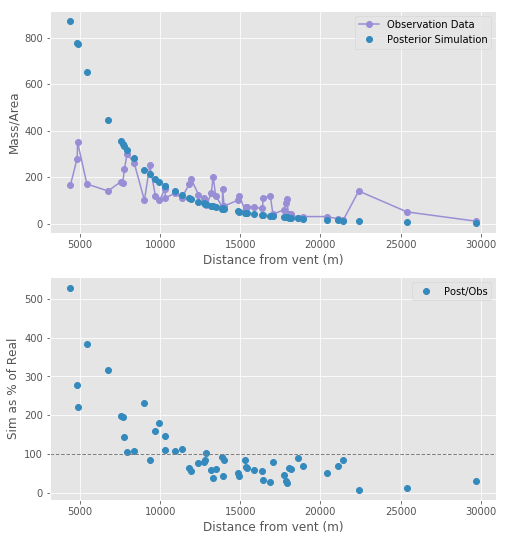

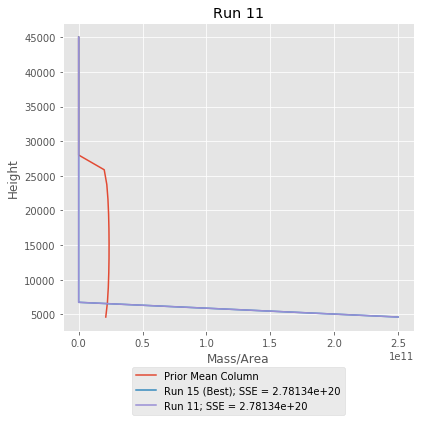

,D,M,a,b,ftt,h1,u,v
0,1.14841e+07,2.5e+11,2,2,"3,600","4,625",9.36668e-05,-0.000247491


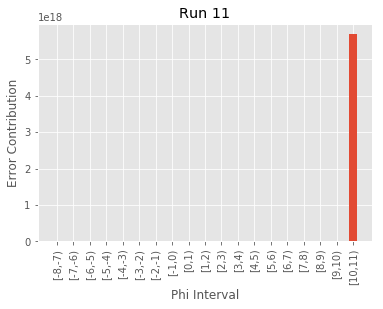

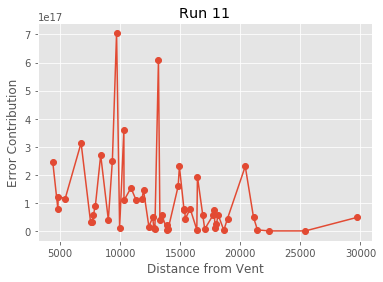

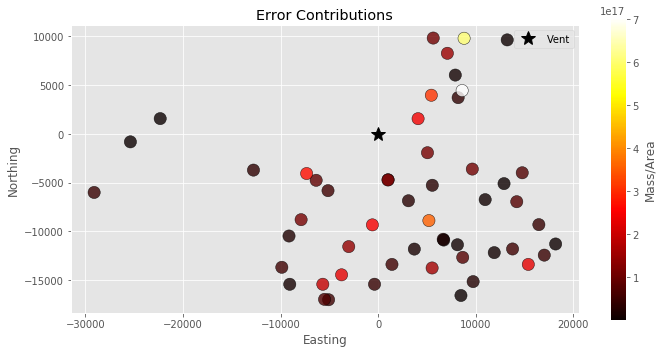

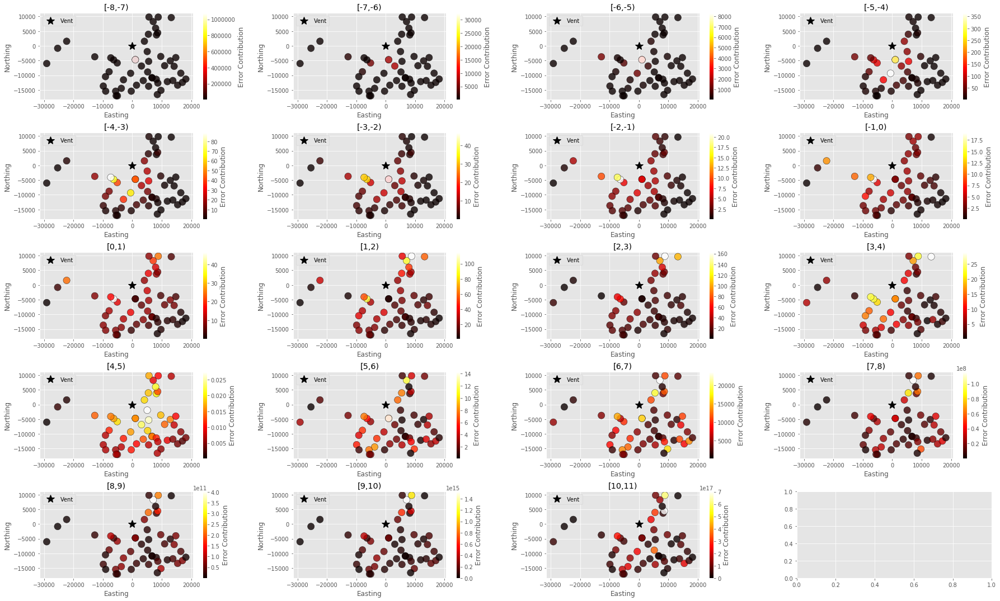

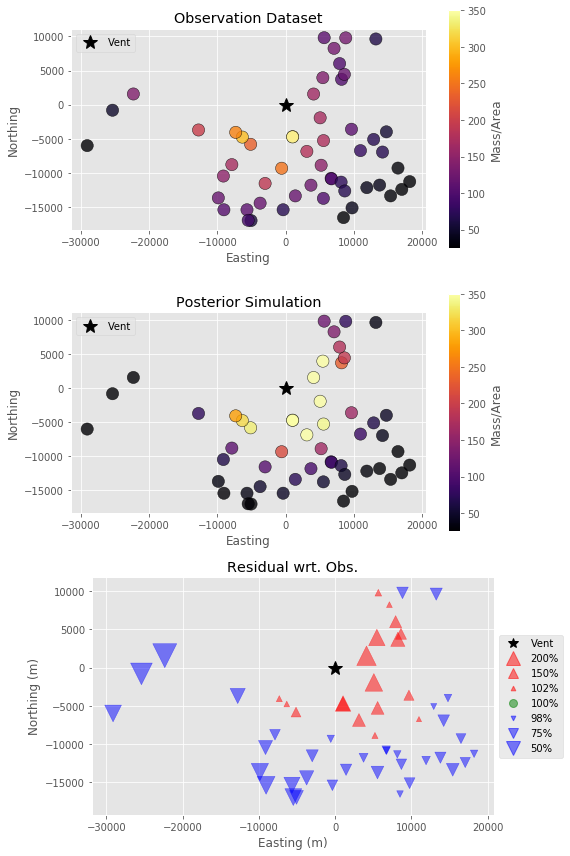

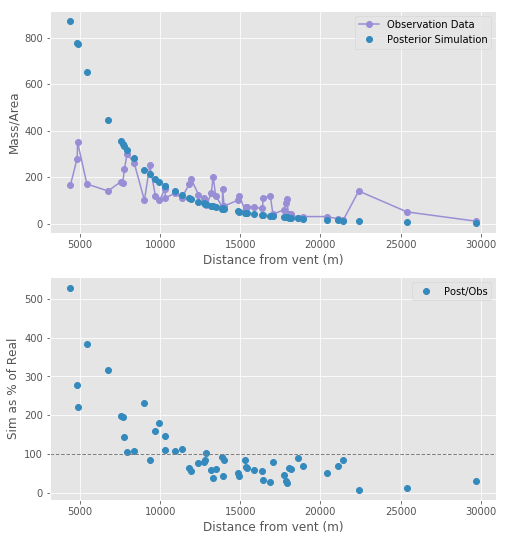

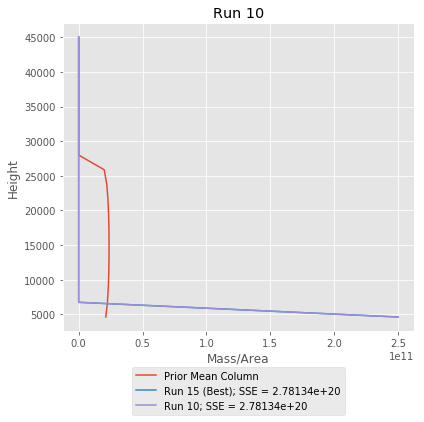

,D,M,a,b,ftt,h1,u,v
0,4.23315e+07,2.5e+11,2,2,"3,600","4,625",9.39363e-05,-0.000247061


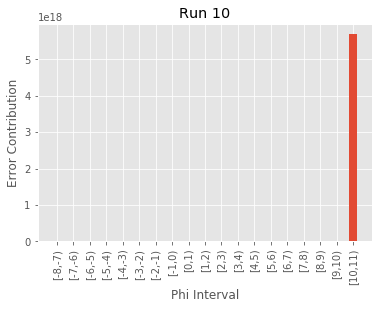

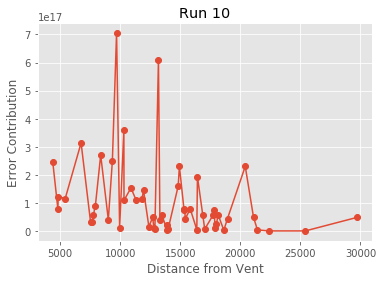

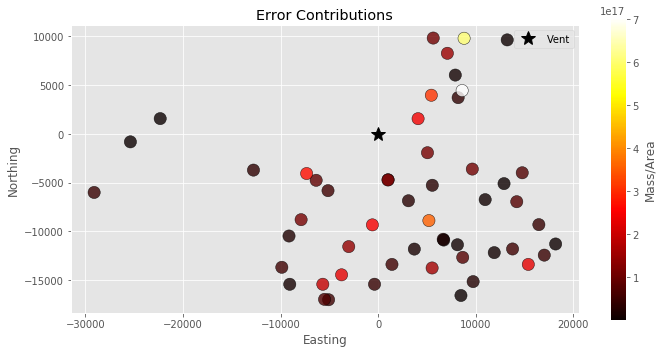

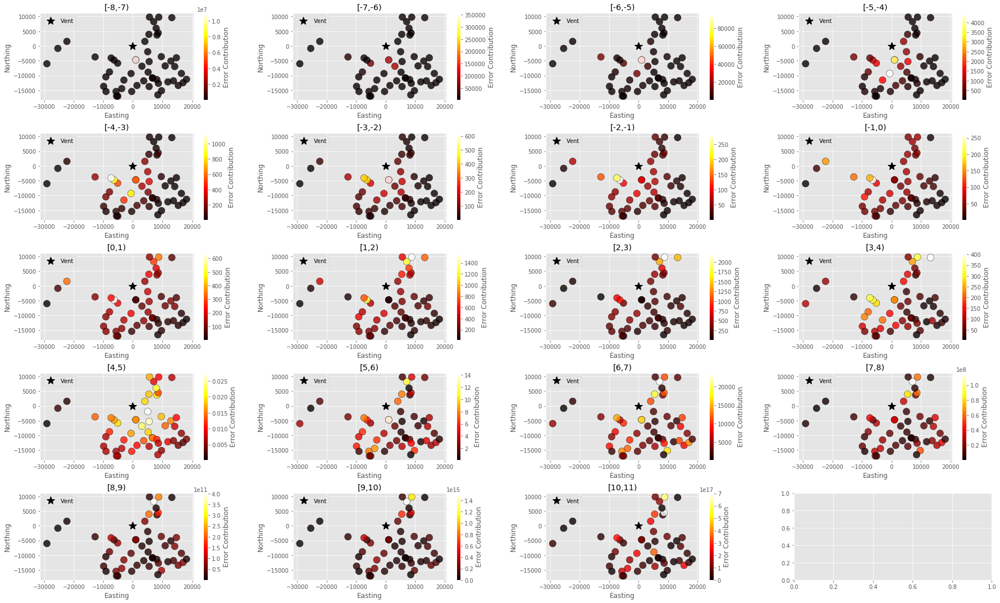

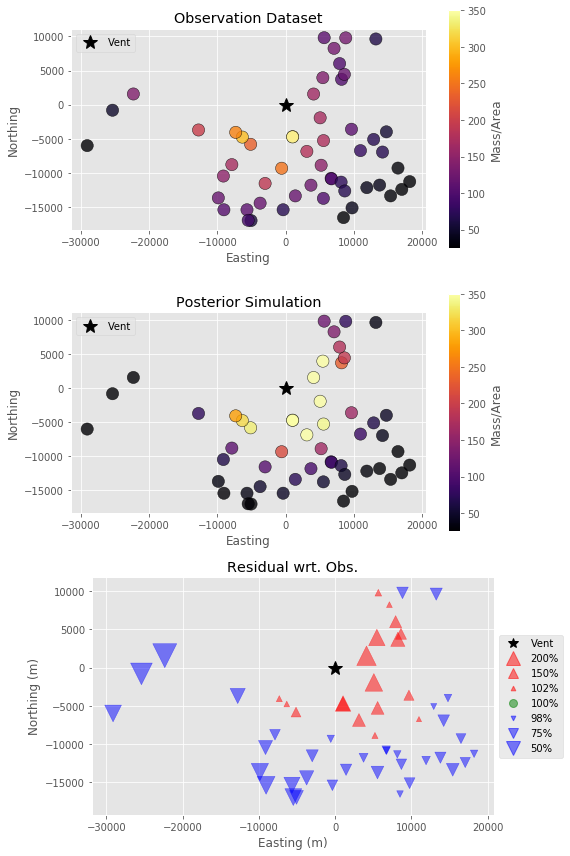

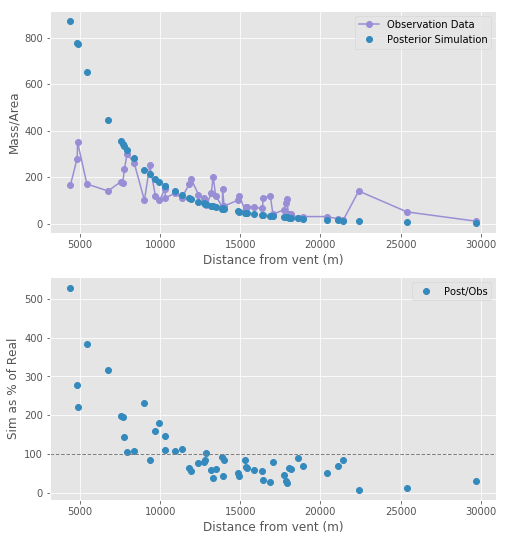

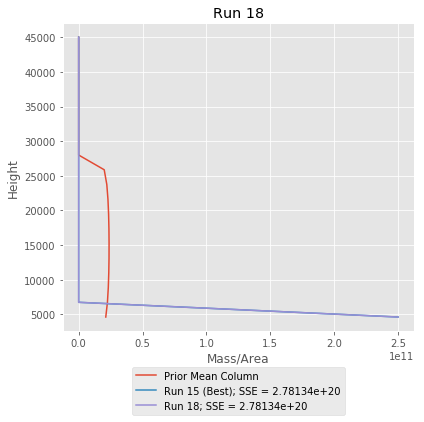

,D,M,a,b,ftt,h1,u,v
0,7.41461e+07,2.5e+11,2,2,"3,600","4,625",9.37269e-05,-0.000247821


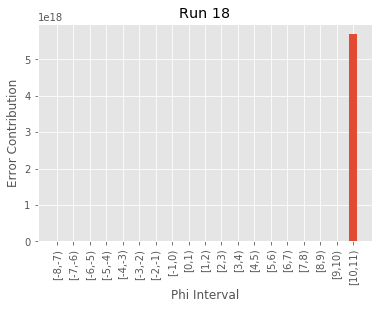

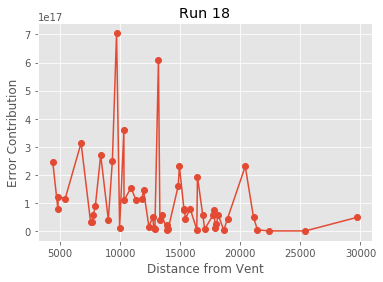

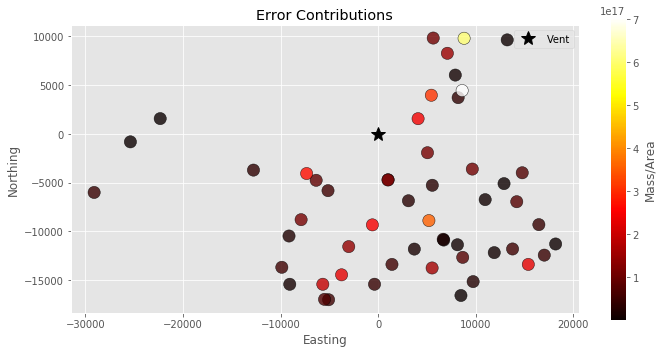

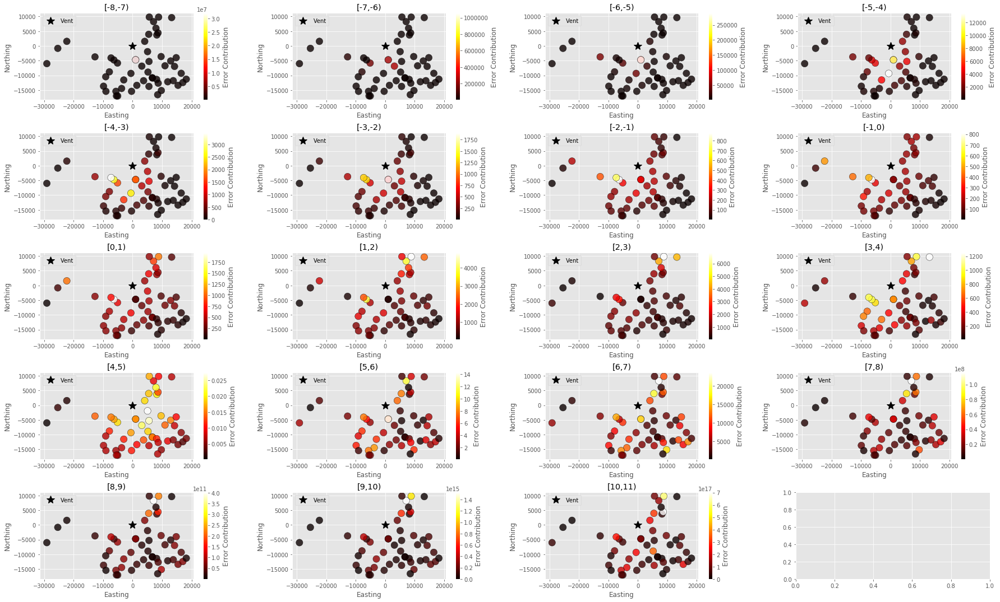

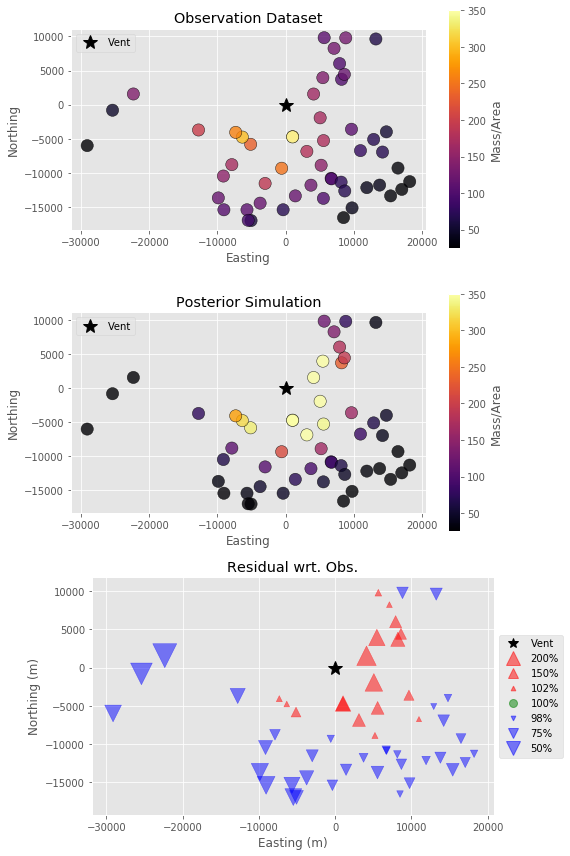

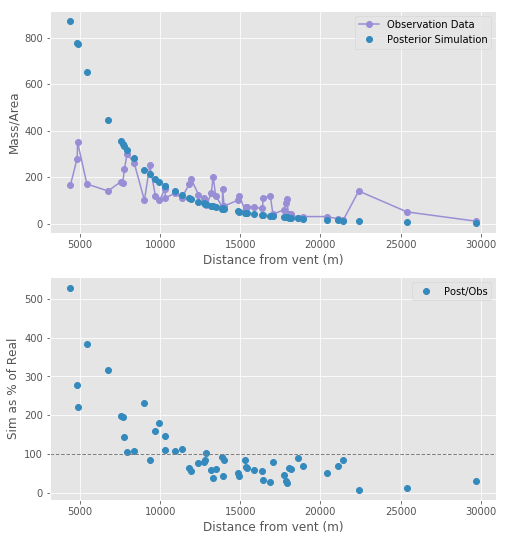

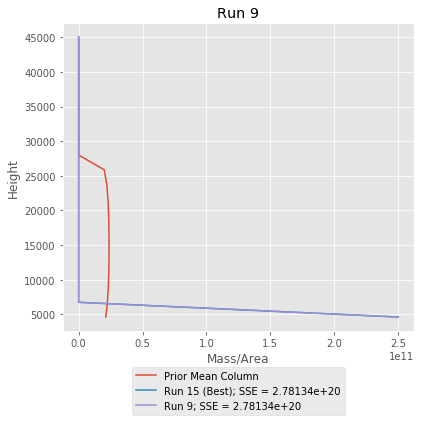

,D,M,a,b,ftt,h1,u,v
0,7.41735e+08,2.5e+11,2,2,"3,600","4,625",0.000106475,-0.000258804


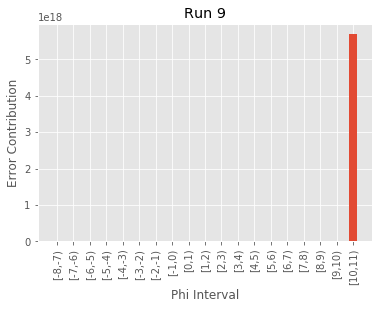

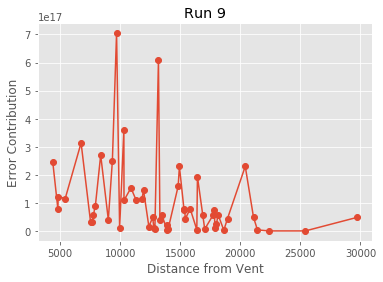

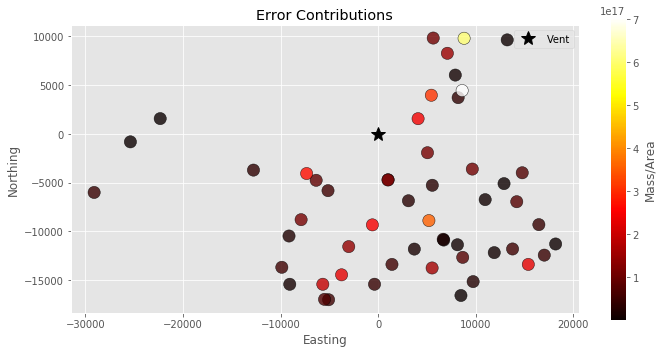

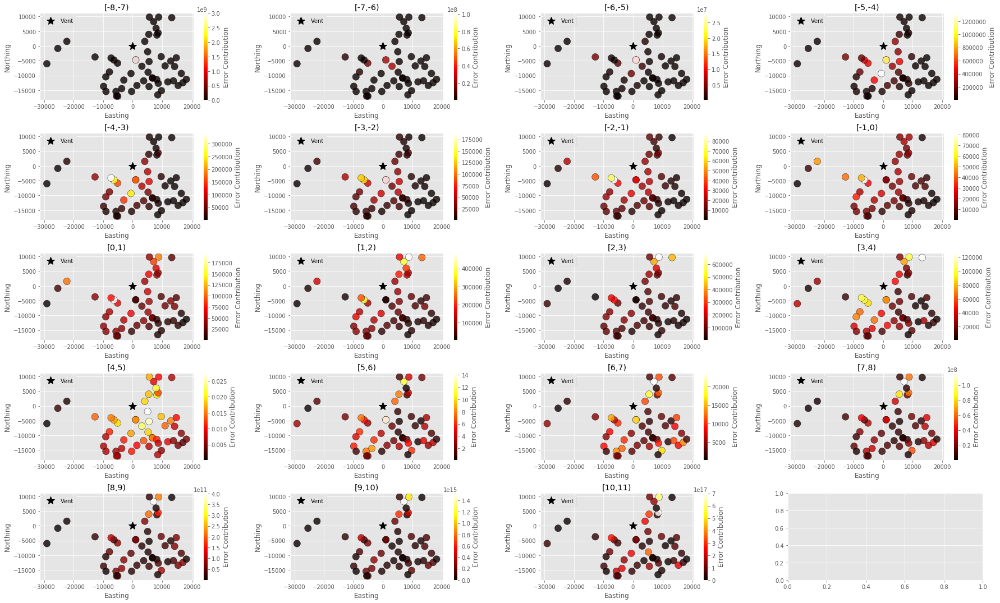

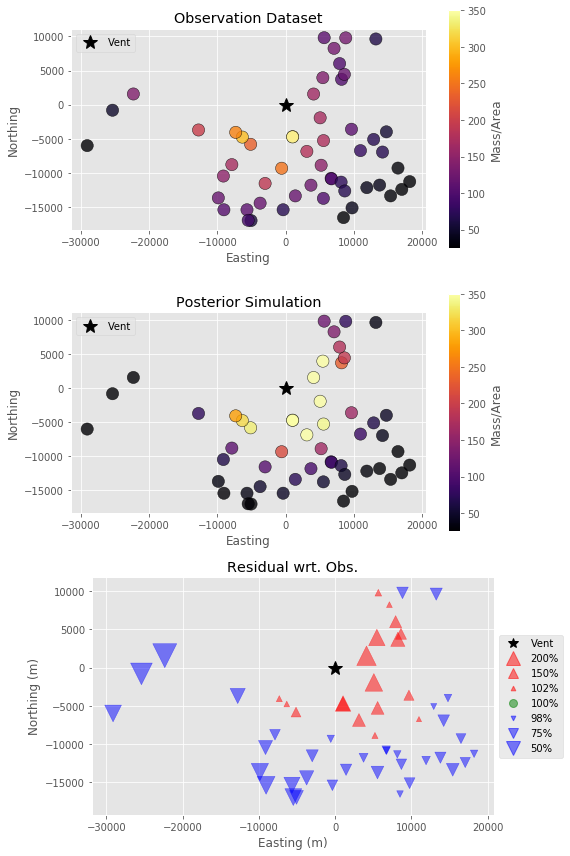

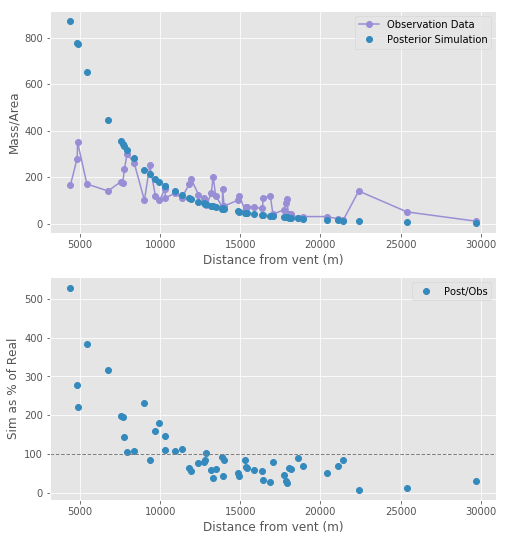

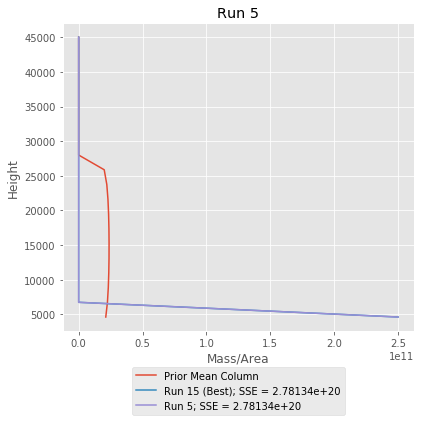

,D,M,a,b,ftt,h1,u,v
0,9.10957e+08,2.5e+11,2,2,"3,600","4,625",9.79403e-05,-0.000250231


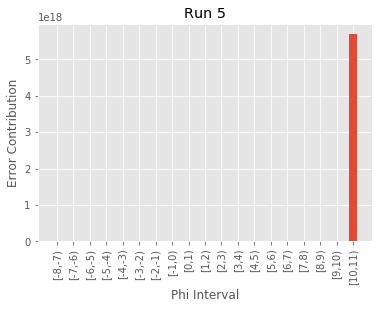

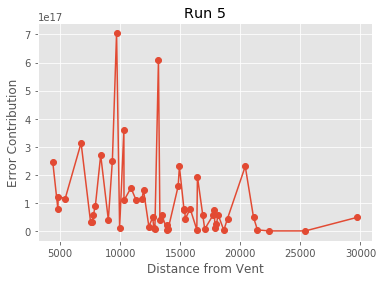

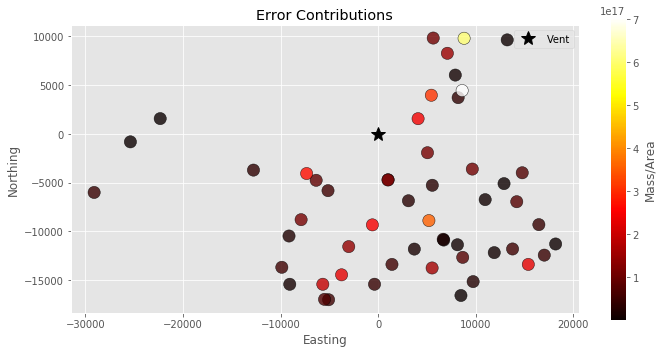

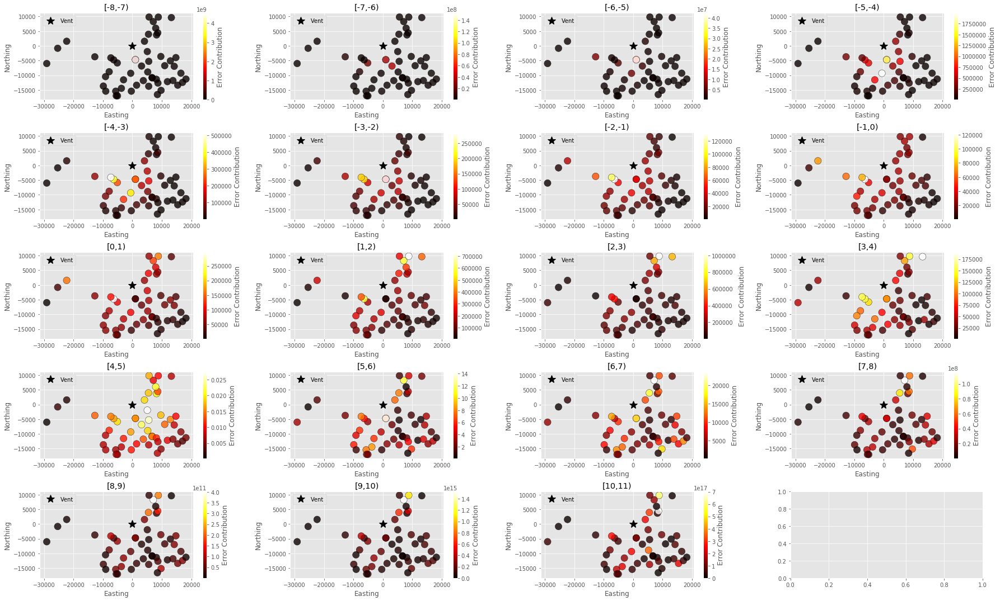

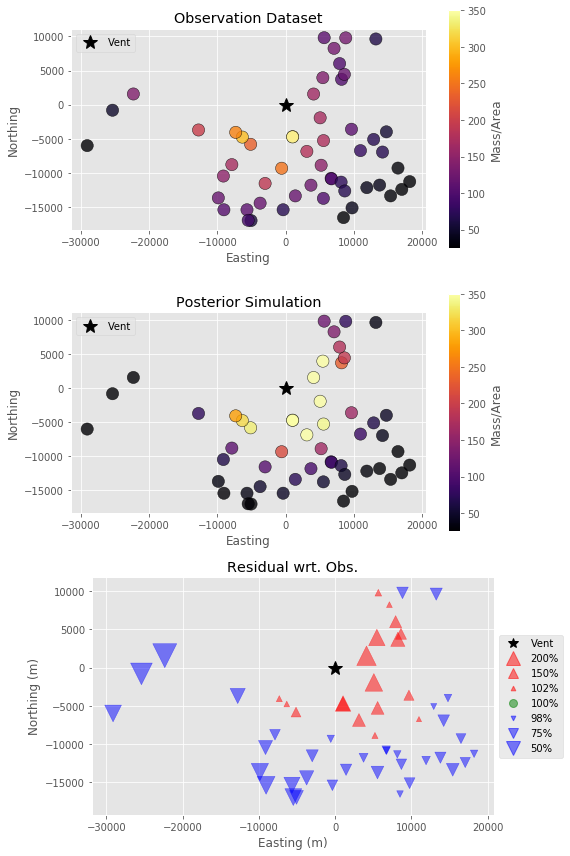

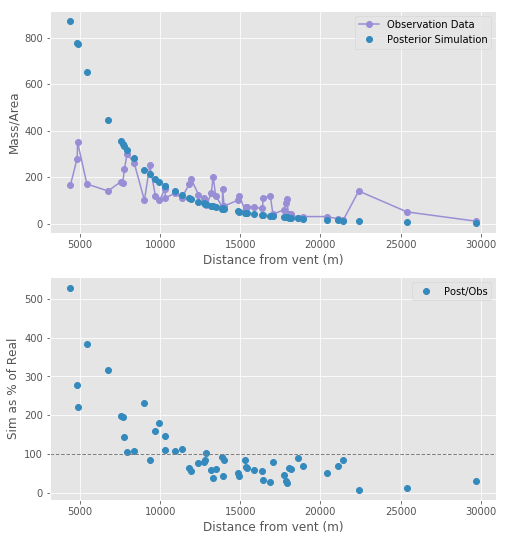

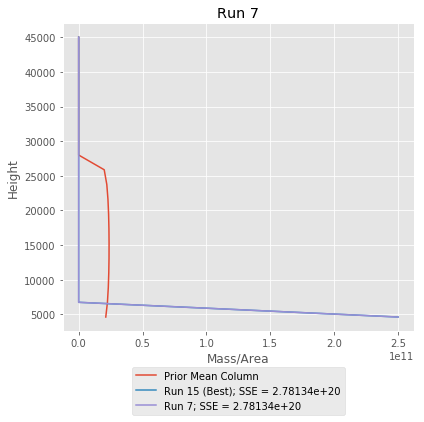

,D,M,a,b,ftt,h1,u,v
0,9.14256e+08,2.5e+11,2,2,"3,600","4,625",9.04987e-05,-0.000248883


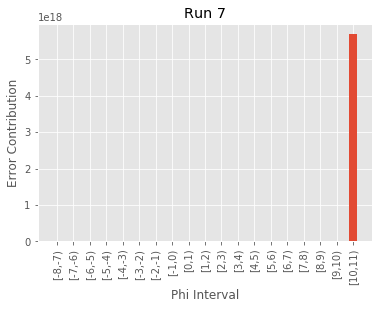

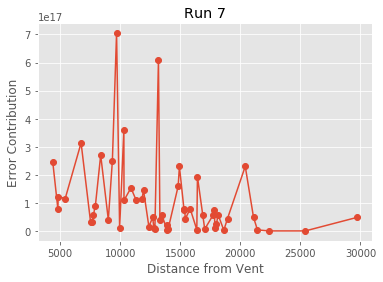

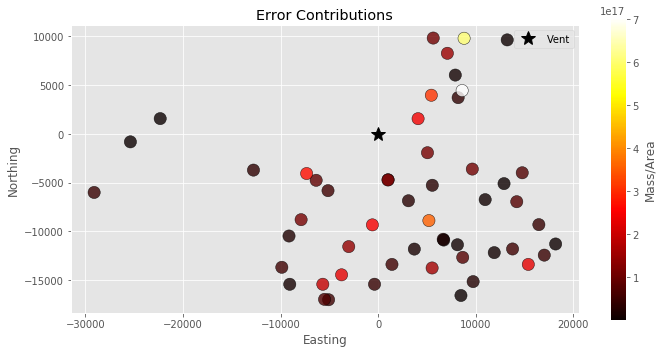

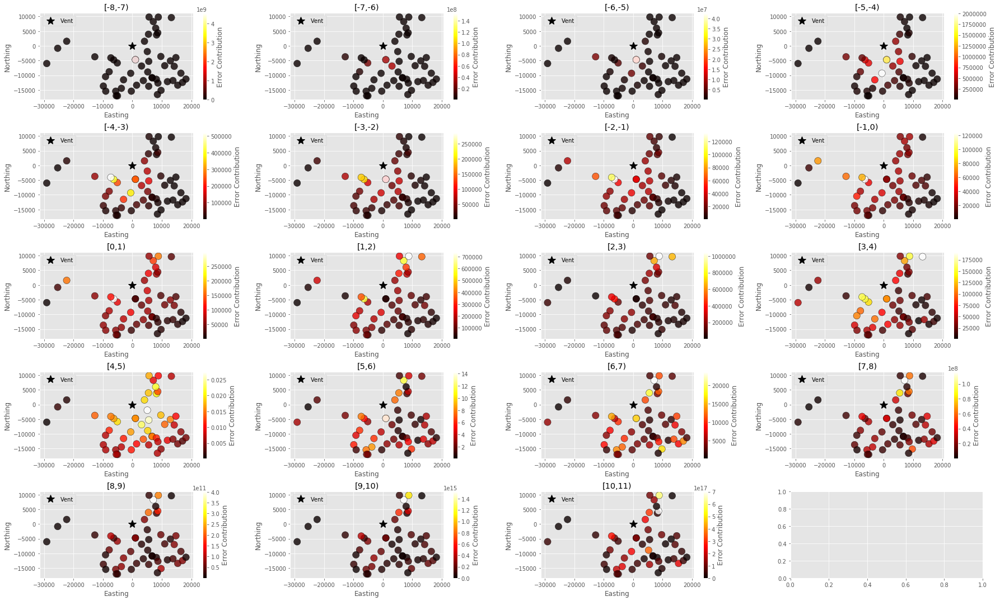

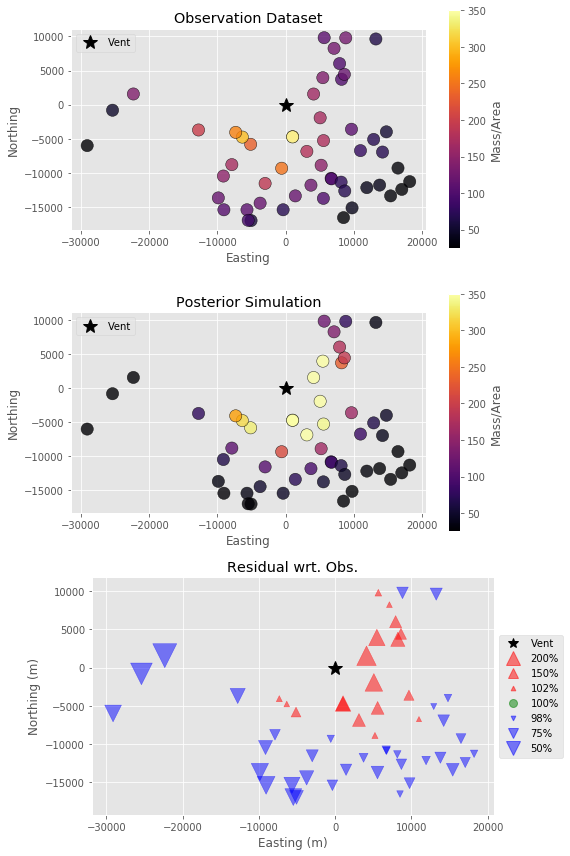

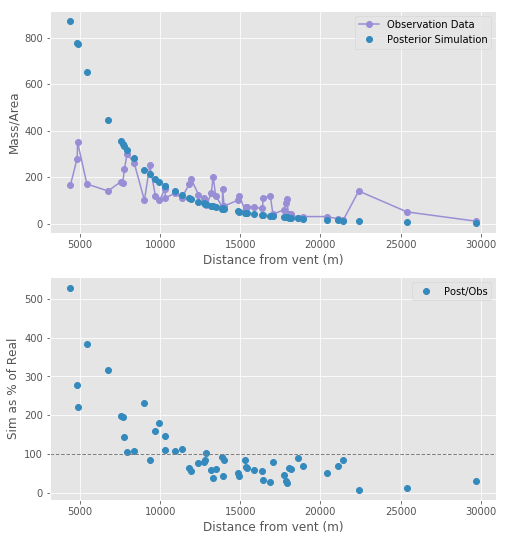

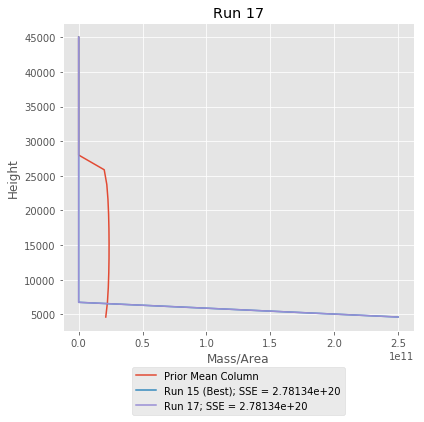

,D,M,a,b,ftt,h1,u,v
0,1.31261e+09,2.5e+11,2,2,"3,600","4,625",0.000118212,-0.000221196


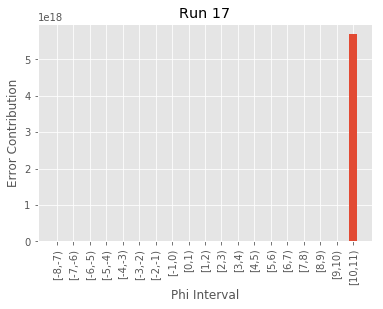

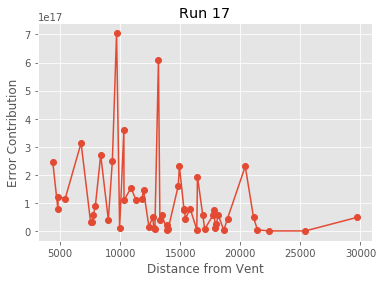

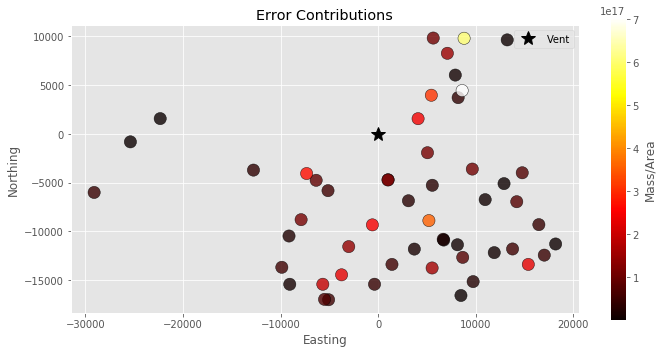

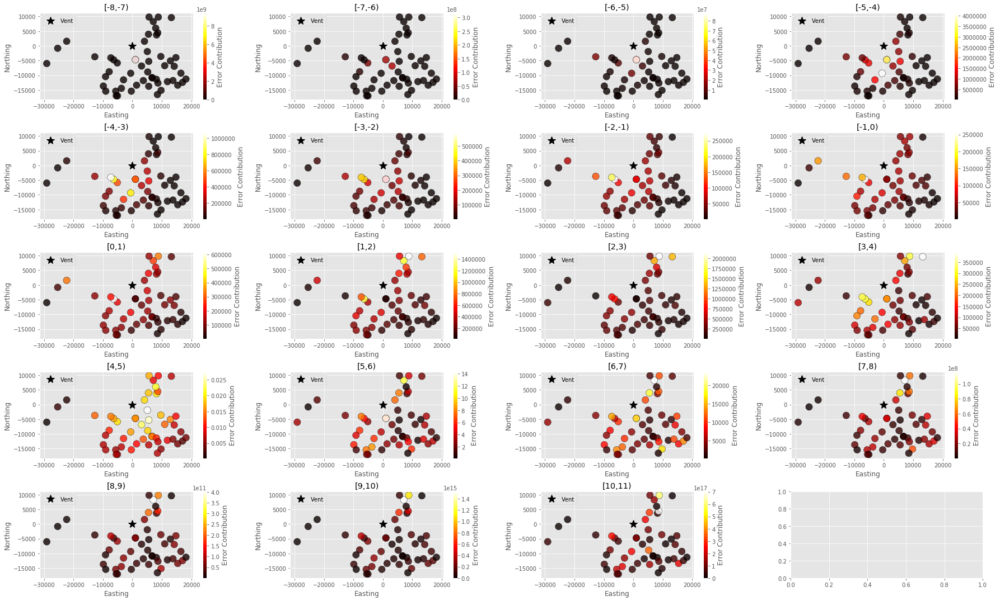

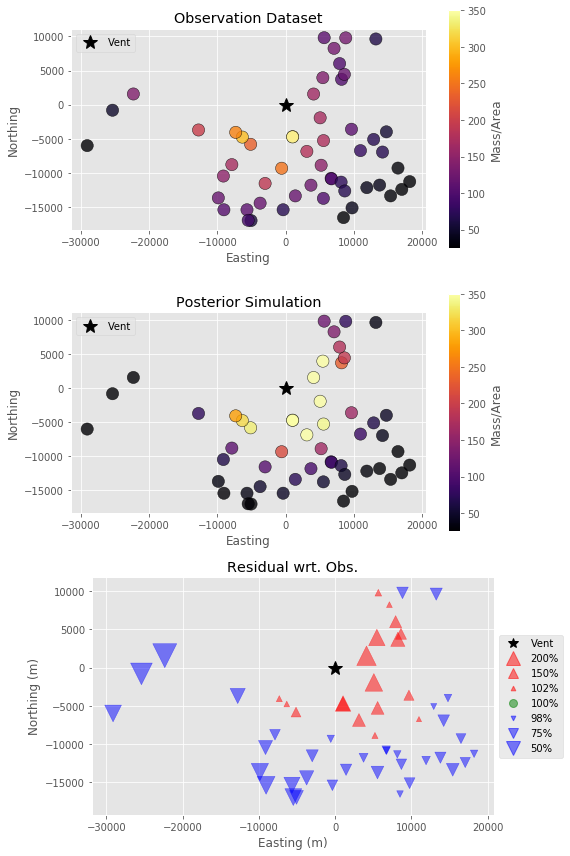

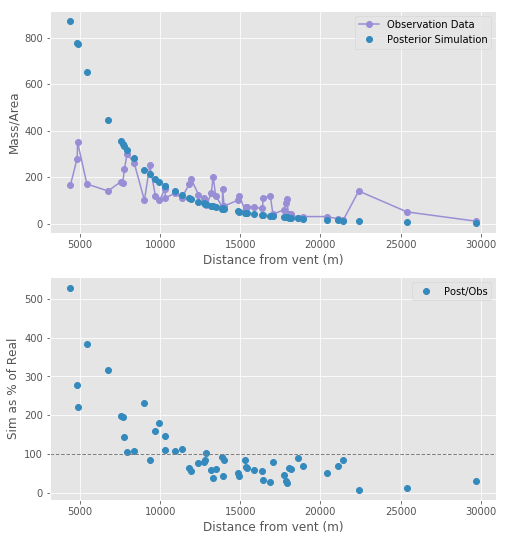

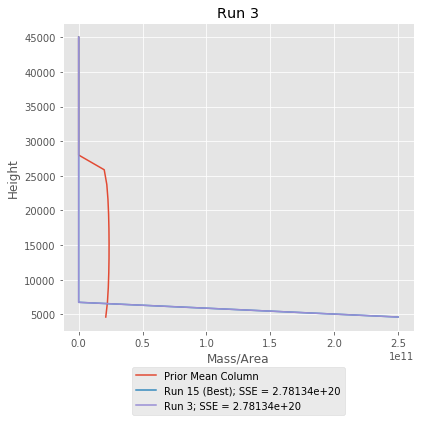

,D,M,a,b,ftt,h1,u,v
0,1.60329e+09,2.5e+11,2,2,"3,600","4,625",9.35897e-05,-0.000245798


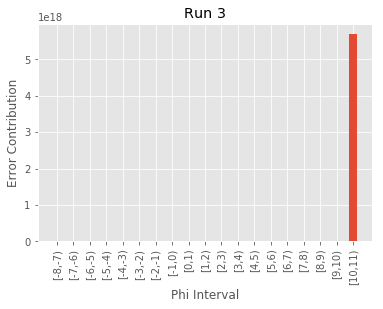

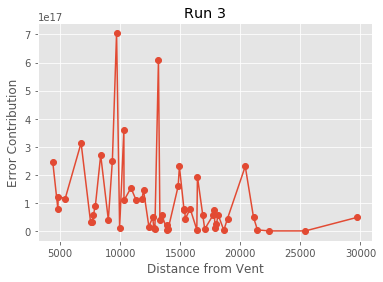

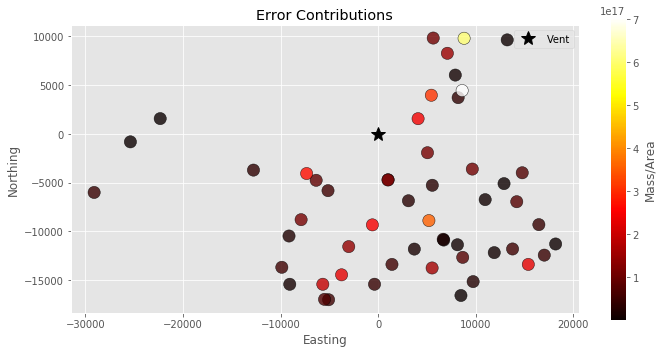

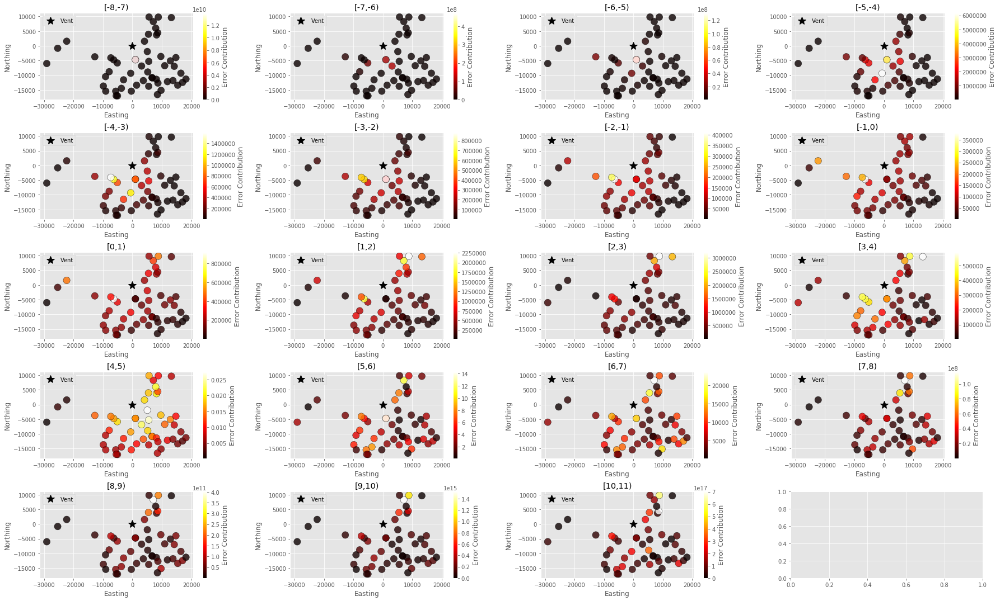

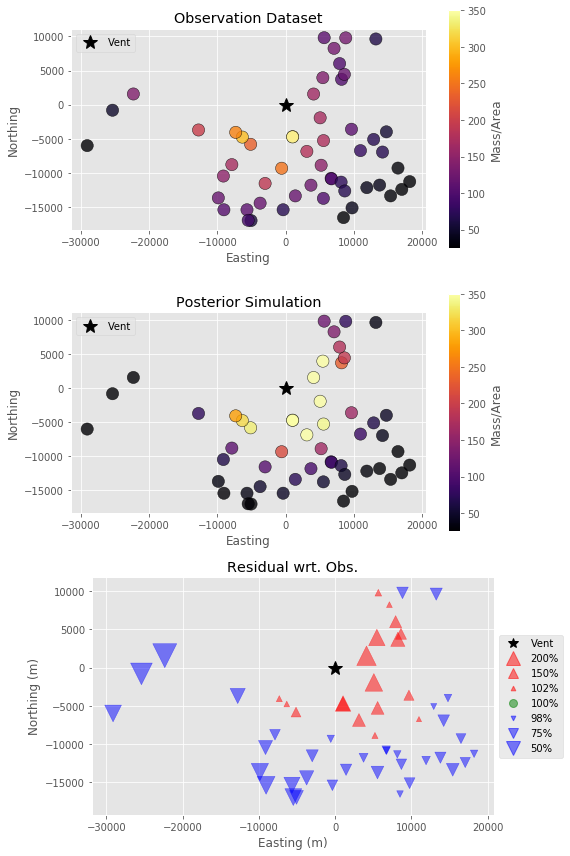

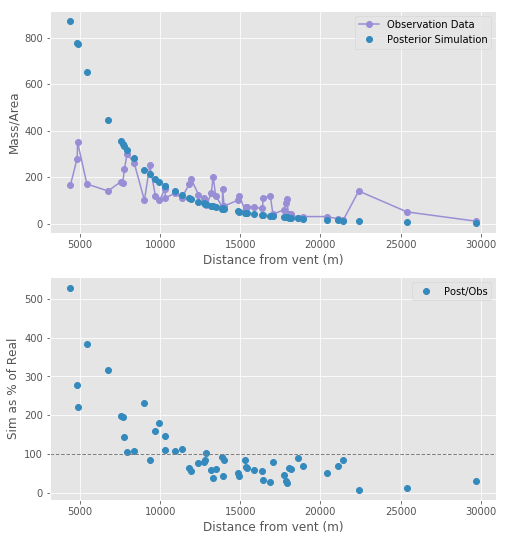

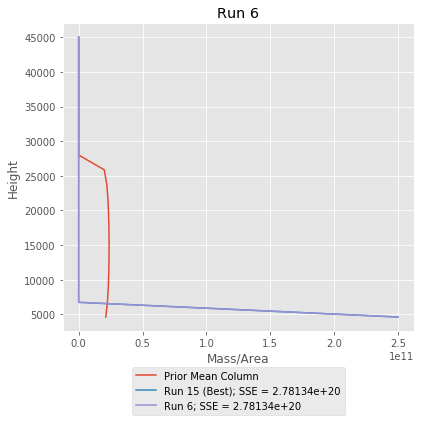

,D,M,a,b,ftt,h1,u,v
0,"9,033.22",2.5e+11,2,2,"3,600","4,625",-0.00152181,-0.000947646


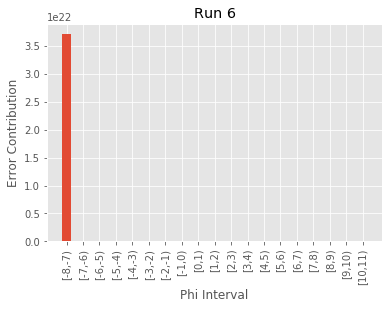

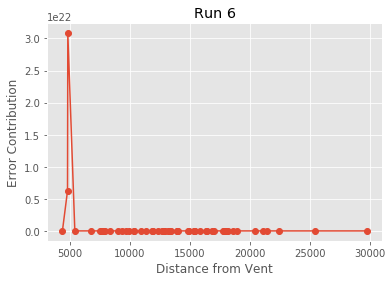

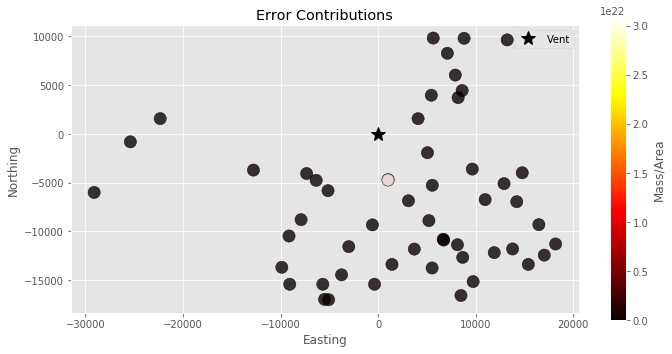

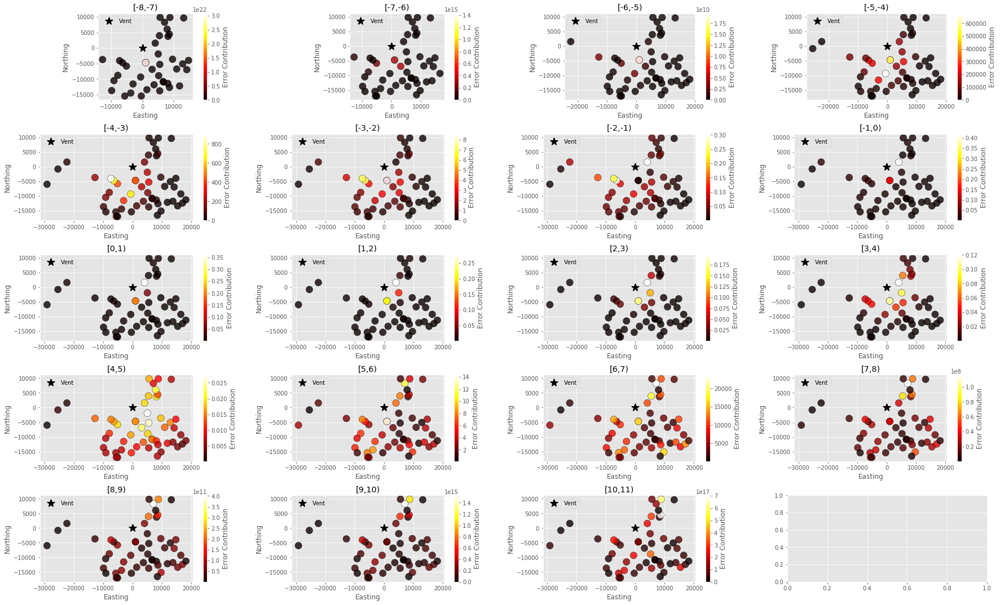

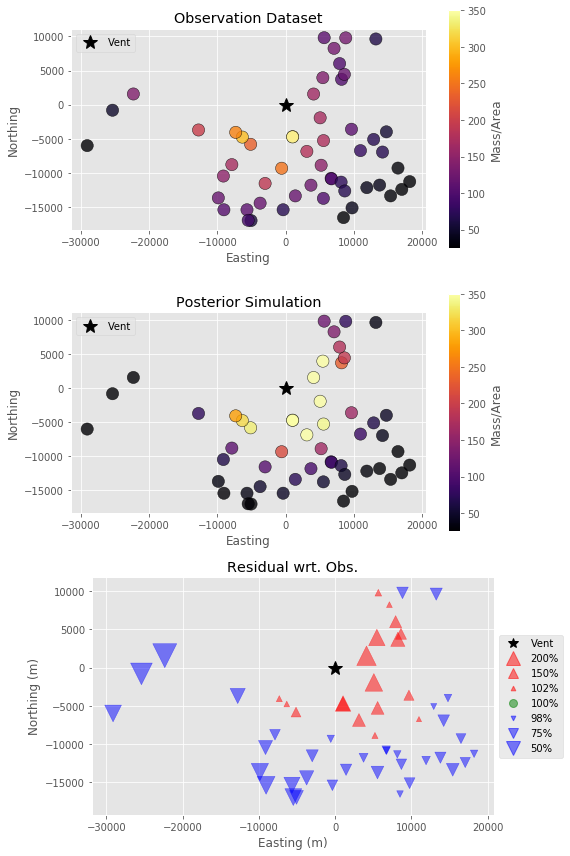

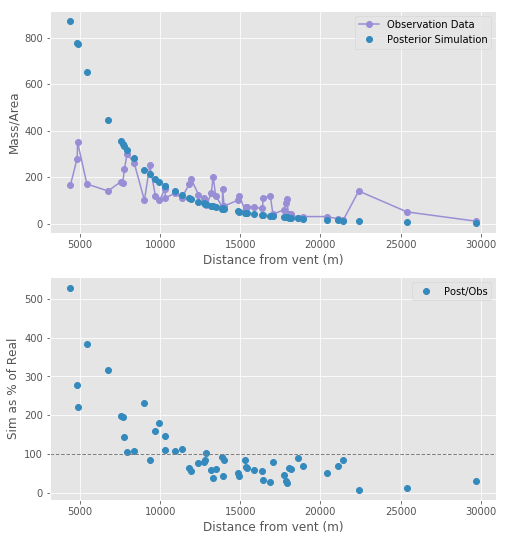

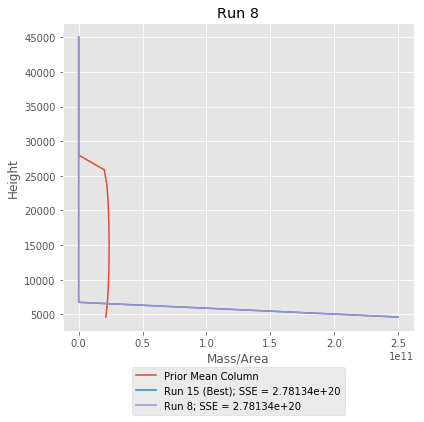

,D,M,a,b,ftt,h1,u,v
0,9.51898e+09,2.5e+11,2,2,"3,600","4,625",2.11352e-05,-0.000237075


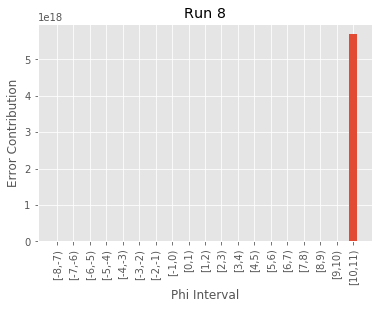

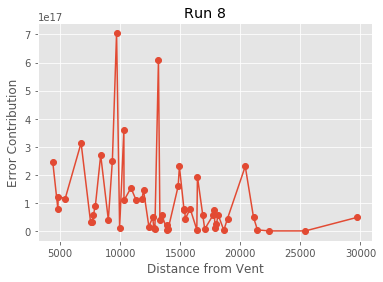

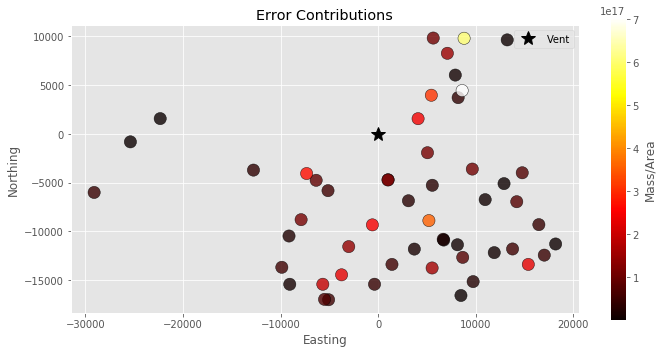

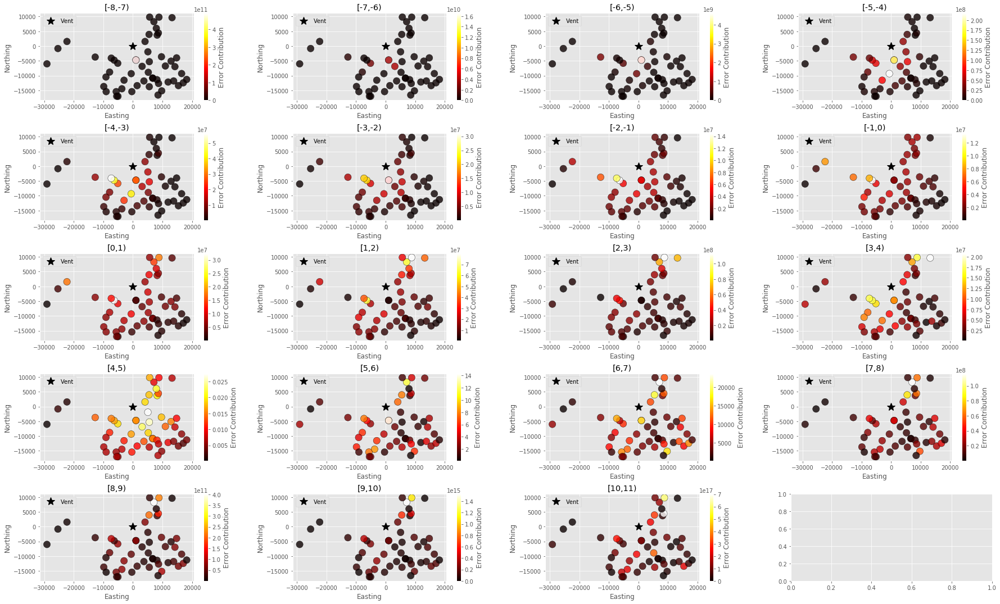

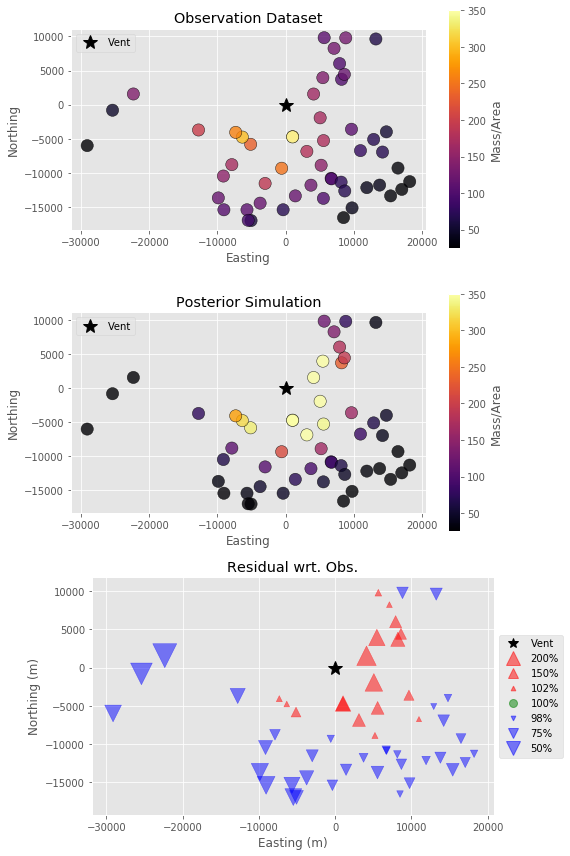

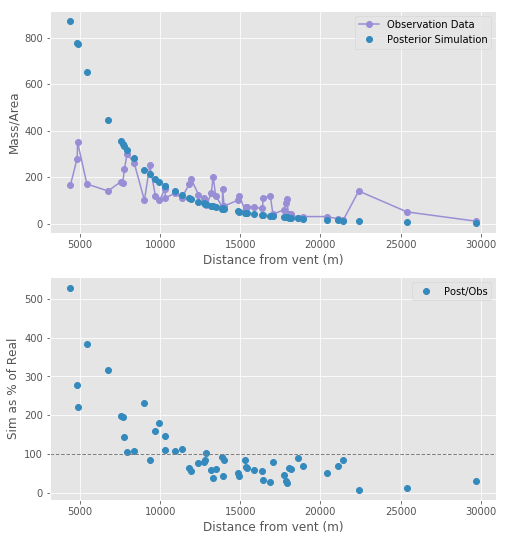

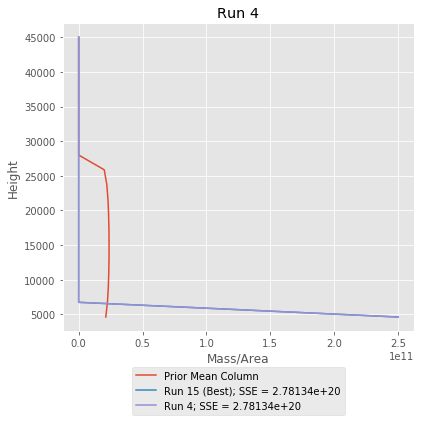

,D,M,a,b,ftt,h1,u,v
0,1.47377e+10,2.5e+11,2,2,"3,600","4,625",0.00015403,-0.000352736


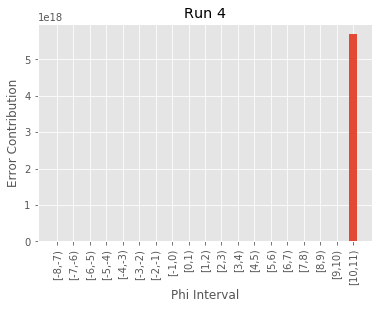

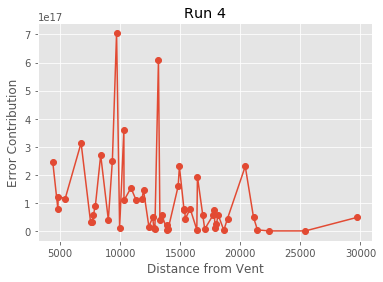

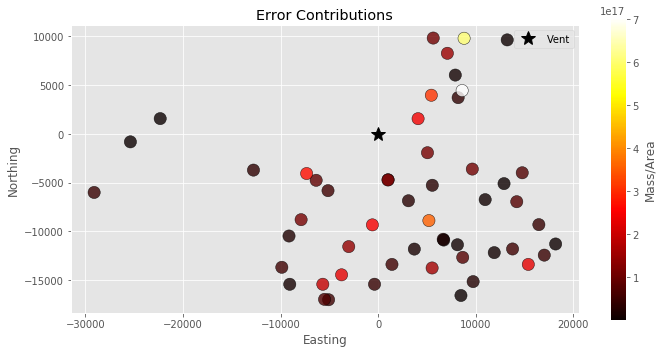

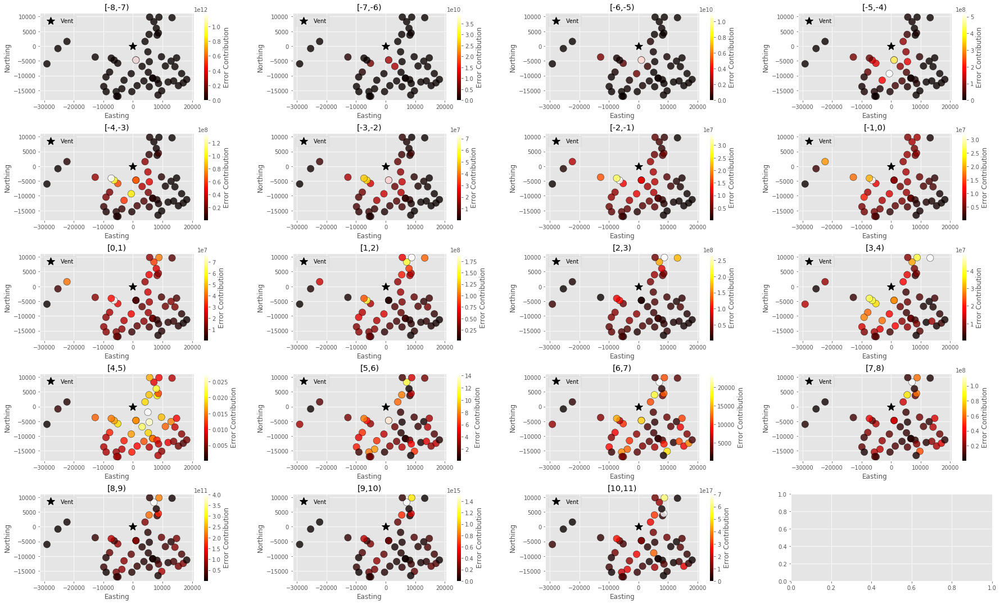

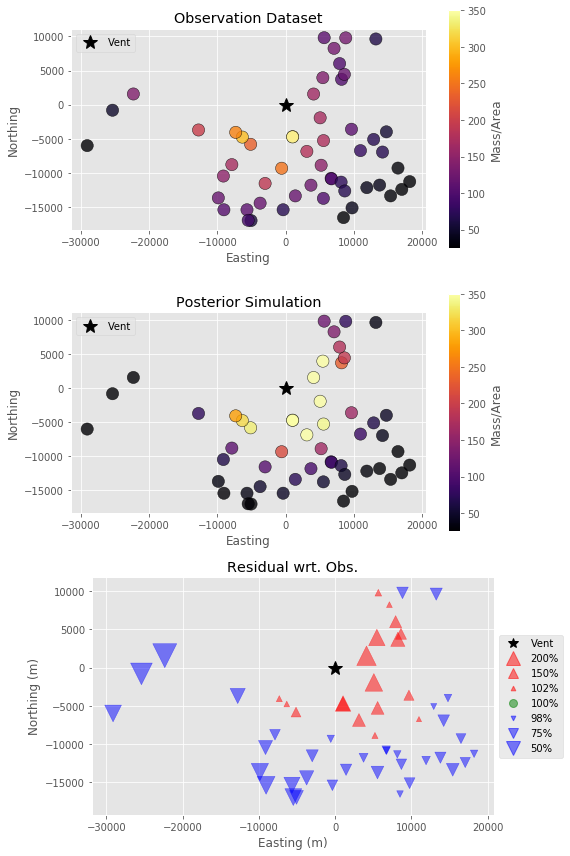

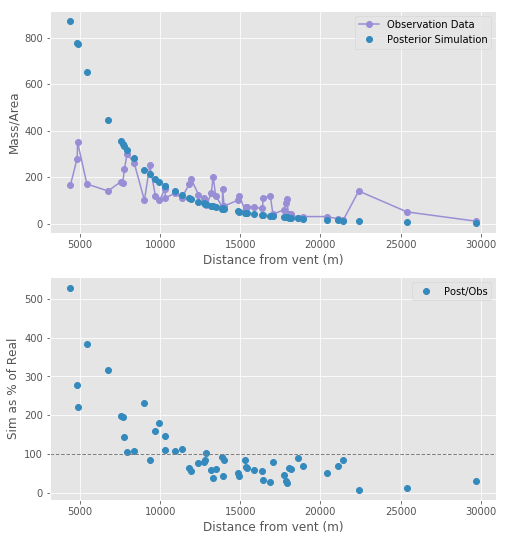

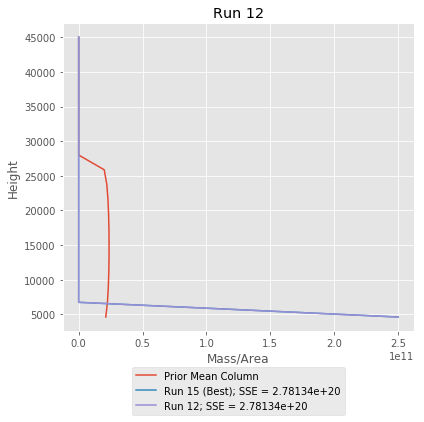

,D,M,a,b,ftt,h1,u,v
0,"8,025.39",2.5e+11,2,2,"3,600","6,750",-0.0161455,-0.000197292


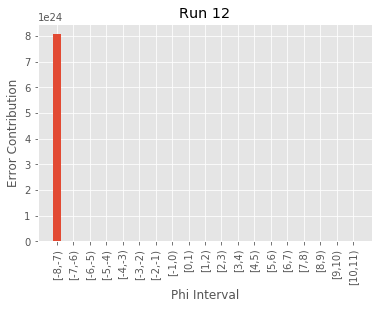

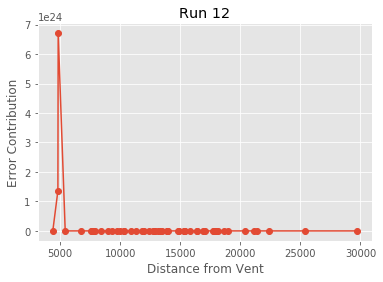

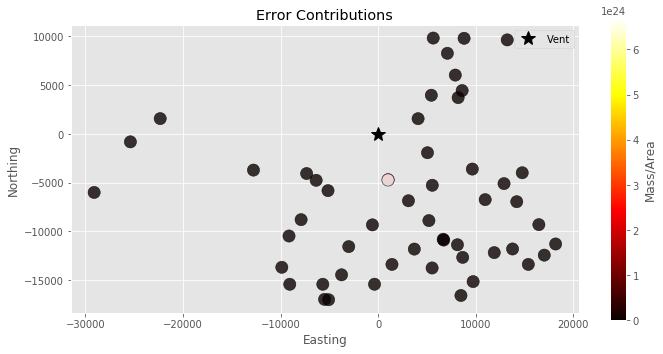

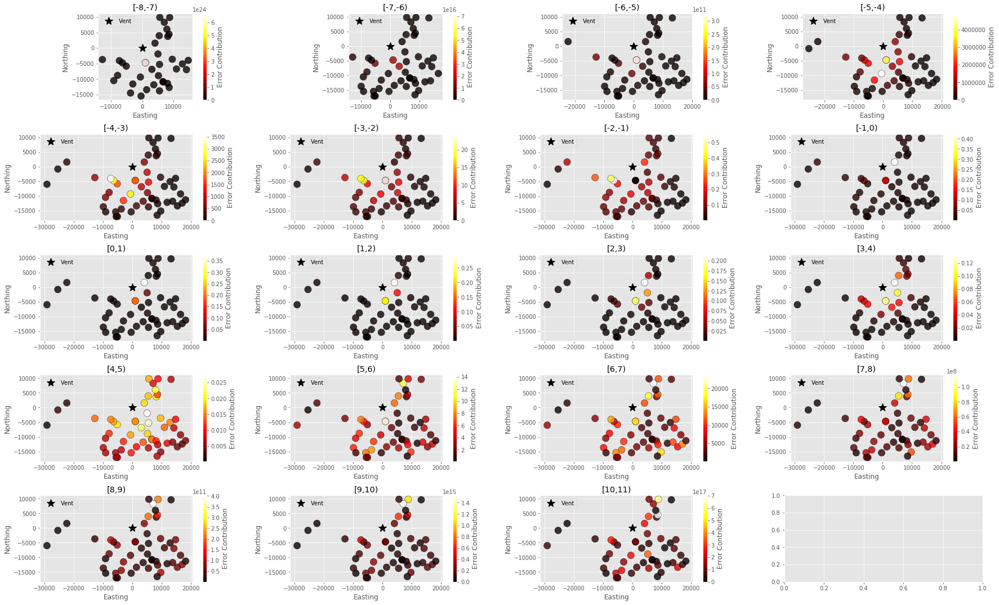

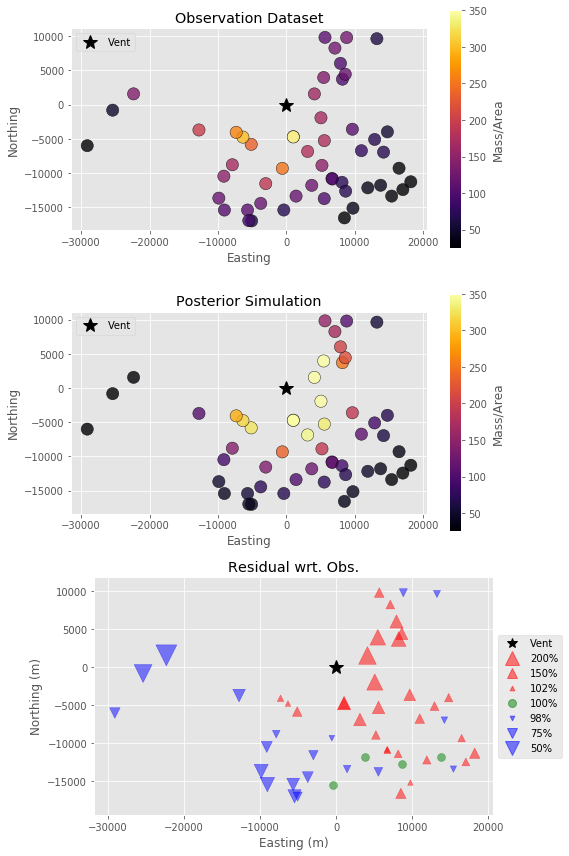

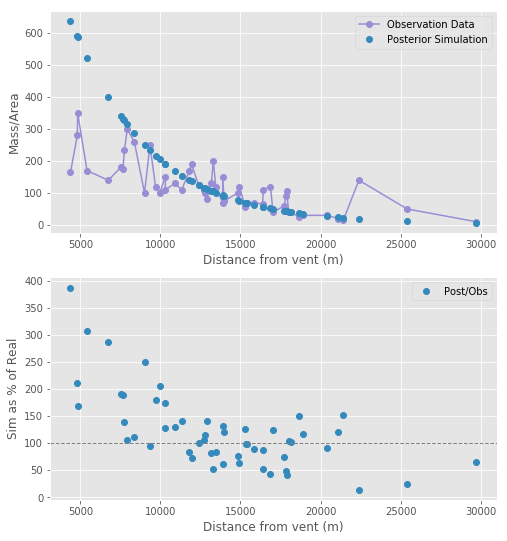

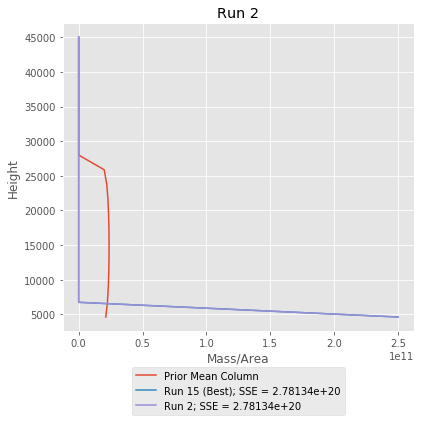

,D,M,a,b,ftt,h1,u,v
0,1.23378e+11,2.5e+11,2,2,"3,600","4,625",-0.00842903,0.000174049


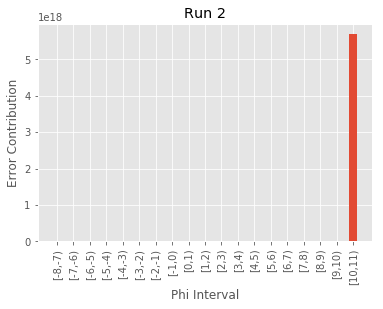

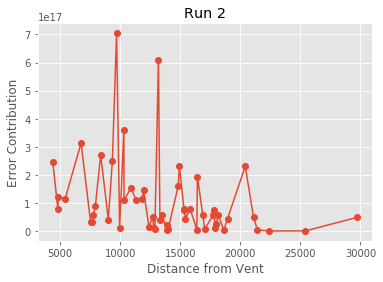

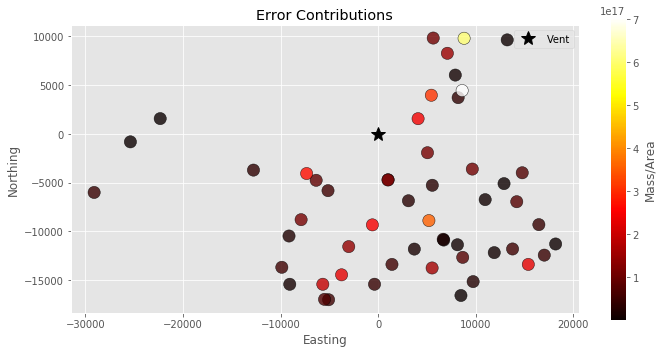

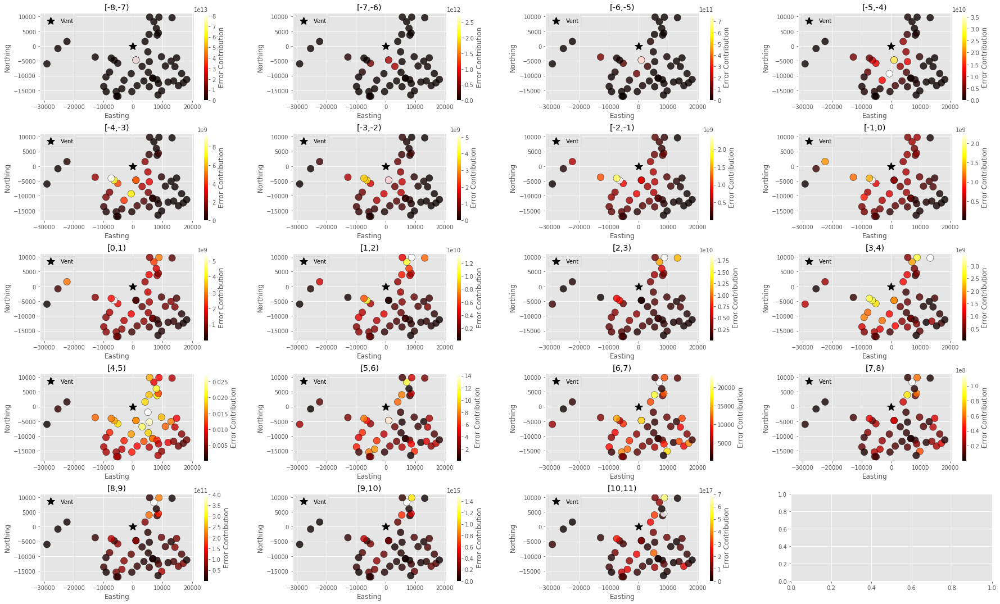

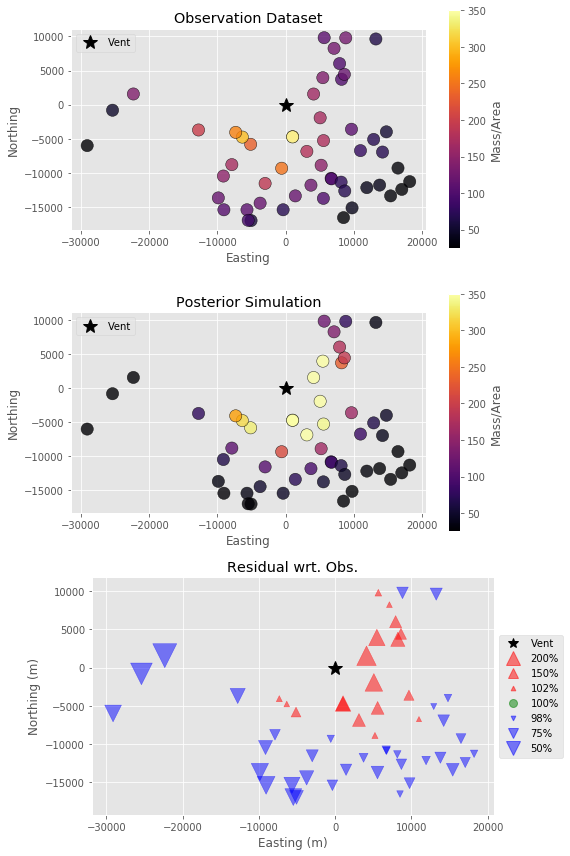

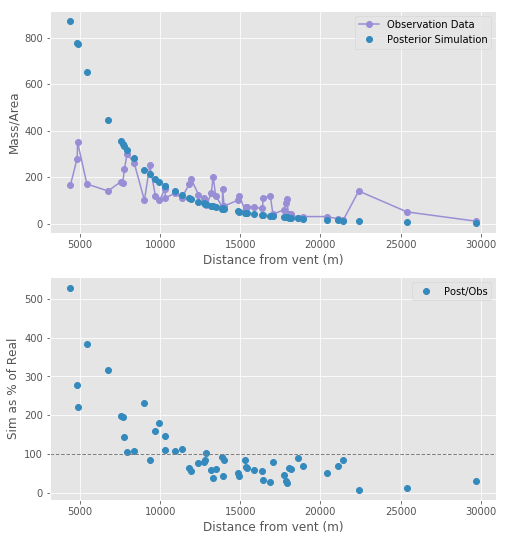

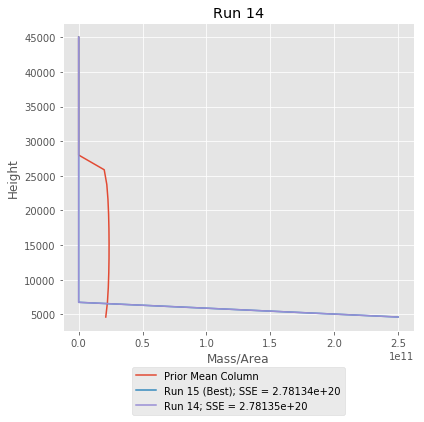

,D,M,a,b,ftt,h1,u,v
0,9.95491e+10,2.5e+11,2,2,"3,600","4,625",-0.0034174,0.0591648


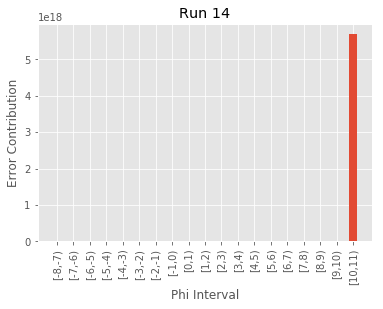

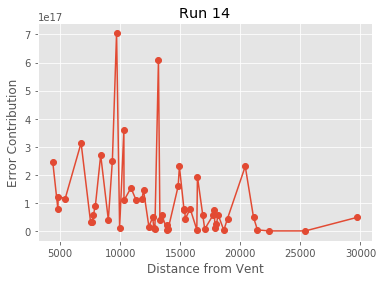

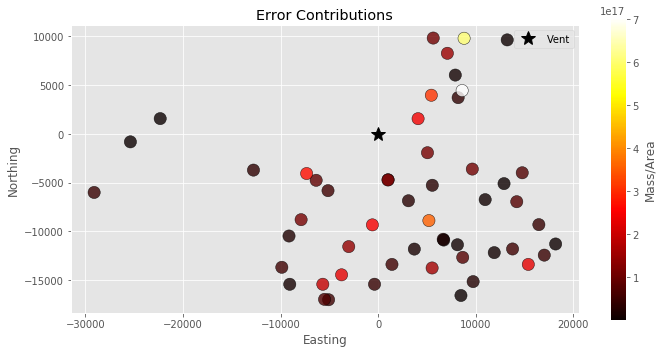

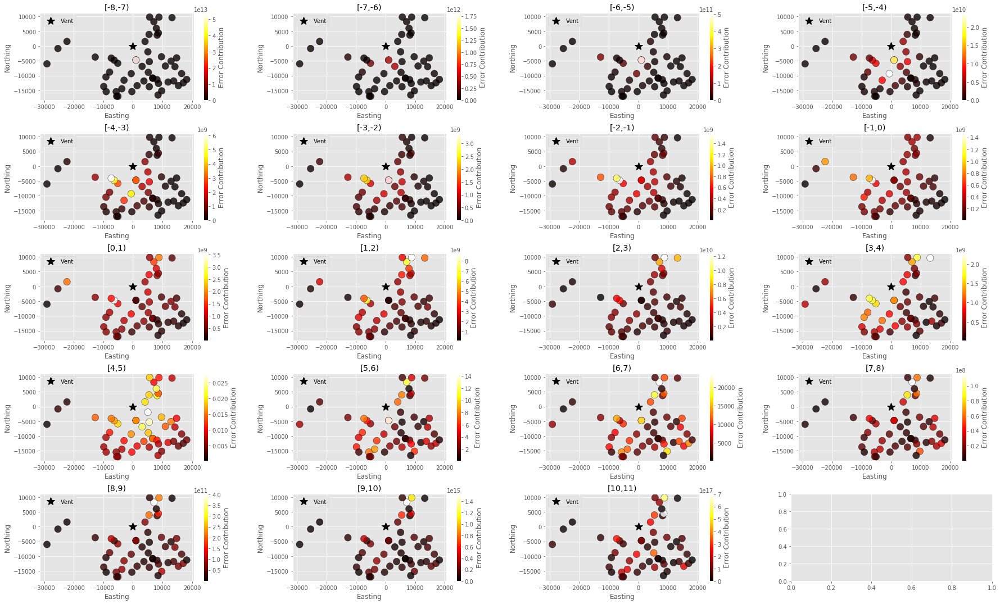

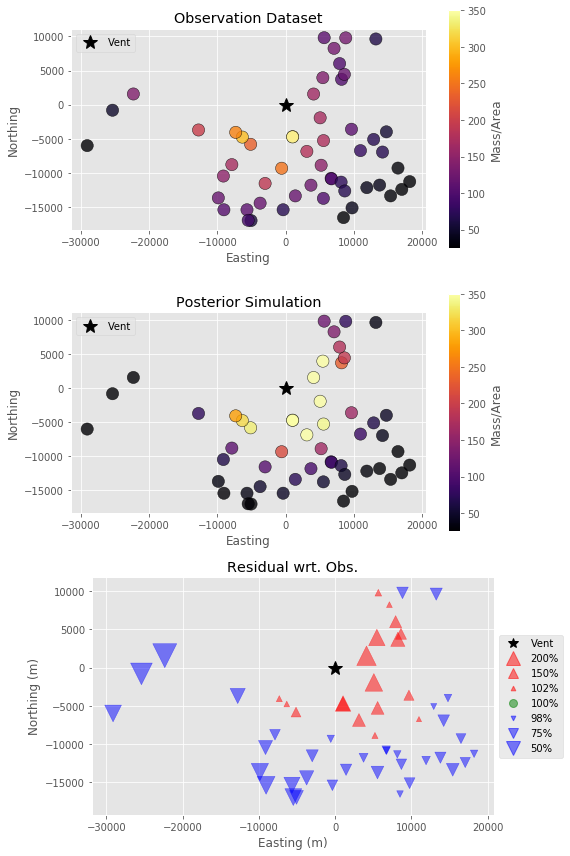

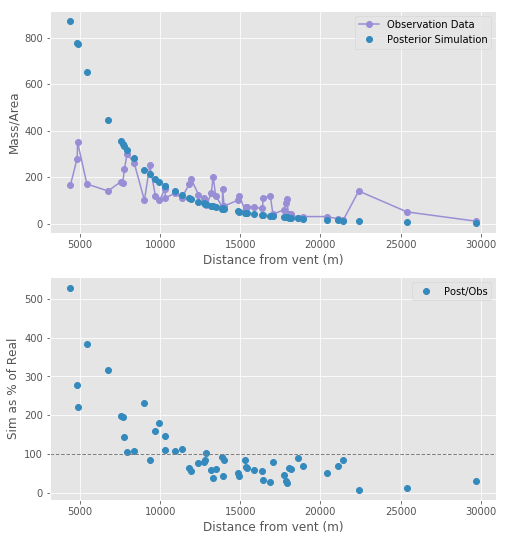

In [42]:
best = np.argsort(sse_list)
q_mass = mass_dist_in_plume(config["ALPHA"],config["BETA"], config["VENT_ELEVATION"], 
        config["PLUME_HEIGHT"],
        heights,
        config["ERUPTION_MASS"])
fig, ax1 = plt.subplots(1,1, figsize=(6, 6), facecolor='w', edgecolor='k')
ax1.plot(inverted_masses_list[best[0]],
             heights, 
             '-', label="Run %d (Best); SSE = %g"%(best[0], sse_list[best[0]]))

ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1))
ax1.plot(q_mass, heights, label="Prior Mean Column")
ax1.set_title("Best fit")
ax1.set_ylabel("Height")
ax1.set_xlabel("Mass/Area")
plt.tight_layout()
plt.show()

fig, ax1 = plt.subplots(1,1, figsize=(6, 10), facecolor='w', edgecolor='k')

ax1.plot(inverted_masses_list[best[0]],
             heights, 
             '-', label="Run %d (Best); SSE = %g"%(best[0], sse_list[best[0]]))
for i in best[1:]:
    label = "Run %d; SSE = %g"%(i, sse_list[i])
    ax1.plot(inverted_masses_list[i],
             heights, 
             '-', label=label)
ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1))
ax1.set_title("All fits")
ax1.set_ylabel("Height")
ax1.set_xlabel("Mass/Area")
plt.tight_layout()
plt.show()


for i in best:
    fig, ax1 = plt.subplots(1,1, figsize=(6, 6), facecolor='w', edgecolor='k')
    ax1.plot(q_mass, heights, label="Prior Mean Column")
    ax1.plot(inverted_masses_list[best[0]],
             heights, 
             '-', label="Run %d (Best); SSE = %g"%(best[0], sse_list[best[0]]))
    label = "Run %d; SSE = %g"%(i, sse_list[i])
    ax1.plot(inverted_masses_list[i],
             heights, 
             '-', label=label)
    ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1))
    ax1.set_title("Run %d"%i)
    ax1.set_ylabel("Height")
    ax1.set_xlabel("Mass/Area")
    plt.tight_layout()
    plt.show()
    display(pd.DataFrame([params_list[i]]))
    sse, contributions = get_error_contributions(
        data, len(data), 20, 
        config["VENT_ELEVATION"], H, 2500, phi_steps, 
        params_list[i], column_cap = H, )
    
    
    point_contributions = np.sum(contributions, 0)
    phi_contributions = np.sum(contributions, 1)
    
    x = [phi["centroid"] for phi in phi_steps]
    labels = [phi["interval"] for phi in phi_steps]
    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.bar(x, phi_contributions, width=0.5, align="center")
    ax.set_xticks(x)
    ax.set_xticklabels(labels, rotation=90)
    plt.xlabel("Phi Interval")
    plt.ylabel("Error Contribution")
    plt.title("Run %d"%i)
    plt.show()

    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.plot(data["radius"], point_contributions, "C0o-")
    plt.xlabel("Distance from Vent")
    plt.ylabel("Error Contribution")
    plt.title("Run %d"%i)
    plt.show()
    
    data["Contributions"] = point_contributions
    fig, ax = plt.subplots(1, 1, figsize=(10,5), facecolor='w', edgecolor='k')

    vis.plot_sample(data, vent=(0,0), log=False, values="Contributions",
                title="Error Contributions", cbar_label="Mass/Area", ax = ax, cmap="hot")
    plt.tight_layout()
    plt.show()
#      bounds=(min(min(contributions)),max(max(contributions))),
    fig, axs = plt.subplots(5,4, figsize=(25,15), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    for j, phi_cont in enumerate(phi_contributions):
        data["Contributions"] = contributions[j]
        vis.plot_sample(data, vent=(0,0), log=False, values="Contributions",
                title=phi_steps[j]["interval"], cbar_label="Error Contribution", ax = axs[j], cmap="hot")
    plt.tight_layout()
    plt.show()

    q_dist = beta(params_list[i]["a"],params_list[i]["b"])

    grid = obs_df[["Easting", "Northing"]]

    post_df = gaussian_stack_forward(
        grid, int(config["COL_STEPS"]), config["VENT_ELEVATION"], 
        params_list[i]["h1"], 2500, phi_steps, (params_list[i]["a"],params_list[i]["b"]), config["ERUPTION_MASS"], 
        (u,v), config["DIFFUSION_COEFFICIENT"], config["EDDY_CONST"],
        config["FALL_TIME_THRESHOLD"]
    )
    
    post_df["radius"] = np.sqrt(post_df["Easting"]**2 + post_df["Northing"]**2)
    post_df = post_df.sort_values(by=['radius'])
    post_df["Residual"] = post_df["MassArea"].values/obs_df["MassArea"].values
    
    fig, axs = plt.subplots(3,1, figsize=(
            8, 12), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    bounds = (25, 350)
    vis.plot_sample(obs_df, vent=(0,0), log=False,bounds=bounds, 
                title="Observation Dataset", cbar_label="Mass/Area", ax=axs[0])
    vis.plot_sample(post_df, vent=(0,0), log=False, bounds=bounds,
                title="Posterior Simulation", cbar_label="Mass/Area", ax=axs[1])
    vis.plot_residuals(post_df, vent=(0,0), values="Residual", plot_type="size",
                title="Residual wrt. Obs.", ax=axs[2])

    plt.tight_layout()
    plt.show()

    
    fig, axs = plt.subplots(2,1, figsize=(
            8, 9), facecolor='w', edgecolor='k')
    axs = axs.ravel()

    axs[0].plot(obs_df["radius"].values, obs_df["MassArea"].values, 'C2o-', label="Observation Data")
    axs[0].plot(post_df["radius"].values, post_df["MassArea"].values, 'C1o', label="Posterior Simulation")
    axs[0].legend()
    axs[0].set_xlabel("Distance from vent (m)")
    axs[0].set_ylabel("Mass/Area")


    axs[1].plot(post_df["radius"].values, post_df["Residual"].values*100, 'C1o', label="Post/Obs")
    axs[1].axhline(100, linestyle="--", lw=1, c="gray")
    axs[1].legend()
    axs[1].set_xlabel("Distance from vent (m)")
    axs[1].set_ylabel("Sim as % of Real")
    plt.show()

In [41]:
for i in best:
    display(pd.DataFrame([priors_list[i], params_list[i]], index=["Priors", "Posteriors"]).T)
    
params_df = pd.DataFrame(params_list)
params_df["SSE"] = sse_list
params_df = params_df.sort_values("SSE")
params_df = params_df[["a", "b", "h1", "u", "v", "D", "ftt", "M", "SSE"]]
display(params_df)

,Priors,Posteriors
D,"76,110.3","73,148.5"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"8,523.74","4,625"
u,-5.87438,9.37771e-05
v,-9.80712,-0.000247656


,Priors,Posteriors
D,"87,839.6","75,299.4"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"26,643","4,625"
u,-2.4975,9.34605e-05
v,-2.31452,-0.000247256


,Priors,Posteriors
D,"16,383.8",1.46475e+06
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"22,071.8","4,625"
u,-5.60192,9.39549e-05
v,-5.09931,-0.000247196


,Priors,Posteriors
D,"40,189.2","906,262"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"16,345","4,625"
u,9.72445,9.45087e-05
v,-2.8959,-0.000246848


,Priors,Posteriors
D,"88,136.9",6.36017e+06
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"5,615.7","4,625"
u,8.45621,9.20481e-05
v,6.35912,-0.000246833


,Priors,Posteriors
D,"54,521.1","24,152.2"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"13,530.3","4,625"
u,4.96298,9.35212e-05
v,-0.00472605,-0.0002471


,Priors,Posteriors
D,"51,958.8",1.14841e+07
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"23,915.4","4,625"
u,9.21705,9.36668e-05
v,5.54823,-0.000247491


,Priors,Posteriors
D,"21,377.5",4.23315e+07
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"25,323.4","4,625"
u,-6.80155,9.39363e-05
v,-2.18213,-0.000247061


,Priors,Posteriors
D,"12,313.6",7.41461e+07
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"20,710.8","4,625"
u,0.151393,9.37269e-05
v,8.95085,-0.000247821


,Priors,Posteriors
D,"42,479.9",7.41735e+08
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"11,164","4,625"
u,-8.07247,0.000106475
v,-7.60188,-0.000258804


,Priors,Posteriors
D,"4,138.23",9.10957e+08
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"16,935.8","4,625"
u,-3.56868,9.79403e-05
v,-9.62956,-0.000250231


,Priors,Posteriors
D,"91,307.3",9.14256e+08
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"14,975.1","4,625"
u,-6.88993,9.04987e-05
v,-3.68409,-0.000248883


,Priors,Posteriors
D,"5,321.06",1.31261e+09
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"13,449","4,625"
u,1.56784,0.000118212
v,-0.600922,-0.000221196


,Priors,Posteriors
D,"44,220.5",1.60329e+09
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"22,433.1","4,625"
u,-7.24196,9.35897e-05
v,-9.84392,-0.000245798


,Priors,Posteriors
D,"95,084.9","9,033.22"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"22,746.4","4,625"
u,-2.27183,-0.00152181
v,-0.960333,-0.000947646


,Priors,Posteriors
D,"55,730.5",9.51898e+09
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"25,949.4","4,625"
u,-4.028,2.11352e-05
v,2.07022,-0.000237075


,Priors,Posteriors
D,"13,265.8",1.47377e+10
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"25,444.8","4,625"
u,-5.80706,0.00015403
v,-2.07718,-0.000352736


,Priors,Posteriors
D,"94,671.2","8,025.39"
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"9,616.38","6,750"
u,8.18646,-0.0161455
v,-3.96183,-0.000197292


,Priors,Posteriors
D,"99,434.1",1.23378e+11
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"11,326","4,625"
u,4.20048,-0.00842903
v,-4.88472,0.000174049


,Priors,Posteriors
D,"49,031.4",9.95491e+10
M,2.5e+11,2.5e+11
a,2,2
b,2,2
ftt,"3,600","3,600"
h1,"24,388.7","4,625"
u,-8.87628,-0.0034174
v,0.149158,0.0591648


,a,b,h1,u,v,D,ftt,M,SSE
15,2,2,"4,625",9.37771e-05,-0.000247656,"73,148.5","3,600",2.5e+11,2.78134e+20
13,2,2,"4,625",9.34605e-05,-0.000247256,"75,299.4","3,600",2.5e+11,2.78134e+20
0,2,2,"4,625",9.39549e-05,-0.000247196,1.46475e+06,"3,600",2.5e+11,2.78134e+20
1,2,2,"4,625",9.45087e-05,-0.000246848,"906,262","3,600",2.5e+11,2.78134e+20
16,2,2,"4,625",9.20481e-05,-0.000246833,6.36017e+06,"3,600",2.5e+11,2.78134e+20
19,2,2,"4,625",9.35212e-05,-0.0002471,"24,152.2","3,600",2.5e+11,2.78134e+20
11,2,2,"4,625",9.36668e-05,-0.000247491,1.14841e+07,"3,600",2.5e+11,2.78134e+20
10,2,2,"4,625",9.39363e-05,-0.000247061,4.23315e+07,"3,600",2.5e+11,2.78134e+20
18,2,2,"4,625",9.37269e-05,-0.000247821,7.41461e+07,"3,600",2.5e+11,2.78134e+20
9,2,2,"4,625",0.000106475,-0.000258804,7.41735e+08,"3,600",2.5e+11,2.78134e+20
